In [1]:
import sys
sys.path.append('/Users/yuch8913/miniforge3/envs/er3t_env/lib/python3.8/site-packages')
import pandas as pd
import h5py
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib
from glob import glob
import numpy as np
from sys import exit as ext
import copy
from bisect import bisect_left
from oco_post_class_ywc import *
from matplotlib import cm
from scipy.interpolate import interpn
from scipy import stats
import geopy.distance
import xarray as xr
import seaborn as sns
from tool_code import *
%matplotlib inline

#"""

from matplotlib import font_manager

font_path = '/System/Library/Fonts/Supplemental/Arial.ttf'  # Your font path goes here
font_manager.fontManager.addfont(font_path)
prop = font_manager.FontProperties(fname=font_path)

plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = prop.get_name()
#"""

import warnings
warnings.filterwarnings("ignore")

In [2]:
png       = ['../simulation/data/20170605_amazon_470cloud_20170605/aqua_rgb_2017-06-05_-67.35--66.09--0.15-1.25.png',
             [-67.35, -66.09, -0.15, 1.25]]
img = png[0]
wesn= png[1]

In [3]:
def grab_cfg(path):
    """
    Read the setting information in the assigned csv file.
    path: relative or absolute path to the setting csv file.
    """
    cfg_file = pd.read_csv(path, header=None, index_col=0)
    result = {'cfg_name':path.split('/')[-1].replace('.csv', '')}
    for ind in cfg_file.index.dropna():
        contents = [str(i) for i in cfg_file.loc[ind].dropna() if str(i)[0] != '#']
        if len(contents) == 1:
            result[ind] = contents[0]
        elif len(contents) > 1:
            result[ind] = contents
    return result

def output_h5_info(cfg, index):
    """
    Check whether the output h5 name is saved in cfg file
    """
    try: 
        cfg_file = grab_cfg(cfg)
    except OSError as err:
        print('{} not exists!'.format(cfg))
        return False
    if index in cfg_file.keys():
        if cfg_file[index][-2:] == 'h5':
            return cfg_file[index]
    else:
        return False
    
def get_slope_1km(OCO_class,fp,z,mode='unperturb'):
    nwl=OCO_class.sls_1km[z,fp,:].shape[0]
    flt=np.where(OCO_class.sls_1km[z,fp,:]>1e-6)
    #flt=np.where(~np.isnan(sls[:]))
    use=len(flt[0])
    if use==nwl:
        w=1./OCO_class.sls_1km[z,fp,:]    
        if mode=='unperturb':
            x=OCO_class.rad_1km_c3d[z,fp,:]/OCO_class.toa[:]*np.pi
        else:
            x=OCO_class.rad_1km_clr[z,fp,:]/OCO_class.toa[:]*np.pi
        mask = np.argsort(x)[5:]
        res=np.polyfit(x[mask],OCO_class.sl_1km[z,fp,:][mask],1,w=w[mask],cov=True) # now get covariance as well!
        slope,intercept=res[0]
        slopestd=np.sqrt(res[1][0][0])
        interceptstd=np.sqrt(res[1][1][1])
    else:
        slope=np.nan; slopestd=np.nan; intercept=np.nan; interceptstd=np.nan
    return(slope,slopestd,intercept,interceptstd)

def get_slope_1km_all(OCO_class,fp,z,mode='unperturb'):
    nwl=OCO_class.sls_1km_all[z,fp,:].shape[0]
    flt=np.where(OCO_class.sls_1km_all[z,fp,:]>1e-6)
    #flt=np.where(~np.isnan(sls[:]))
    use=len(flt[0])
    if use==nwl:
        w=1./OCO_class.sls_1km_all[z,fp,:]    
        if mode=='unperturb':
            x=OCO_class.rad_1km_c3d_all[z,fp,:]/OCO_class.toa[:]*np.pi
        else:
            x=OCO_class.rad_1km_clr_all[z,fp,:]/OCO_class.toa[:]*np.pi
        mask = np.argsort(x)[5:]
        res=np.polyfit(x[mask],OCO_class.sl_1km_all[z,fp,:][mask],1,w=w[mask],cov=True) # now get covariance as well!
        slope,intercept=res[0]
        slopestd=np.sqrt(res[1][0][0])
        interceptstd=np.sqrt(res[1][1][1])
    else:
        slope=np.nan; slopestd=np.nan; intercept=np.nan; interceptstd=np.nan
    return(slope,slopestd,intercept,interceptstd)

def get_slope_25p(OCO_class,fp,z,mode='unperturb'):
    nwl=OCO_class.sls_25p[z,fp,:].shape[0]
    flt=np.where(OCO_class.sls_25p[z,fp,:]>1e-6)
    #flt=np.where(~np.isnan(sls[:]))
    use=len(flt[0])
    if use==nwl:
        w=1./OCO_class.sls_25p[z,fp,:]
        if mode=='unperturb':
            x=OCO_class.rad_25p_c3d[z,fp,:]/OCO_class.toa[:]*np.pi
        else:
            x=OCO_class.rad_25p_clr[z,fp,:]/OCO_class.toa[:]*np.pi   
        mask = np.argsort(x)[5:]
        res=np.polyfit(x[mask],OCO_class.sl_25p[z,fp,:][mask],1,w=w[mask],cov=True) # now get covariance as well!
        slope,intercept=res[0]
        slopestd=np.sqrt(res[1][0][0])
        interceptstd=np.sqrt(res[1][1][1])
    else:
        slope=np.nan; slopestd=np.nan; intercept=np.nan; interceptstd=np.nan
    return(slope,slopestd,intercept,interceptstd)

def slopes_propagation(OCO_class,mode='unperturb'): # goes through entire line for a given footprint fp
    OCO_class.slope_1km=np.zeros([OCO_class.nz,OCO_class.nf,2])
    OCO_class.inter_1km=np.zeros([OCO_class.nz,OCO_class.nf,2])
    OCO_class.slope_25p=np.zeros([OCO_class.nz,OCO_class.nf,2])
    OCO_class.inter_25p=np.zeros([OCO_class.nz,OCO_class.nf,2])
    OCO_class.slope_1km_all=np.zeros([OCO_class.rad_1km_clr_all.shape[0],OCO_class.rad_1km_clr_all.shape[1], 2])
    OCO_class.inter_1km_all=np.zeros([OCO_class.rad_1km_clr_all.shape[0],OCO_class.rad_1km_clr_all.shape[1], 2])
    for z in range(OCO_class.nz):
        for fp in range(OCO_class.nf):
            if 1:#~ np.isnan(OCO_class.co2[z,fp,]):
                slope,slopestd,inter,interstd=OCO_class.get_slope(fp,z,mode='unperturb')
                OCO_class.slope[z,fp,:]=[slope,slopestd]
                OCO_class.inter[z,fp,:]=[inter,interstd]
                slope,slopestd,inter,interstd=get_slope_1km(OCO_class, fp,z,mode='unperturb')
                OCO_class.slope_1km[z,fp,:]=[slope,slopestd]
                OCO_class.inter_1km[z,fp,:]=[inter,interstd]  
                slope,slopestd,inter,interstd=get_slope_25p(OCO_class, fp,z,mode='unperturb')
                OCO_class.slope_25p[z,fp,:]=[slope,slopestd]
                OCO_class.inter_25p[z,fp,:]=[inter,interstd]  
    for z in range(OCO_class.rad_1km_clr_all.shape[0]):
        for fp in range(OCO_class.rad_1km_clr_all.shape[1]):   
            slope,slopestd,inter,interstd=get_slope_1km_all(OCO_class, fp,z,mode='unperturb')
            OCO_class.slope_1km_all[z,fp,:]=[slope,slopestd]
            OCO_class.inter_1km_all[z,fp,:]=[inter,interstd]

In [4]:
def plot_perturbation_1km(OCOSIM,z,fp,frame=None):
        if frame is None:
            f,frame=plt.subplots()
        frame.plot(OCOSIM.rad_1km_c3d[z,fp,:]/OCOSIM.toa*np.pi,OCOSIM.sl_1km[z,fp,:]*100,'ko')    
        for l,wl in enumerate(OCOSIM.lam):
            frame.plot([OCOSIM.rad_1km_c3d[z,fp,l]/OCOSIM.toa[l]*np.pi,OCOSIM.rad_1km_c3d[z,fp,l]/OCOSIM.toa[l]*np.pi],
                     np.array([OCOSIM.sl_1km[z,fp,l]-OCOSIM.sls_1km[z,fp,l],OCOSIM.sl_1km[z,fp,l]+OCOSIM.sls_1km[z,fp,l]])*100,'k:')        
        slope,slopes         = OCOSIM.slope_1km[z,fp,:]
        intercept,intercepts = OCOSIM.inter_1km[z,fp,:]
        mn = np.min(OCOSIM.rad_1km_c3d[z,fp,:]/OCOSIM.toa[:]*np.pi)
        mx = np.max(OCOSIM.rad_1km_c3d[z,fp,:]/OCOSIM.toa[:]*np.pi)
        xx=np.linspace(mn,mx,10)
        yy=intercept+slope*xx
        y1=intercept+intercepts+(slope+slopes)*xx
        y2=intercept-intercepts+(slope-slopes)*xx
        frame.plot(xx,yy*100,'r-',linewidth=2)  
        frame.plot(xx,y1*100,'r:',linewidth=1)  
        frame.plot(xx,y2*100,'r:',linewidth=1)  
        frame.plot([0,mx],[0,0],'k--')
        # ywc added
        frame.set_title(f'slope: {slope:.3f}\nintercept: {intercept*100:.1f}')
        frame.set_ylim(-30, 30)

In [5]:
def near_rad_calc(OCO_class):
    rad_mca_ipa0 = np.zeros((OCO_class.lat.shape[0], OCO_class.lat.shape[1], OCO_class.lam.size), dtype=np.float64)
    rad_mca_ipa  = np.zeros((OCO_class.lat.shape[0], OCO_class.lat.shape[1], OCO_class.lam.size), dtype=np.float64)
    rad_mca_3d   = np.zeros((OCO_class.lat.shape[0], OCO_class.lat.shape[1], OCO_class.lam.size), dtype=np.float64)

    rad_mca_ipa0_std = np.zeros((OCO_class.lat.shape[0], OCO_class.lat.shape[1], OCO_class.lam.size), dtype=np.float64)
    rad_mca_ipa_std  = np.zeros((OCO_class.lat.shape[0], OCO_class.lat.shape[1], OCO_class.lam.size), dtype=np.float64)
    rad_mca_3d_std   = np.zeros((OCO_class.lat.shape[0], OCO_class.lat.shape[1], OCO_class.lam.size), dtype=np.float64)

    rad_mca_ipa0[...] = np.nan
    rad_mca_ipa[...] = np.nan
    rad_mca_3d[...] = np.nan

    rad_mca_ipa0_std[...] = np.nan
    rad_mca_ipa_std[...] = np.nan
    rad_mca_3d_std[...] = np.nan

    rad_mca_ipa0_25 = rad_mca_ipa0.copy()
    rad_mca_ipa_25 = rad_mca_ipa0.copy()
    rad_mca_3d_25 = rad_mca_ipa0.copy()

    rad_mca_ipa0_std_25 = rad_mca_ipa0.copy()
    rad_mca_ipa_std_25 = rad_mca_ipa0.copy()
    rad_mca_3d_std_25 = rad_mca_ipa0.copy()
    count = 0
    for i in range(OCO_class.lat.shape[0]):
        for j in range(OCO_class.lat.shape[1]):
            if 1:#~ np.isnan(OCO_class.co2[i, j]):
                lon0 = OCO_class.lon[i, j]
                lat0 = OCO_class.lat[i, j]      
                index_lon = np.argmin(np.abs(OCO_class.lon2d[:, 0]-lon0))
                index_lat = np.argmin(np.abs(OCO_class.lat2d[0, :]-lat0))

                center = (lat0, lon0)
                tmp_clr, tmp_c1d, tmp_c3d = [], [], []
                tmp_clrs, tmp_c1ds, tmp_c3ds = [], [], []
                test_range = (np.arange(-10, 10+1))
                for x in test_range:
                    for y in test_range:
                        try:
                            interest_loc = (OCO_class.lat2d[0, index_lat+y], OCO_class.lon2d[index_lon+x, 0])
                            if geopy.distance.distance(center, interest_loc).km <= 1.0:

                                tmp_clr.append(OCO_class.rad_clr[index_lon+x, index_lat+y])
                                tmp_c1d.append(OCO_class.rad_c1d[index_lon+x, index_lat+y])
                                tmp_c3d.append(OCO_class.rad_c3d[index_lon+x, index_lat+y])
                                tmp_clrs.append(OCO_class.rad_clrs[index_lon+x, index_lat+y])
                                tmp_c1ds.append(OCO_class.rad_c1ds[index_lon+x, index_lat+y])
                                tmp_c3ds.append(OCO_class.rad_c3ds[index_lon+x, index_lat+y])
                                count += 1
                        except:
                            None
                
                rad_mca_ipa0[i, j, :] = np.nanmean(np.array(tmp_clr), axis=0)
                rad_mca_ipa[i, j, :]  = np.nanmean(np.array(tmp_c1d), axis=0)
                rad_mca_3d[i, j, :]   = np.nanmean(np.array(tmp_c3d), axis=0)

                rad_mca_ipa0_std[i, j, :] = (np.nanstd(np.array(tmp_clr), axis=0))
                rad_mca_ipa_std[i, j, :]  = (np.nanstd(np.array(tmp_c1d), axis=0))
                rad_mca_3d_std[i, j, :]   = (np.nanstd(np.array(tmp_c3d), axis=0))


                rad_mca_ipa0_25[i, j, :] = np.nanmean(OCO_class.rad_clr[index_lon-2:index_lon+3, 
                                                                 index_lat-2:index_lat+3], 
                                                      axis=(0, 1))
                rad_mca_ipa_25[i, j, :]  = np.nanmean(OCO_class.rad_c1d[index_lon-2:index_lon+3, 
                                                                 index_lat-2:index_lat+3], 
                                                      axis=(0, 1))
                rad_mca_3d_25[i, j, :]   = np.nanmean(OCO_class.rad_c3d[index_lon-2:index_lon+3, 
                                                                 index_lat-2:index_lat+3], 
                                                      axis=(0, 1))
                
                rad_mca_ipa0_std_25[i, j, :] = (np.nanstd(OCO_class.rad_clr[index_lon-2:index_lon+3,
                                                                      index_lat-2:index_lat+3],
                                                          axis=(0, 1)))
                rad_mca_ipa_std_25[i, j, :]  = (np.nanstd(OCO_class.rad_c1d[index_lon-2:index_lon+3,
                                                                      index_lat-2:index_lat+3],
                                                          axis=(0, 1)))
                rad_mca_3d_std_25[i, j, :]   = (np.nanstd(OCO_class.rad_c3d[index_lon-2:index_lon+3,
                                                                      index_lat-2:index_lat+3],
                                                          axis=(0, 1)))
    print(count)
    OCO_class.rad_1km_clr = rad_mca_ipa0
    OCO_class.rad_1km_c1d = rad_mca_ipa
    OCO_class.rad_1km_c3d = rad_mca_3d

    OCO_class.rad_1km_clrs = rad_mca_ipa0_std
    OCO_class.rad_1km_c1ds = rad_mca_ipa_std
    OCO_class.rad_1km_c3ds = rad_mca_3d_std

    OCO_class.rad_25p_clr = rad_mca_ipa0_25
    OCO_class.rad_25p_c1d = rad_mca_ipa_25
    OCO_class.rad_25p_c3d = rad_mca_3d_25

    OCO_class.rad_25p_clrs = rad_mca_ipa0_std_25
    OCO_class.rad_25p_c1ds = rad_mca_ipa_std_25
    OCO_class.rad_25p_c3ds = rad_mca_3d_std_25
    
    OCO_class.sl_1km  = (OCO_class.rad_1km_c3d-OCO_class.rad_1km_clr) / OCO_class.rad_1km_clr        # S_lamda
    OCO_class.sls_1km = (OCO_class.rad_1km_c3ds/OCO_class.rad_1km_clr + OCO_class.rad_1km_clrs/OCO_class.rad_1km_clr)
    OCO_class.sl_25p  = (OCO_class.rad_25p_c3d-OCO_class.rad_25p_clr) / OCO_class.rad_25p_clr        # S_lamda
    OCO_class.sls_25p = (OCO_class.rad_25p_c3ds/OCO_class.rad_25p_clr + OCO_class.rad_25p_clrs/OCO_class.rad_25p_clr)

In [6]:
def near_rad_calc_all(OCO_class):
    interval = 3
    rad_mca_ipa0 = np.zeros((OCO_class.lat2d.shape[0]//interval, OCO_class.lat2d.shape[1]//interval, OCO_class.lam.size), dtype=np.float64)
    rad_mca_ipa  = np.zeros((OCO_class.lat2d.shape[0]//interval, OCO_class.lat2d.shape[1]//interval, OCO_class.lam.size), dtype=np.float64)
    rad_mca_3d   = np.zeros((OCO_class.lat2d.shape[0]//interval, OCO_class.lat2d.shape[1]//interval, OCO_class.lam.size), dtype=np.float64)

    rad_mca_ipa0_std = np.zeros((OCO_class.lat2d.shape[0]//interval, OCO_class.lat2d.shape[1]//interval, OCO_class.lam.size), dtype=np.float64)
    rad_mca_ipa_std  = np.zeros((OCO_class.lat2d.shape[0]//interval, OCO_class.lat2d.shape[1]//interval, OCO_class.lam.size), dtype=np.float64)
    rad_mca_3d_std   = np.zeros((OCO_class.lat2d.shape[0]//interval, OCO_class.lat2d.shape[1]//interval, OCO_class.lam.size), dtype=np.float64)

    print(rad_mca_ipa0.shape)
    rad_mca_ipa0[...] = np.nan
    rad_mca_ipa[...] = np.nan
    rad_mca_3d[...] = np.nan

    rad_mca_ipa0_std[...] = np.nan
    rad_mca_ipa_std[...] = np.nan
    rad_mca_3d_std[...] = np.nan

    rad_mca_ipa0_25 = rad_mca_ipa0.copy()
    rad_mca_ipa_25 = rad_mca_ipa0.copy()
    rad_mca_3d_25 = rad_mca_ipa0.copy()

    rad_mca_ipa0_std_25 = rad_mca_ipa0.copy()
    rad_mca_ipa_std_25 = rad_mca_ipa0.copy()
    rad_mca_3d_std_25 = rad_mca_ipa0.copy()
    count = 0
    lon_all, lat_all = [], []
    for i in range(OCO_class.lat2d.shape[0]//interval):
        for j in range(OCO_class.lat2d.shape[1]//interval):
            lon0 = OCO_class.lon2d[i*interval, j*interval]
            lat0 = OCO_class.lat2d[i*interval, j*interval]   
            lon_all.append(lon0)
            lat_all.append(lat0)
            index_lon = np.argmin(np.abs(OCO_class.lon2d[:, 0]-lon0))
            index_lat = np.argmin(np.abs(OCO_class.lat2d[0, :]-lat0))

            center = (lat0, lon0)
            tmp_clr, tmp_c1d, tmp_c3d = [], [], []
            tmp_clrs, tmp_c1ds, tmp_c3ds = [], [], []
            test_range = (np.arange(-10, 10+1))
            for x in test_range:
                for y in test_range:
                    try:
                        interest_loc = (OCO_class.lat2d[0, index_lat+y], OCO_class.lon2d[index_lon+x, 0])
                        if geopy.distance.distance(center, interest_loc).km <= 1.0:

                            tmp_clr.append(OCO_class.rad_clr[index_lon+x, index_lat+y])
                            tmp_c1d.append(OCO_class.rad_c1d[index_lon+x, index_lat+y])
                            tmp_c3d.append(OCO_class.rad_c3d[index_lon+x, index_lat+y])
                            tmp_clrs.append(OCO_class.rad_clrs[index_lon+x, index_lat+y])
                            tmp_c1ds.append(OCO_class.rad_c1ds[index_lon+x, index_lat+y])
                            tmp_c3ds.append(OCO_class.rad_c3ds[index_lon+x, index_lat+y])
                            count += 1
                    except:
                        None

            rad_mca_ipa0[i, j, :] = np.nanmean(np.array(tmp_clr), axis=0)
            rad_mca_ipa[i, j, :]  = np.nanmean(np.array(tmp_c1d), axis=0)
            rad_mca_3d[i, j, :]   = np.nanmean(np.array(tmp_c3d), axis=0)

            rad_mca_ipa0_std[i, j, :] = (np.nanstd(np.array(tmp_clr), axis=0))
            rad_mca_ipa_std[i, j, :]  = (np.nanstd(np.array(tmp_c1d), axis=0))
            rad_mca_3d_std[i, j, :]   = (np.nanstd(np.array(tmp_c3d), axis=0))


            rad_mca_ipa0_25[i, j, :] = np.nanmean(OCO_class.rad_clr[index_lon-2:index_lon+3, 
                                                             index_lat-2:index_lat+3], 
                                                  axis=(0, 1))
            rad_mca_ipa_25[i, j, :]  = np.nanmean(OCO_class.rad_c1d[index_lon-2:index_lon+3, 
                                                             index_lat-2:index_lat+3], 
                                                  axis=(0, 1))
            rad_mca_3d_25[i, j, :]   = np.nanmean(OCO_class.rad_c3d[index_lon-2:index_lon+3, 
                                                             index_lat-2:index_lat+3], 
                                                  axis=(0, 1))

            rad_mca_ipa0_std_25[i, j, :] = (np.nanstd(OCO_class.rad_clr[index_lon-2:index_lon+3,
                                                                  index_lat-2:index_lat+3],
                                                      axis=(0, 1)))
            rad_mca_ipa_std_25[i, j, :]  = (np.nanstd(OCO_class.rad_c1d[index_lon-2:index_lon+3,
                                                                  index_lat-2:index_lat+3],
                                                      axis=(0, 1)))
            rad_mca_3d_std_25[i, j, :]   = (np.nanstd(OCO_class.rad_c3d[index_lon-2:index_lon+3,
                                                                  index_lat-2:index_lat+3],
                                                      axis=(0, 1)))
    print(count)
    OCO_class.lon_all = lon_all
    OCO_class.lat_all = lat_all
    OCO_class.rad_1km_clr_all = rad_mca_ipa0
    OCO_class.rad_1km_c1d_all = rad_mca_ipa
    OCO_class.rad_1km_c3d_all = rad_mca_3d

    OCO_class.rad_1km_clrs_all = rad_mca_ipa0_std
    OCO_class.rad_1km_c1ds_all = rad_mca_ipa_std
    OCO_class.rad_1km_c3ds_all = rad_mca_3d_std

    OCO_class.rad_25p_clr_all = rad_mca_ipa0_25
    OCO_class.rad_25p_c1d_all = rad_mca_ipa_25
    OCO_class.rad_25p_c3d_all = rad_mca_3d_25

    OCO_class.rad_25p_clrs_all = rad_mca_ipa0_std_25
    OCO_class.rad_25p_c1ds_all = rad_mca_ipa_std_25
    OCO_class.rad_25p_c3ds_all = rad_mca_3d_std_25
    
    OCO_class.sl_1km_all  = (OCO_class.rad_1km_c3d_all-OCO_class.rad_1km_clr_all) / OCO_class.rad_1km_clr_all        # S_lamda
    OCO_class.sls_1km_all = (OCO_class.rad_1km_c3ds_all/OCO_class.rad_1km_clr_all + OCO_class.rad_1km_clrs_all/OCO_class.rad_1km_clr_all)
    OCO_class.sl_25p_all  = (OCO_class.rad_25p_c3d_all-OCO_class.rad_25p_clr_all) / OCO_class.rad_25p_clr_all        # S_lamda
    OCO_class.sls_25p_all = (OCO_class.rad_25p_c3ds_all/OCO_class.rad_25p_clr_all + OCO_class.rad_25p_clrs_all/OCO_class.rad_25p_clr_all)

In [7]:
id_list = []
cfg_dir = '../simulation/cfg'
cfg = '20170605_amazon_470cloud.csv'
boundary_list = []

cfg_info = grab_cfg(f'{cfg_dir}/{cfg}')
if 'o2' in cfg_info.keys():
    id_list.append(output_h5_info(f'{cfg_dir}/{cfg}', 'o2')[-12:-3])
    boundary_list.append([[float(i) for i in cfg_info['subdomain']], 'r'])
else:
    boundary_list.append([[float(i) for i in cfg_info['subdomain']], 'orange'])
subdomain = cfg_info['subdomain']
id_list

['2834_2903']

In [8]:
if not os.path.isfile('20170605_amazon_470cloud_o2a.pkl'):
    for i in range(len(id_list)):
        id_num = id_list[i]
        #filename = '../simulation/output_1e8/data_all_20150622_{}_{}.h5'
        filename = '../simulation/cloud_470/data_all_20170605_{}_{}.h5'
        o2a_file  = filename.format('o2a', id_num)
        wco2_file = filename.format('wco2', id_num)
        sco2_file = filename.format('sco2', id_num)
        for (var, varfile) in [('o1', o2a_file), ('o2', wco2_file), ('o3', sco2_file)]:
            vars()['{}_temp{}'.format(var, i)] = OCOSIM(varfile)
            for j in range(8):
                vars()['{}_temp{}'.format(var, i)].slopes(j)
            near_rad_calc(vars()['{}_temp{}'.format(var, i)])
            near_rad_calc_all(vars()['{}_temp{}'.format(var, i)])
            slopes_propagation(vars()['{}_temp{}'.format(var, i)])
    for var in ['o1', 'o2', 'o3']:
        vars()[var] = copy.copy(vars()['{}_temp0'.format(var)])
        for i in range(1, len(id_list)):
            vars()[var].combine(vars()['{}_temp{}'.format(var, i)])
    file_o1 = open('20170605_amazon_470cloud_o2a.pkl', 'wb') 
    pickle.dump(o1, file_o1)

    file_o2 = open('20170605_amazon_470cloud_wco2.pkl', 'wb')
    pickle.dump(o2, file_o2)

    file_o3 = open('20170605_amazon_470cloud_sco2.pkl', 'wb') 
    pickle.dump(o3, file_o3)

    file_o1.close()
    file_o2.close()
    file_o3.close()
else:
    with open('20170605_amazon_470cloud_o2a.pkl', 'rb') as f:
        o1 = pickle.load(f)
    with open('20170605_amazon_470cloud_wco2.pkl', 'rb') as f:
        o2 = pickle.load(f)
    with open('20170605_amazon_470cloud_sco2.pkl', 'rb') as f:
        o3 = pickle.load(f)

-5.613571069994667


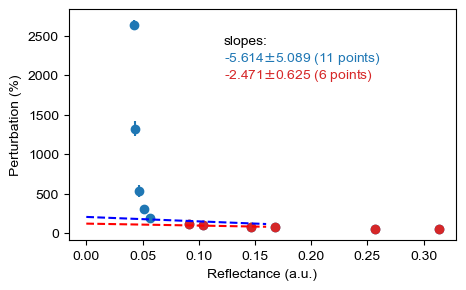

[0.10364404 0.04262804 0.05114961 0.04367334 0.09166701 0.05681727
 0.04666874 0.16796363 0.14635937 0.2572114  0.31339668]


-2.47050314053624

In [9]:
z,fp = 68, 6
w=1./o1.sls[z,fp,:]    
x=o1.c3d[z,fp,:]/o1.toa[:]*np.pi
mask = np.argsort(x)[5:]
res=np.polyfit(x,o1.sl[z,fp,:],1,w=w,cov=True) # now get covariance as well!
slope_11,intercept_11=res[0]
slopestd_11=np.sqrt(res[1][0][0])

fig, ax = plt.subplots(figsize=(5, 3))
ax.scatter(x, o1.sl[z,fp,:]*100)
ax.plot([0, 0.16], (np.array([0, 0.16])*slope_11+intercept_11)*100, '--', color='blue')
ax.errorbar(x,o1.sl[z,fp,:]*100, yerr=o1.sls[z,fp,:]*100, color='tab:blue', ls='none')
print(slope_11)
res=np.polyfit(x[mask],o1.sl[z,fp,:][mask],1,w=w[mask],cov=True) # now get covariance as well!
slope,intercept=res[0]
slopestd=np.sqrt(res[1][0][0])
ax.errorbar(x[mask],o1.sl[z,fp,:][mask]*100, yerr=o1.sls[z,fp,:][mask]*100, color='tab:red', ls='none')
ax.scatter(x[mask], o1.sl[z,fp,:][mask]*100, c='tab:red')
ax.plot([0, 0.16], (np.array([0, 0.16])*slope+intercept)*100, '--', color='red')
xmin, xmax = ax.get_xlim()
ymin, ymax = ax.get_ylim()
ax.text((xmax-xmin)*0.4+xmin, (ymax-ymin)*0.85+ymin, 'slopes:')
ax.text((xmax-xmin)*0.4+xmin, (ymax-ymin)*0.775+ymin, f'{slope_11:.3f}$\pm${slopestd_11:.3f} (11 points)', color='tab:blue')
ax.text((xmax-xmin)*0.4+xmin, (ymax-ymin)*0.7+ymin, f'{slope:.3f}$\pm${slopestd:.3f} (6 points)', color='tab:red')
ax.set_xlabel('Reflectance (a.u.)')
ax.set_ylabel('Perturbation (%)')
plt.show()
print(x)
slope


In [10]:
x[np.argsort(x)[3:]]

array([0.05114961, 0.05681727, 0.09166701, 0.10364404, 0.14635937,
       0.16796363, 0.2572114 , 0.31339668])

In [9]:
litefile = '../dat/oco2_LtCO2_170605_B10206Ar_200730080146s.nc4'
lite = xr.open_dataset(litefile)

In [10]:
cloudfile = '../steve/oco2_LtCO2_150622_B9003r_180928052221s_3Dmetrics.nc4'
cloud = xr.open_dataset(cloudfile)
#cloud

In [15]:
boundary_list

[[[-67.1991, -66.2404, -0.0047, 1.097], 'r']]

In [16]:
np.array(boundary_list)

array([[list([-67.1991, -66.2404, -0.0047, 1.097]), 'r']], dtype=object)

In [11]:
lon_w, lon_e = np.array(boundary_list)[0, 0][0], np.array(boundary_list)[0, 0][1]
lat_s, lat_n = np.array(boundary_list)[0, 0][2], np.array(boundary_list)[0, 0][3]
lon_range = np.logical_and(lite.longitude >= lon_w, lite.longitude <= lon_e)
lat_range = np.logical_and(lite.latitude >= lat_s, lite.latitude <= lat_n)

select = np.where(np.logical_and(lon_range, lat_range))
lite_snd_list = np.array(lite.sounding_id[select], dtype=np.int)


In [12]:
qf_array = np.zeros((o1.snd.shape[0], o1.snd.shape[1], 3))
cld_array = np.zeros((o1.snd.shape[0], o1.snd.shape[1], 4))
qf_lon, qf_lat = np.zeros((o1.snd.shape[0], o1.snd.shape[1])), np.zeros((o1.snd.shape[0], o1.snd.shape[1]))
# qf, qf_bitflag, qf_simpleflag\
for i in range(o1.snd.shape[0]):
    for j in range(o1.snd.shape[1]):
        snd = o1.snd[i, j]
        #print('-'*15)
        #print(snd)
        if snd in lite_snd_list:
            index = np.where(lite_snd_list == snd)[0][0]
            xco2_quality_flag = np.float(lite.xco2_quality_flag[select][index])
            xco2_qf_bitflag = np.float(lite.xco2_qf_bitflag[select][index])
            xco2_qf_simple_bitflag = np.float(lite.xco2_qf_simple_bitflag[select][index])
            qf_array[i, j, :] = (xco2_quality_flag, xco2_qf_bitflag, xco2_qf_simple_bitflag)
            qf_lat[i, j] = np.float(lite.latitude[select][index])
            qf_lon[i, j] = np.float(lite.longitude[select][index])
        else:
            qf_array[i, j, :] = (np.nan,)*3
            qf_lat[i, j] = np.nan
            qf_lon[i, j] = np.nan
        """if snd in cloud.sounding_id:
            index = np.where(cloud.sounding_id == snd)[0][0]
            cld_dist = np.float(cloud.cld_dist[index])
            h3d = np.float(cloud.h3d[index])
            cs_noise_ratio = np.float(cloud.cs_noise_ratio[index])
            hc = np.float(cloud.hc[index])
            cld_array[i, j, :] = (cld_dist, h3d, cs_noise_ratio, hc)
        else:
            cld_array[i, j, :] = (np.nan,)*4"""

In [19]:
qf0_index = np.where(qf_array[:,:,0]==0)

In [20]:
qf0_index[0]

array([12, 12, 12, 23, 24, 24, 24, 24, 24, 24, 24, 25, 25, 25, 25, 25, 26,
       26, 26, 26, 26, 27, 27, 27, 27, 27, 27, 27, 28, 28, 28, 28, 28, 28,
       28, 29, 29, 29, 29, 29, 29, 29, 30, 30, 30, 30, 30, 30, 30, 30, 31,
       31, 31, 31, 31, 31, 31, 31, 32, 32, 32, 32, 32, 32, 32, 32, 33, 33,
       33, 33, 33, 33, 33, 33, 34, 34, 34, 34, 34, 34, 34, 34, 35, 35, 35,
       35, 35, 35, 35, 35, 36, 36, 36, 36, 36, 36, 36, 36, 37, 37, 37, 37,
       37, 37, 37, 37, 38, 38, 38, 38, 38, 38, 38, 38, 39, 39, 39, 39, 39,
       39, 39, 39, 40, 40, 40, 40, 40, 40, 41, 41, 41, 41, 41, 41, 41, 41,
       42, 42, 42, 42, 42, 42, 43, 43, 43, 43, 43, 44, 44, 44, 44, 44, 44,
       44, 45, 45, 45, 45, 45, 45, 45, 45, 46, 46, 57, 58, 58])

In [21]:
cld_list = []
for i in range(len(qf0_index[0])):
    cld_list.append(cld_array[qf0_index[0][i], qf0_index[1][i], 0])
np.mean(cld_list)

0.0

0.0


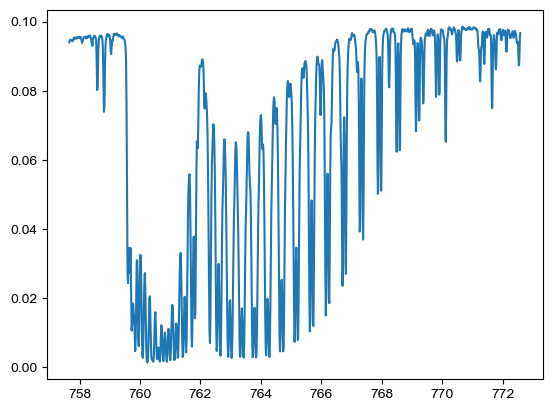

In [22]:
plt.plot(o1.wvl[9,0,:], o1.l1b[9,0,:])
print(cld_array[9, 0, 0])

In [13]:
class sat_tmp:

    def __init__(self, data):

        self.data = data

cldfile = '../simulation/data/20170605_amazon_470cloud_20170605/pre-data.h5'
data = {}
f = h5py.File(cldfile, 'r')
data['lon_2d'] = dict(name='Gridded longitude'               , units='degrees'    , data=f['mod/rad/lon'][...])
data['lat_2d'] = dict(name='Gridded latitude'                , units='degrees'    , data=f['mod/rad/lat'][...])
data['cot_2d'] = dict(name='Gridded cloud optical thickness' , units='N/A'        , data=f[f'mod/cld/cot_3D'][...])
data['cer_2d'] = dict(name='Gridded cloud effective radius'  , units='micro'      , data=f[f'mod/cld/cer_3D'][...])
data['cth_2d'] = dict(name='Gridded cloud top height'        , units='km'         , data=f[f'mod/cld/cth_3D'][...])
f.close()


#modl1b    = pre_cld(sat, tag, cth=cth, scale_factor=scale_factor, solver=solver, ref_threshold=ref_threshold)
modl1b    =  sat_tmp(data)

In [14]:
modl1b.data['cth_2d']['data'].shape

(540, 600)

In [28]:
(o1.lon2d).shape

(540, 600)

In [15]:
def rgb2hsv(rgb):
    """ convert RGB to HSV color space

    :param rgb: np.ndarray
    :return: np.ndarray
    """

    rgb = rgb.astype('float')
    maxv = np.amax(rgb, axis=2)
    maxc = np.argmax(rgb, axis=2)
    minv = np.amin(rgb, axis=2)
    minc = np.argmin(rgb, axis=2)

    hsv = np.zeros(rgb.shape, dtype='float')
    hsv[maxc == minc, 0] = np.zeros(hsv[maxc == minc, 0].shape)
    hsv[maxc == 0, 0] = (((rgb[..., 1] - rgb[..., 2]) * 60.0 / (maxv - minv + np.spacing(1))) % 360.0)[maxc == 0]
    hsv[maxc == 1, 0] = (((rgb[..., 2] - rgb[..., 0]) * 60.0 / (maxv - minv + np.spacing(1))) + 120.0)[maxc == 1]
    hsv[maxc == 2, 0] = (((rgb[..., 0] - rgb[..., 1]) * 60.0 / (maxv - minv + np.spacing(1))) + 240.0)[maxc == 2]
    hsv[maxv == 0, 1] = np.zeros(hsv[maxv == 0, 1].shape)
    hsv[maxv != 0, 1] = (1 - minv / (maxv + np.spacing(1)))[maxv != 0]
    hsv[..., 2] = maxv

    return hsv

mod_rgb = mpimg.imread(png[0])
wesn = png[1]
lon_rgb0 = np.linspace(wesn[0], wesn[1], mod_rgb.shape[1]+1)
lat_rgb0 = np.linspace(wesn[2], wesn[3], mod_rgb.shape[0]+1)
lon_rgb = (lon_rgb0[1:]+lon_rgb0[:-1])/2.0
lat_rgb = (lat_rgb0[1:]+lat_rgb0[:-1])/2.0

lon_rgb_2d, lat_rgb_2d = np.meshgrid(lon_rgb, lat_rgb[::-1], indexing='xy')

mod_r = mod_rgb[:, :, 0]
mod_g = mod_rgb[:, :, 1]
mod_b = mod_rgb[:, :, 2]
mod_hsv = rgb2hsv(mod_rgb[:,:,:3])
mod_h = mod_hsv[:, :, 0]
mod_s = mod_hsv[:, :, 1]
mod_v = mod_hsv[:, :, 2]
mod_v_over_s = mod_v/mod_s


logic_rgb_nan0 = np.logical_or(mod_v<=0.52, mod_s>0.17)

logic_rgb_nan = np.flipud(logic_rgb_nan0).T

x0_rgb = lon_rgb[0]
y0_rgb = lat_rgb[0]
dx_rgb = lon_rgb[1] - x0_rgb
dy_rgb = lat_rgb[1] - y0_rgb

lon_2d, lat_2d = o1.lon2d[:-2:3, :-1:3], o1.lat2d[:-2:3, :-1:3]
indices_x = np.int_(np.round((lon_2d-x0_rgb)/dx_rgb, decimals=0))
indices_y = np.int_(np.round((lat_2d-y0_rgb)/dy_rgb, decimals=0))
indices_x[indices_x>=943] = 942
indices_y[indices_y>=1386] = 1385


print(logic_rgb_nan.shape)
logic_ref_nan = logic_rgb_nan[indices_x, indices_y]

indices    = np.where(logic_ref_nan!=1)
indices_x  = indices[0]
indices_y  = indices[1]
lon = lon_2d[indices_x, indices_y]
lat = lat_2d[indices_x, indices_y]

cloud = np.zeros_like(o1.lon2d[:-2:3, :-1:3])
cloud[indices_x, indices_y] = 1


cld_X, cld_Y = np.where(cloud==1)[0], np.where(cloud==1)[1]
cld_position = []
for i in range(len(cld_X)):
    cld_position.append(np.array([cld_X[i], cld_Y[i]]))
cld_position = np.array(cld_position)

(1244, 1386)


In [16]:
lon_2d.shape

(180, 200)

In [16]:
lon_cld, lat_cld = modl1b.data['lon_2d']['data'], modl1b.data['lat_2d']['data']
cld_list = modl1b.data['cth_2d']['data']>0
cld_list_stripe = cld_list[:-2:3, :-1:3]
lon = lon_2d[cld_list_stripe==True]
lat = lat_2d[cld_list_stripe==True]
cld_X, cld_Y = np.where(cld_list_stripe==1)[0], np.where(cld_list_stripe==1)[1]
cld_position = []
for i in range(len(cld_X)):
    cld_position.append(np.array([cld_X[i], cld_Y[i]]))
cld_position = np.array(cld_position)

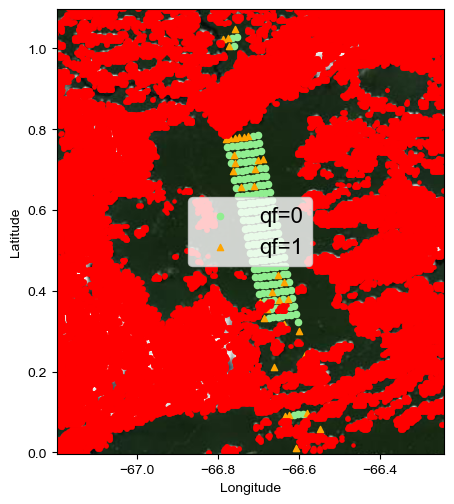

In [18]:
f,frame=plt.subplots(figsize=(5, 20))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
frame.scatter(qf_lon.flatten()[qf_array[:, :, 0].flatten()==0], qf_lat.flatten()[qf_array[:, :, 0].flatten()==0], s=20,
              marker='o', color='lightgreen', label='qf=0')
frame.scatter(qf_lon.flatten()[qf_array[:, :, 0].flatten()==1], qf_lat.flatten()[qf_array[:, :, 0].flatten()==1], s=20,
              marker='^', color='orange', label='qf=1')
frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

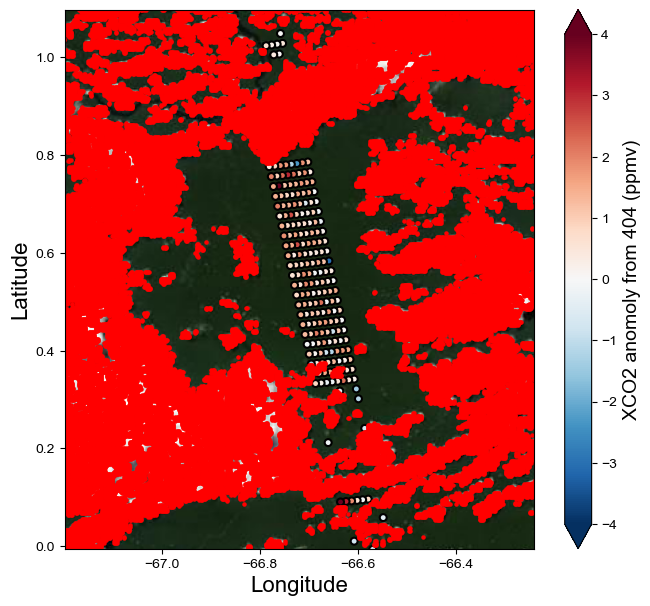

In [29]:
f,frame=plt.subplots(figsize=(8, 7))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
anomaly = 404
c = frame.scatter(o1.lon.flatten(), o1.lat.flatten(),
              s=25, c=o1.co2.flatten()*1e6-anomaly,
                  vmin=-4, vmax=4,
              marker='o', edgecolors='k', linewidths=1.5, cmap='RdBu_r')
cbar = f.colorbar(c, extend='both')
cbar.set_label(f'XCO2 anomoly from {anomaly} (ppmv)', fontsize=14)
frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
#frame.legend(fontsize=16, facecolor='white')
frame.set_xlabel('Longitude', fontsize=16)
frame.set_ylabel('Latitude', fontsize=16)

plt.show()

In [124]:
geopy.distance.distance((o1.lat2d[0, 3], o1.lon2d[0, 0]), (o1.lat2d[0, 0], o1.lon2d[0, 0])).km

0.8062129521676024

In [68]:
geopy.distance.distance((o1.lat2d[0, 0], o1.lon2d[3, 0]), (o1.lat2d[0, 0], o1.lon2d[0, 0])).km

0.7869122542127734

In [69]:
geopy.distance.distance((o1.lat2d[3, 0], o1.lon2d[0, 0]), (o1.lat2d[0, 0], o1.lon2d[0, 0])).km

0.0

In [17]:
cloud_dist = np.zeros_like(o1.slope_1km_all[:,:,0])
for j in range(cloud_dist.shape[1]):
    for i in range(cloud_dist.shape[0]):
        if cld_list_stripe[i, j] == 1:
            cloud_dist[i, j] = 0
        else:
            min_ind = np.argmin(np.sqrt(np.sum((cld_position-np.array([i, j]))**2, axis=1)))
            #print(min_ind)
            #print(cld_position[min_ind])
            cld_x, cld_y = cld_position[min_ind][0], cld_position[min_ind][1]
            dist = geopy.distance.distance((o1.lat2d[cld_x, cld_y], o1.lon2d[cld_x, cld_y]), (o1.lat2d[i, j], o1.lon2d[i, j])).km
            #print(dist)
            cloud_dist[i, j] = dist


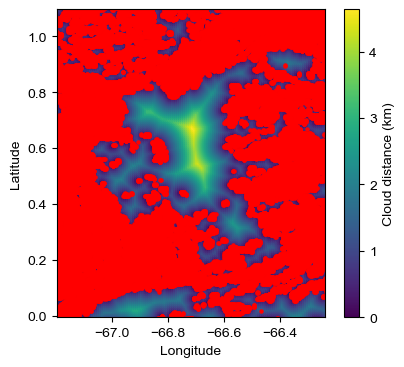

In [25]:
f,frame=plt.subplots(figsize=(5, 4))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
#frame.scatter(qf_lon.flatten()[qf_array[:, :, 0].flatten()==0], qf_lat.flatten()[qf_array[:, :, 0].flatten()==0], s=20,
#              marker='o', color='lightgreen', label='qf=0')
#frame.scatter(qf_lon.flatten()[qf_array[:, :, 0].flatten()==1], qf_lat.flatten()[qf_array[:, :, 0].flatten()==1], s=20,
#              marker='^', color='orange', label='qf=1')
#frame.scatter(lon, lat, s=5, color='r')
c = frame.scatter(o1.lon2d[:-2:3, :-1:3].flatten(), o1.lat2d[:-2:3, :-1:3].flatten(), s=5, c=cloud_dist.flatten())#, cmap='jet')
frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')


#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(c)
cbar.set_label('Cloud distance (km)')
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

In [18]:
output = np.array([o1.lon2d[:-2:3, :-2:3], o1.lat2d[:-2:3, :-2:3], cloud_dist, 
                   o1.slope_1km_all[:,:,0], o1.inter_1km_all[:,:,0],
                   o2.slope_1km_all[:,:,0], o2.inter_1km_all[:,:,0],
                   o3.slope_1km_all[:,:,0], o3.inter_1km_all[:,:,0],
                   o1.rad_1km_c3d_all[:,:,-1], o1.rad_1km_clr_all[:,:,-1],
                   o2.rad_1km_c3d_all[:,:,-1], o2.rad_1km_clr_all[:,:,-1],
                   o3.rad_1km_c3d_all[:,:,-1], o3.rad_1km_clr_all[:,:,-1],
                   ])
cld_slope_inter = pd.DataFrame(output.reshape(output.shape[0], output.shape[1]*output.shape[2]).T,
                               columns=['lon', 'lat', 'cld_dis', 
                                        'o2a_slope', 'o2a_inter', 
                                        'wco2_slope', 'wco2_inter', 
                                        'sco2_slope', 'sco2_inter',
                                        'o2a_continuum_3d', 'o2a_continuum_clr',
                                        'wco2_continuum_3d', 'wco2_continuum_clr',
                                        'sco2_continuum_3d', 'sco2_continuum_clr',])

cld_slope_inter.to_pickle('cld_slope_inter_amazon_20170605.pkl')

print(cld_slope_inter.shape)

(36000, 15)


In [33]:
o1.lon2d[:-2:3, :-1:3].shape

(160, 207)

In [115]:
cloud_dist.shape

(160, 207)

In [116]:
o1.slope_1km_all.shape

(160, 207, 2)

In [36]:
def heatmap_xy(x, y, ax):
    light_jet = cmap_map(lambda x: x/3*2 + 0.33, cm.jet)
    mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
    x, y = x[mask], y[mask]
    # Calculate the point density
    data , x_e, y_e = np.histogram2d(x, y, bins=15, density=True)
    z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)
    z[np.where(np.isnan(z))] = 0.0
    z[np.where(np.isinf(z))] = np.nanmax(z)
    z[np.where(z<0)] = 0.0
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    plot_x, plot_y, z = np.array(x)[idx], np.array(y)[idx], z[idx]
    ax.scatter(plot_x, plot_y, c=z, s=15, cmap=light_jet)
    return plot_x, plot_y, z

In [22]:
def heatmap_xy(x, y, ax):
    from matplotlib.colors import LogNorm
    light_jet = cmap_map(lambda x: x/3*2 + 0.33, cm.jet)
    mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
    x, y = x[mask], y[mask]
    # Calculate the point density
    data , x_e, y_e = np.histogram2d(x, y, bins=15)#, density=True)
    z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)
    z[np.where(np.isnan(z))] = 0.0
    z[np.where(np.isinf(z))] = np.nanmax(z)
    z[np.where(z<0)] = 0.0
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    plot_x, plot_y, z = np.array(x)[idx], np.array(y)[idx], z[idx]
    #ax.scatter(plot_x, plot_y, c=z, s=15*z/np.nanmax(z), cmap=light_jet)
    ax.scatter(plot_x, plot_y, s=3, c='k')
    #ax.hist2d(plot_x, plot_y, bins=150, norm=LogNorm(), cmap=light_jet)
    out = pd.DataFrame(np.array([x, y]).T, columns=['x', 'y'])
    sns.kdeplot(out, x='x', y='y', cmap='hot_r', n_levels=20, fill=True, ax=ax, alpha=0.65)
    return plot_x, plot_y, z

In [37]:
def heatmap_xy(x, y, ax):
    from matplotlib.colors import LogNorm
    light_jet = cmap_map(lambda x: x/3*2 + 0.33, cm.jet)
    mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
    x, y = x[mask], y[mask]
    # Calculate the point density
    data , x_e, y_e = np.histogram2d(x, y, bins=150)#, density=True)
    z = interpn((0.5*(x_e[1:] + x_e[:-1]), 0.5*(y_e[1:]+y_e[:-1])), data, np.vstack([x, y]).T, method="splinef2d", bounds_error=False)
    z[np.where(np.isnan(z))] = 0.0
    z[np.where(np.isinf(z))] = np.nanmax(z)
    z[np.where(z<0)] = 0.0
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    plot_x, plot_y, z = np.array(x)[idx], np.array(y)[idx], z[idx]
    #ax.scatter(plot_x, plot_y, c=z, s=15*z/np.nanmax(z), cmap=light_jet)
    #ax.scatter(plot_x, plot_y, s=3, c='k')
    ax.hist2d(plot_x, plot_y, bins=150, norm=LogNorm(), cmap=light_jet)
    #out = pd.DataFrame(np.array([x, y]).T, columns=['x', 'y'])
    #sns.kdeplot(out, x='x', y='y', cmap='hot_r', n_levels=20, fill=True, ax=ax, alpha=0.65)
    return plot_x, plot_y, z

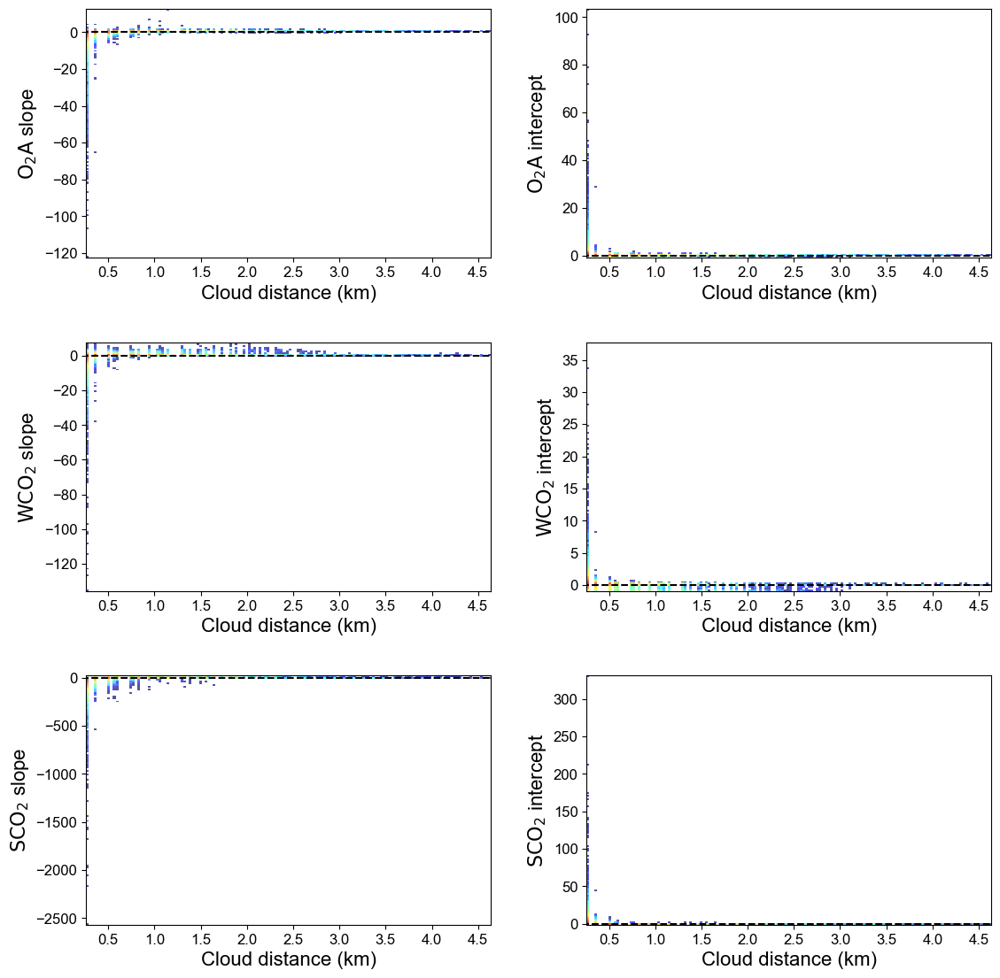

In [38]:
fig, ((ax11, ax12), 
      (ax21, ax22),
      (ax31, ax32)) = plt.subplots(3, 2, figsize=(12, 12), sharex=False)
fig.tight_layout(pad=5.0)
label_size = 16
tick_size = 12
mask = cloud_dist > 0
heatmap_xy(cloud_dist[mask], o1.slope_1km_all[:,:,0][mask], ax11)
heatmap_xy(cloud_dist[mask], o1.inter_1km_all[:,:,0][mask], ax12)
heatmap_xy(cloud_dist[mask], o2.slope_1km_all[:,:,0][mask], ax21)
heatmap_xy(cloud_dist[mask], o2.inter_1km_all[:,:,0][mask], ax22)
heatmap_xy(cloud_dist[mask], o3.slope_1km_all[:,:,0][mask], ax31)
heatmap_xy(cloud_dist[mask], o3.inter_1km_all[:,:,0][mask], ax32)

for ax in [ax11, ax21, ax31, ax12, ax22, ax32]:
    ax.set_xlabel('Cloud distance (km)', fontsize=label_size)
    ax.tick_params(axis='both', labelsize=tick_size)
    _, xmax = ax.get_xlim()
    ax.hlines(0, 0, xmax, linestyle='--', color='k')
    #ax.set_ylim(-1, 1.)

ax11.set_ylabel('$\mathrm{O_2A}$ slope', fontsize=label_size)
ax12.set_ylabel('$\mathrm{O_2A}$ intercept', fontsize=label_size)
ax21.set_ylabel('$\mathrm{WCO_2}$ slope', fontsize=label_size)
ax22.set_ylabel('$\mathrm{WCO_2}$ intercept', fontsize=label_size)
ax31.set_ylabel('$\mathrm{SCO_2}$ slope', fontsize=label_size)
ax32.set_ylabel('$\mathrm{SCO_2}$ intercept', fontsize=label_size)


#ax.plot([20, 20], [0, 1.1], 'r')
#ax.plot([400, 400], [0, 1.1], 'r')

#ax.fill_between(t[2:41]*1e9, intensity[2:41], 0, color='lightgrey', interpolate=True)
#I0 = quad(intensity_fxn, 20e-9, 400e-9, args=(decay_const))[0]

#ax.set_yscale('log')
#fig.savefig('Q2.1-2.png', dpi=150, bbox_inches='tight')
plt.show()

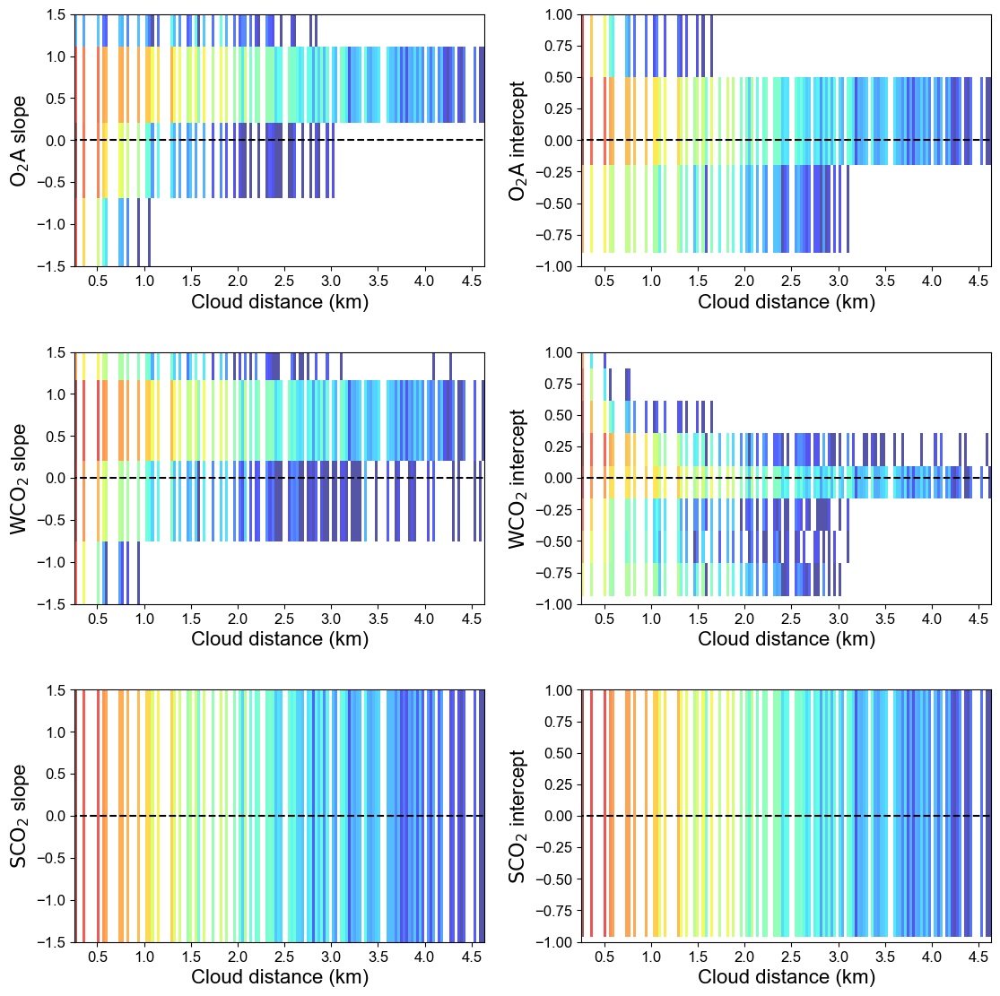

In [39]:
fig, ((ax11, ax12), 
      (ax21, ax22),
      (ax31, ax32)) = plt.subplots(3, 2, figsize=(12, 12), sharex=False)
fig.tight_layout(pad=5.0)
label_size = 16
tick_size = 12
mask = cloud_dist > 0
#"""
heatmap_xy(cloud_dist[mask], o1.slope_1km_all[:,:,0][mask], ax11)
heatmap_xy(cloud_dist[mask], o1.inter_1km_all[:,:,0][mask], ax12)
heatmap_xy(cloud_dist[mask], o2.slope_1km_all[:,:,0][mask], ax21)
heatmap_xy(cloud_dist[mask], o2.inter_1km_all[:,:,0][mask], ax22)
heatmap_xy(cloud_dist[mask], o3.slope_1km_all[:,:,0][mask], ax31)
heatmap_xy(cloud_dist[mask], o3.inter_1km_all[:,:,0][mask], ax32)
#"""

"""
ax11.scatter(cloud_dist[mask], o1.slope_1km_all[:,:,0][mask])
ax12.scatter(cloud_dist[mask], o1.inter_1km_all[:,:,0][mask])
ax21.scatter(cloud_dist[mask], o2.slope_1km_all[:,:,0][mask])
ax22.scatter(cloud_dist[mask], o2.inter_1km_all[:,:,0][mask])
ax31.scatter(cloud_dist[mask], o3.slope_1km_all[:,:,0][mask])
ax32.scatter(cloud_dist[mask], o3.inter_1km_all[:,:,0][mask])
#"""
for ax in [ax11, ax21, ax31, ax12, ax22, ax32]:
    ax.set_xlabel('Cloud distance (km)', fontsize=label_size)
    ax.tick_params(axis='both', labelsize=tick_size)
    _, xmax = ax.get_xlim()
    ax.hlines(0, 0, xmax, linestyle='--', color='k')
    
ax11.set_ylabel('$\mathrm{O_2A}$ slope', fontsize=label_size)
ax12.set_ylabel('$\mathrm{O_2A}$ intercept', fontsize=label_size)
ax21.set_ylabel('$\mathrm{WCO_2}$ slope', fontsize=label_size)
ax22.set_ylabel('$\mathrm{WCO_2}$ intercept', fontsize=label_size)
ax31.set_ylabel('$\mathrm{SCO_2}$ slope', fontsize=label_size)
ax32.set_ylabel('$\mathrm{SCO_2}$ intercept', fontsize=label_size)

for ax in [ax11, ax21, ax31]:
    ax.set_ylim(-1.5, 1.5)
    
for ax in [ax12, ax22, ax32]:
    ax.set_ylim(-1, 1)

#ax.plot([20, 20], [0, 1.1], 'r')
#ax.plot([400, 400], [0, 1.1], 'r')
#ax.set_ylim(0, 1.1)
#ax.fill_between(t[2:41]*1e9, intensity[2:41], 0, color='lightgrey', interpolate=True)
#I0 = quad(intensity_fxn, 20e-9, 400e-9, args=(decay_const))[0]

#ax.set_yscale('log')
#fig.savefig('Q2.1-2.png', dpi=150, bbox_inches='tight')
plt.show()

In [44]:
def heatmap_xy_2(x, y, ax):
    light_jet = cmap_map(lambda x: x/3*2 + 0.33, cm.jet)
    mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
    x, y = x[mask], y[mask]
    # Calculate the point density
    
    interval = 1/2
    start = 0.25
    cld_levels = np.arange(start, 15, interval)
    value_avg, value_std = np.zeros(len(cld_levels)-1), np.zeros(len(cld_levels)-1)
    for i in range(len(cld_levels)-1):
        select = np.logical_and(x>=cld_levels[i], x < cld_levels[i+1])
        if select.sum()>0:
            #value_avg[i] = np.nanmean(y[select])
            #value_std[i] = np.nanstd(y[select])
            value_avg[i] = np.percentile(y[select], 50)
            value_std[i] = np.percentile(y[select], 75)-np.percentile(y[select], 25)
        else:
            value_avg[i] = np.nan
            value_std[i] = np.nan
    cld_list = (cld_levels[:-1] + cld_levels[1:])/2
    ax.scatter(x[x<start], y[x<start], s=1, color='lightgrey')
    ax.scatter(x[x>=start], y[x>=start], s=1, color='k')
    ax.errorbar(cld_list, value_avg, yerr=value_std, 
                marker='s', color='r', linewidth=2, linestyle='')#light_jet)
    
    val_mask = ~(np.isnan(value_avg) | np.isnan(value_std) | np.isinf(value_avg) | np.isinf(value_std))
    print(value_avg[val_mask])
    print(value_std[val_mask])
    popt, pcov = curve_fit(func, cld_list[val_mask], value_avg[val_mask], bounds=([-2, 0.], [2, 10,]),
                           p0=(0.1, 0.7),
                           maxfev=3000,
                           #sigma=value_std[val_mask], 
                           #absolute_sigma=True,
                          )

    ax.plot(cld_list, func(cld_list, *popt), '--', color='orange', 
              label='fit: a=%5.3f, b=%5.3f' % tuple(popt), linewidth=3.5)
    
    #ax.plot(cld_list, func(cld_list, 1, 2), '--', color='green',)
    #ax.plot(cld_list, func(cld_list, 0.2, 1), '--', color='cyan',)
    ax.legend()
    return None#XX, YY, heatmap

from  scipy.optimize import curve_fit

def func(x, a, b):
     return a * np.exp(-b * x)

[-0.16220975  0.3588735   0.38144134  0.36272043  0.35648339  0.34991342
  0.34638178  0.34089124  0.37916035]
[1.75858688 0.14760435 0.1313083  0.12557636 0.12091885 0.09275726
 0.06748637 0.06701418 0.09386757]
[0.3007477  0.15459196 0.1241937  0.11656389 0.11928004 0.12283021
 0.12437539 0.12230113 0.12167634]
[0.46662715 0.13768737 0.27487414 0.3206669  0.16297318 0.02175998
 0.01677352 0.01804422 0.01500826]
[0.24224597 0.62119709 0.63910497 0.62077927 0.60528516 0.55365235
 0.52299642 0.57113993 0.62343266]
[1.55030798 0.47355947 0.49880265 0.53839423 0.48213142 0.3868543
 0.32166166 0.39614291 0.38475516]
[0.18025481 0.07069775 0.04276954 0.03485463 0.04051296 0.04621503
 0.05067534 0.04354583 0.04714395]
[0.4301877  0.13971946 0.26850414 0.32438124 0.19664608 0.05065057
 0.03217014 0.03604676 0.04751945]
[-12.19107393   1.04813747   1.81024159   1.76083755   1.59752565
   1.07326156   0.85076239   1.68038667   0.6585904 ]
[37.75446062  2.68851619  2.48922696  2.78867269  2.7556

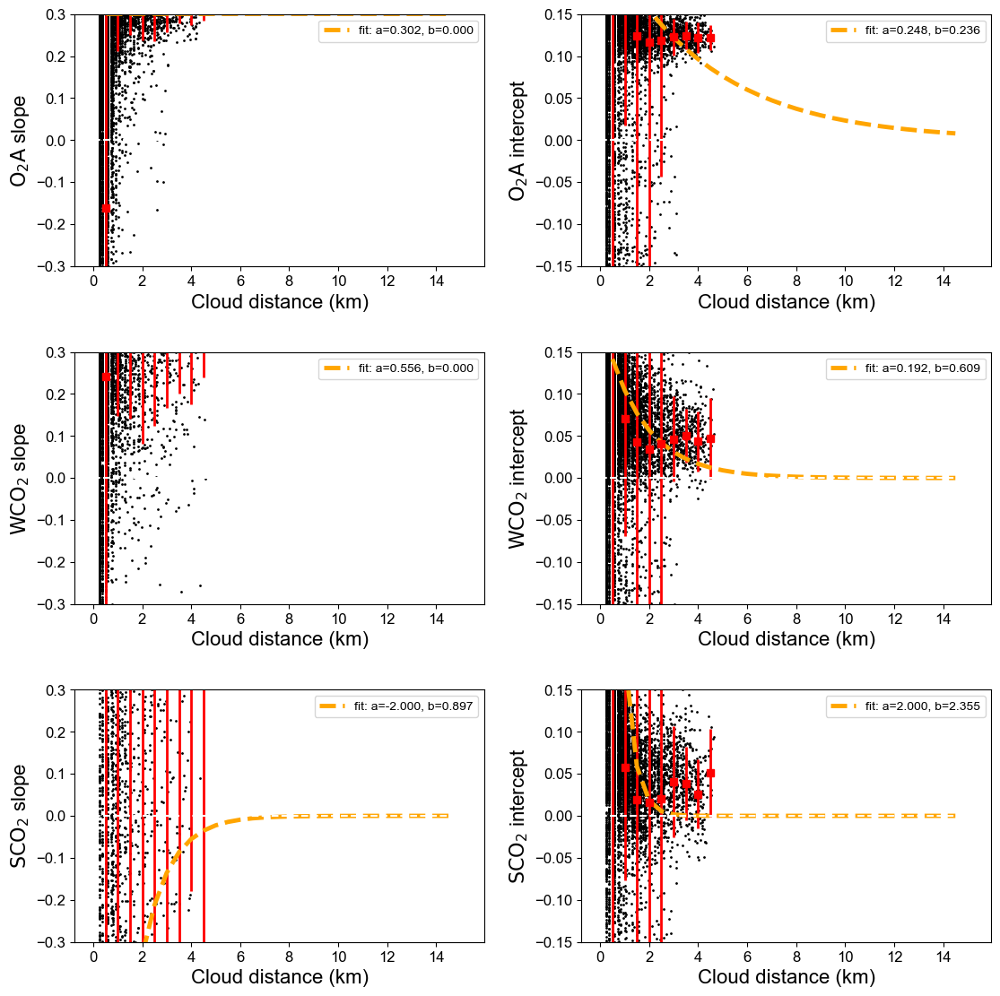

In [47]:
fig, ((ax11, ax12), 
      (ax21, ax22),
      (ax31, ax32)) = plt.subplots(3, 2, figsize=(12, 12), sharex=False)
fig.tight_layout(pad=5.0)
label_size = 16
tick_size = 12
mask = cloud_dist > 0
#mask = np.logical_and(cloud_dist > 0, o1.rad_1km_c3d_all[:,:,-1]>o1.rad_1km_clr_all[:,:,-1])

#"""
heatmap_xy_2(cloud_dist[mask], o1.slope_1km_all[:,:,0][mask], ax11)
heatmap_xy_2(cloud_dist[mask], o1.inter_1km_all[:,:,0][mask], ax12)
heatmap_xy_2(cloud_dist[mask], o2.slope_1km_all[:,:,0][mask], ax21)
heatmap_xy_2(cloud_dist[mask], o2.inter_1km_all[:,:,0][mask], ax22)
heatmap_xy_2(cloud_dist[mask], o3.slope_1km_all[:,:,0][mask], ax31)
heatmap_xy_2(cloud_dist[mask], o3.inter_1km_all[:,:,0][mask], ax32)
#"""


#popt, pcov = curve_fit(func, cloud_dist[mask], o1.slope_1km_all[:,:,0][mask])#, bounds=(0, [3., 1., 0.5]))

#ax11.plot(cloud_dist[mask], func(cloud_dist[mask], *popt), 'r--',
#          label='fit: a=%5.3f, b=%5.3ff' % tuple(popt))


"""
ax11.scatter(cloud_dist[mask], o1.slope_1km_all[:,:,0][mask])
ax12.scatter(cloud_dist[mask], o1.inter_1km_all[:,:,0][mask])
ax21.scatter(cloud_dist[mask], o2.slope_1km_all[:,:,0][mask])
ax22.scatter(cloud_dist[mask], o2.inter_1km_all[:,:,0][mask])
ax31.scatter(cloud_dist[mask], o3.slope_1km_all[:,:,0][mask])
ax32.scatter(cloud_dist[mask], o3.inter_1km_all[:,:,0][mask])
#"""
for ax in [ax11, ax21, ax31, ax12, ax22, ax32]:
    ax.set_xlabel('Cloud distance (km)', fontsize=label_size)
    ax.tick_params(axis='both', labelsize=tick_size)
    _, xmax = ax.get_xlim()
    ax.hlines(0, 0, xmax, linestyle='--', color='white')
    
ax11.set_ylabel('$\mathrm{O_2A}$ slope', fontsize=label_size)
ax12.set_ylabel('$\mathrm{O_2A}$ intercept', fontsize=label_size)
ax21.set_ylabel('$\mathrm{WCO_2}$ slope', fontsize=label_size)
ax22.set_ylabel('$\mathrm{WCO_2}$ intercept', fontsize=label_size)
ax31.set_ylabel('$\mathrm{SCO_2}$ slope', fontsize=label_size)
ax32.set_ylabel('$\mathrm{SCO_2}$ intercept', fontsize=label_size)

limit_1 = 0.3
limit_2 = 0.15
for ax in [ax11, ax21, ax31]:
    ax.set_ylim(-limit_1, limit_1)
    
for ax in [ax12, ax22, ax32]:
    ax.set_ylim(-limit_2, limit_2)

#ax.plot([20, 20], [0, 1.1], 'r')
#ax.plot([400, 400], [0, 1.1], 'r')
#ax.set_ylim(0, 1.1)
#ax.fill_between(t[2:41]*1e9, intensity[2:41], 0, color='lightgrey', interpolate=True)
#I0 = quad(intensity_fxn, 20e-9, 400e-9, args=(decay_const))[0]

#ax.set_yscale('log')
#fig.savefig('Q2.1-2.png', dpi=150, bbox_inches='tight')
plt.show()

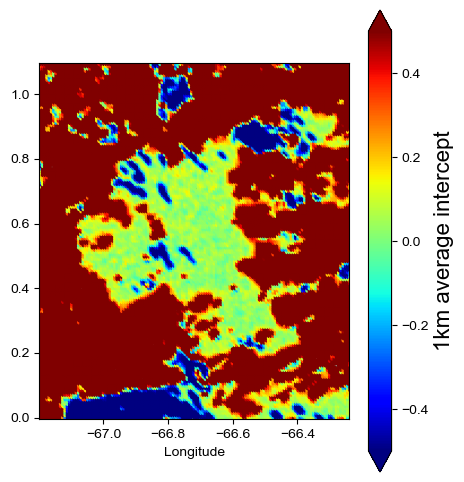

In [39]:
f,frame=plt.subplots(figsize=(5, 6))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = (o1.co2.flatten()*1e6)>407.7
frame.scatter(o1.lon.flatten()[mask], o1.lat.flatten()[mask],
              s=50,
              marker='o', facecolor='none', edgecolors='k', linewidths=1.5, alpha=0.8)
#"""
cc = frame.scatter(o1.lon_all, o1.lat_all, 
              s=5,
              marker='o', c=o3.inter_1km_all[:,:,0], cmap='jet',
              vmin=-0.5, vmax=0.5)

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, extend='both')
cbar.set_label('1km average intercept', fontsize=16)
#"""

#frame.scatter(lon_cld[cld_list>0], lat_cld[cld_list>0], s=5, color='r')





#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
#plt.ylabel('Latitude')

plt.show()

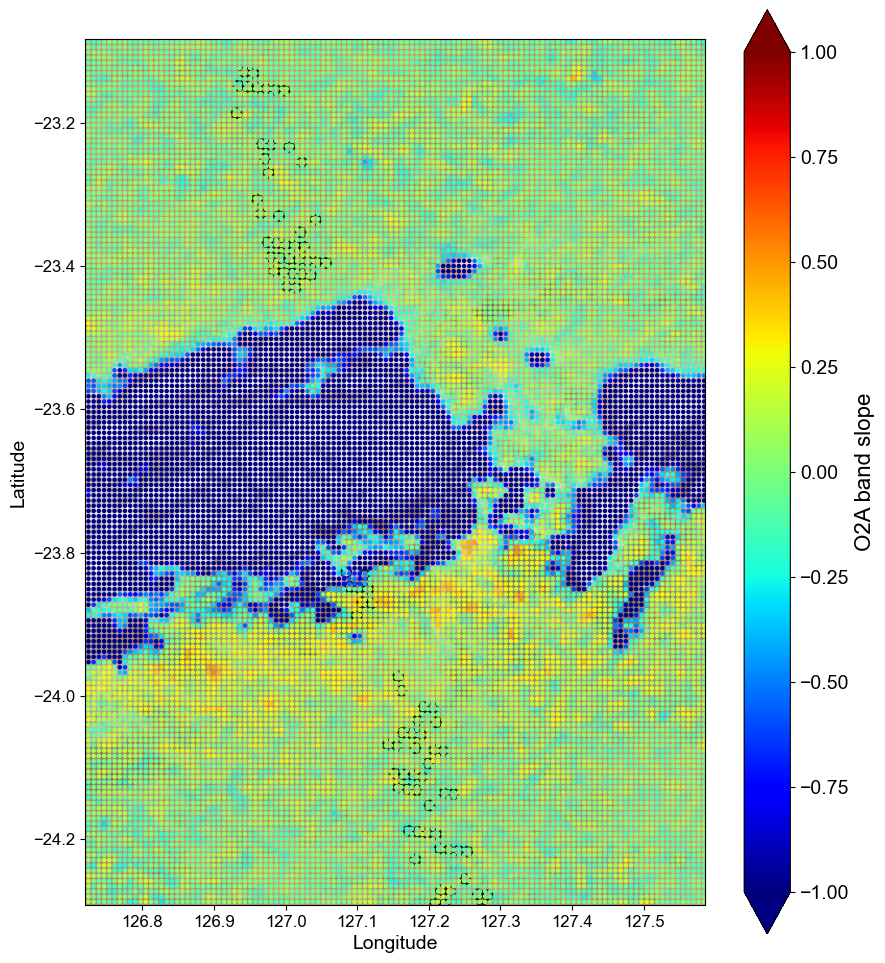

In [116]:
f,ax=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
ax.imshow(img,extent=wesn, alpha=0.6)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = (o1.co2.flatten()*1e6)>408
ax.scatter(o1.lon.flatten()[mask], o1.lat.flatten()[mask],
              s=50,
              marker='o', facecolor='none', edgecolors='k', linewidths=1.5, alpha=0.8)

"""for i in range(8):
    snd = select_snd[i]
    info = compare[compare.snd==snd]
    lon_tmp, lat_tmp = copy.copy(info.lon), copy.copy(info.lat)
    if i in [0, 1, 2, 3]:
        lon_tmp = lon_tmp-0.012
        lat_tmp = lat_tmp-0.03
    elif i in [4, 5]:
        lon_tmp = lon_tmp+0.007
        lat_tmp = lat_tmp-0.015
    elif i in [6, 7]:
        lon_tmp = lon_tmp+0.016
        lat_tmp = lat_tmp+0.022
    ax.scatter(lon_tmp, lat_tmp,
              s=50,
              marker='o', facecolor='none', 
              edgecolors='r', linewidths=1.5,)
    del lon_tmp, lat_tmp"""
#"""
cc = ax.scatter(o1.lon_all, o1.lat_all, 
              s=5,
              marker='o', c=o1.slope_1km_all[:,:,0], cmap='jet',
              vmin=-1, vmax=1)

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             ax, 'r')
cbar = f.colorbar(cc, extend='both')
cbar.set_label('O2A band slope', fontsize=16)
cbar.ax.tick_params(labelsize=14)

ax.set_xlabel('Longitude', fontsize=14)
ax.set_ylabel('Latitude', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=12)

plt.show()

(552,) (69, 8)


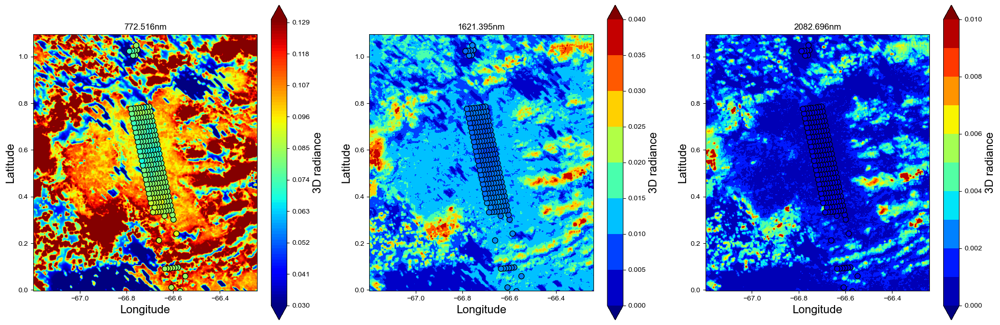

In [40]:


f, (ax1, ax2, ax3)=plt.subplots(1, 3, figsize=(24, 8))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
for ax in (ax1, ax2, ax3):
    ax.imshow(img,extent=wesn)
    ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax.set_ylim(np.min(lat_dom), np.max(lat_dom))
    ax.set_xlabel('Longitude', fontsize=16)
    ax.set_ylabel('Latitude', fontsize=16)
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o1.lon.shape)



# ax1

vmax = 0.13
vmin = 0.03
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax

l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])
cc1 = ax1.contourf(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
mask = (o1.co2.flatten()*1e6)>0
ax1.scatter(np.array(l1b_lon)[mask], np.array(l1b_lat)[mask],
              c=np.array(l1b_continuum)[mask],
              s=60,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar1 = f.colorbar(cc1, ax=ax1)#, extend='both')
cbar1.set_label('3D radiance', fontsize=16)
ax1.set_title(f'{o1.lam[10]:.3f}nm')



# ax2

vmax = 0.04
vmin = 0.0
lev = np.arange(vmin, vmax+1e-7, 0.005)
rad_to_plot = o2.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax

l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o2.lon.shape[0]):
    for j in range(o2.lon.shape[1]):
        l1b_lon.append(o2.lon[i, j])
        l1b_lat.append(o2.lat[i, j])
        l1b_continuum.append(o2.l1b[i, j, np.argmin(np.abs(o2.wvl[i, j, :]-o2.lam[10]))])
cc2 = ax2.contourf(o2.lon2d, o2.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
mask = (o2.co2.flatten()*1e6)>0
ax2.scatter(np.array(l1b_lon)[mask], np.array(l1b_lat)[mask],
              c=np.array(l1b_continuum)[mask],
              s=60,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar2 = f.colorbar(cc2, ax=ax2)#, extend='both')
cbar2.set_label('3D radiance', fontsize=16)
ax2.set_title(f'{o2.lam[10]:.3f}nm')


# ax3

vmax = 0.01
vmin = 0.00
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o3.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax

l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o3.lon.shape[1]):
        l1b_lon.append(o3.lon[i, j])
        l1b_lat.append(o3.lat[i, j])
        l1b_continuum.append(o3.l1b[i, j, np.argmin(np.abs(o3.wvl[i, j, :]-o3.lam[10]))])
cc3 = ax3.contourf(o3.lon2d, o3.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
mask = (o3.co2.flatten()*1e6)>0
ax3.scatter(np.array(l1b_lon)[mask], np.array(l1b_lat)[mask],
              c=np.array(l1b_continuum)[mask],
              s=60,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar3 = f.colorbar(cc3, ax=ax3)#, extend='both')
cbar3.set_label('3D radiance', fontsize=16)
ax3.set_title(f'{o3.lam[10]:.3f}nm')



plt.show()

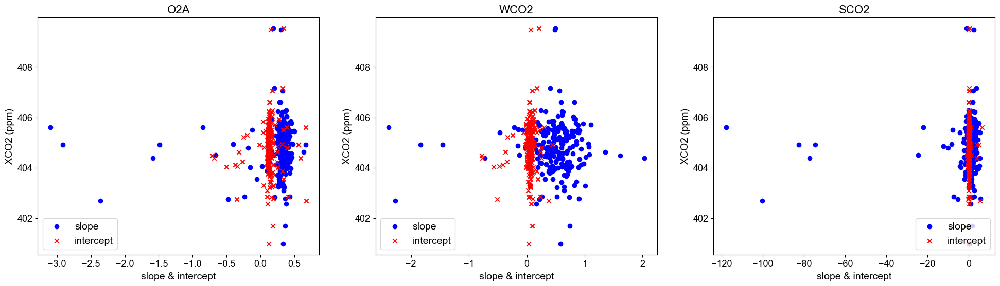

In [41]:
title_size = 16
label_size = 14
legend_size = 14
tick_size = 13
f, (ax1, ax2, ax3)=plt.subplots(1, 3, figsize=(24, 6))

ax1.scatter(o1.slope_1km[:,:,0].flatten(), o1.co2.flatten()*1e6, marker='o', color='b', label='slope')
ax1.scatter(o1.inter_1km[:,:,0].flatten(), o1.co2.flatten()*1e6, marker='x', color='r', label='intercept')
ax1.set_title('O2A', fontsize=title_size)
ax2.scatter(o2.slope_1km[:,:,0].flatten(), o2.co2.flatten()*1e6, marker='o', color='b', label='slope')
ax2.scatter(o2.inter_1km[:,:,0].flatten(), o2.co2.flatten()*1e6, marker='x', color='r', label='intercept')
ax2.set_title('WCO2', fontsize=title_size)
ax3.scatter(o3.slope_1km[:,:,0].flatten(), o3.co2.flatten()*1e6, marker='o', color='b', label='slope')
ax3.scatter(o3.inter_1km[:,:,0].flatten(), o3.co2.flatten()*1e6, marker='x', color='r', label='intercept')
ax3.set_title('SCO2', fontsize=title_size)

ax1.legend(loc='lower left', fontsize=legend_size)
ax2.legend(loc='lower left', fontsize=legend_size)
ax3.legend(loc='lower right', fontsize=legend_size)
for ax in (ax1, ax2, ax3):
    ax.set_xlabel('slope & intercept', fontsize=label_size)
    ax.set_ylabel('XCO2 (ppm)', fontsize=label_size)
    ax.tick_params(axis='both', which='major', labelsize=tick_size)
    #ax.legend(fontsize=legend_size)

plt.show()

In [37]:
l1b_lon_o2a, l1b_lat_o2a, l1b_continuum_o2a = o1.lon.copy(), o1.lat.copy(), np.zeros_like(o1.lat)
l1b_lon_wco2, l1b_lat_wco2, l1b_continuum_wco2 = o2.lon.copy(), o2.lat.copy(), np.zeros_like(o2.lat)
l1b_lon_sco2, l1b_lat_sco2, l1b_continuum_sco2 = o3.lon.copy(), o3.lat.copy(), np.zeros_like(o3.lat)
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_continuum_o2a[i, j] = o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))]
        l1b_continuum_wco2[i, j] = o2.l1b[i, j, np.argmin(np.abs(o2.wvl[i, j, :]-o2.lam[10]))]
        l1b_continuum_sco2[i, j] = o3.l1b[i, j, np.argmin(np.abs(o3.wvl[i, j, :]-o3.lam[10]))]

mask = (o1.co2.flatten()*1e6)>408  

lon_lat_move_list_o2a, lon_lat_move_list_wco2, lon_lat_move_list_sco2 = [], [], []

for i in range(o1.lon.shape[0]):
    lon_array = np.array(l1b_lon_o2a)[i, :]
    lat_array = np.array(l1b_lat_o2a)[i, :]
    l1b_array_o2a = np.array(l1b_continuum_o2a)[i, :]
    l1b_array_wco2 = np.array(l1b_continuum_wco2)[i, :]
    l1b_array_sco2 = np.array(l1b_continuum_sco2)[i, :]
    
    lon_1d = o1.lon2d[:, 0]
    lat_1d = o1.lat2d[0, :]
    indices_x, indices_y = [], []
    for j in range(8):
        indices_x.append(np.argmin(np.abs(lon_array[j]-lon_1d)))
        indices_y.append(np.argmin(np.abs(lat_array[j]-lat_1d)))
    #indices_x = np.int_(np.round((lon_array-lon_1d[0])/(((lon_1d[1:]-lon_1d[:-1])).mean()), decimals=0))
    #indices_y = np.int_(np.round((lat_array-lat_1d[0])/(((lat_1d[1:]-lat_1d[:-1])).mean()), decimals=0))

    o2a_err_sqrt_init = np.sqrt(np.sum((l1b_array_o2a-o1.rad_c3d[indices_x,indices_y,10])**2))
    o2a_err_sqrt = o2a_err_sqrt_init.copy()
    wco2_err_sqrt_init = np.sqrt(np.sum((l1b_array_wco2-o2.rad_c3d[indices_x,indices_y,10])**2))
    wco2_err_sqrt = wco2_err_sqrt_init.copy()
    sco2_err_sqrt_init = np.sqrt(np.sum((l1b_array_sco2-o3.rad_c3d[indices_x,indices_y,10])**2))
    sco2_err_sqrt = sco2_err_sqrt_init.copy()
    lon_move_final_o2a, lat_move_final_o2a = 0, 0
    lon_move_final_wco2, lat_move_final_wco2 = 0, 0
    lon_move_final_sco2, lat_move_final_sco2 = 0, 0
    for lon_move in np.linspace(-0.025, 0.025, num=51):
        for lat_move in np.linspace(-0.025, 0.025, num=51):
            try:
                indices_x_new = np.int_(np.round((lon_array+lon_move-lon_1d[0])/(((lon_1d[1:]-lon_1d[:-1])).mean()), decimals=0))
                indices_y_new = np.int_(np.round((lat_array+lat_move-lat_1d[0])/(((lat_1d[1:]-lat_1d[:-1])).mean()), decimals=0))


                temp_o2a = np.sqrt(np.sum((l1b_array_o2a-o1.rad_c3d[indices_x_new,indices_y_new,10])**2))
                temp_wco2 = np.sqrt(np.sum((l1b_array_wco2-o2.rad_c3d[indices_x_new,indices_y_new,10])**2))
                temp_sco2 = np.sqrt(np.sum((l1b_array_sco2-o3.rad_c3d[indices_x_new,indices_y_new,10])**2))
                if temp_o2a < o2a_err_sqrt:
                    o2a_err_sqrt = temp_o2a
                    lon_move_final_o2a, lat_move_final_o2a = lon_move, lat_move
                if temp_wco2 < wco2_err_sqrt:
                    wco2_err_sqrt = temp_wco2
                    lon_move_final_wco2, lat_move_final_wco2 = lon_move, lat_move
                if temp_sco2 < sco2_err_sqrt:
                    sco2_err_sqrt = temp_sco2
                    lon_move_final_sco2, lat_move_final_sco2 = lon_move, lat_move
            except:
                None
    lon_lat_move_list_o2a.append([np.round(lon_move_final_o2a, 3), np.round(lat_move_final_o2a, 3)])
    lon_lat_move_list_wco2.append([np.round(lon_move_final_wco2, 3), np.round(lat_move_final_wco2, 3)])
    lon_lat_move_list_sco2.append([np.round(lon_move_final_sco2, 3), np.round(lat_move_final_sco2, 3)])
    print('-'*15)
    print(i)
    print(lon_move_final_o2a, lat_move_final_o2a, o2a_err_sqrt_init, o2a_err_sqrt) 
    print(lon_move_final_wco2, lat_move_final_wco2, wco2_err_sqrt_init, wco2_err_sqrt) 
    print(lon_move_final_sco2, lat_move_final_sco2, sco2_err_sqrt_init, sco2_err_sqrt) 

---------------
0
-0.0010000000000000009 -0.0030000000000000027 0.007945597953285595 0.005047285909956502
0.010000000000000002 0.013999999999999999 0.0027064973388830687 0.0014145159307831843
0.0010000000000000009 0.009000000000000001 0.0013975869533537557 0.0008932556477847754
---------------
1
-0.0010000000000000009 0.002999999999999999 0.00440401636707596 0.0038745674444495724
0.008 -0.0020000000000000018 0.001912800391425269 0.0013999112047272076
-0.0030000000000000027 -0.008 0.0015138686909068847 0.0007288013838534691
---------------
2
0.0010000000000000009 0.002999999999999999 0.006593787206627683 0.003938939456013986
-0.0010000000000000009 0.0019999999999999983 0.0015725705436461961 0.0007024477258115655
-0.009000000000000001 -0.006999999999999999 0.001451362252993018 0.0008238363170199414
---------------
3
0.0010000000000000009 -0.0010000000000000009 0.008889737927155902 0.006136309992425993
-0.0010000000000000009 0.0 0.0019450655826885007 0.0013052363210198253
0.00499999999999

---------------
33
0.022 -0.006999999999999999 0.05031965610941762 0.020326258678594396
0.020999999999999998 -0.006999999999999999 0.01370439641957689 0.007681371776141489
0.0049999999999999975 -0.02 0.00433248380790653 0.0016172472593230576
---------------
34
-0.021 0.016 0.04260934469620745 0.011432287714470465
-0.021 0.015 0.015573316144364477 0.003443238600273483
-0.023 0.011000000000000003 0.004966981942450779 0.000979091805351159
---------------
35
-0.021 0.024 0.06912605013333996 0.030263687181723037
-0.021 0.022 0.015376817802692361 0.004077648717217235
-0.011000000000000001 0.022 0.0033245503063691773 0.0009073514102336293
---------------
36
0.023 0.024 0.1058501578076348 0.05306372773474057
-0.006999999999999999 0.020999999999999998 0.019609578577231463 0.006791947706331885
0.0010000000000000009 0.024 0.003562680591705372 0.0014158990644028483
---------------
37
0.025 0.019999999999999997 0.10394534842212198 0.06271978842958503
0.024 0.022 0.013185519775175875 0.0040493818933

---------------
69
-0.0010000000000000009 0.0 0.0031378764146473086 0.002952648660299987
-0.0010000000000000009 0.004 0.0016584677866618353 0.0007791956224762721
0.016 0.012999999999999998 0.001800429193758192 0.0007033753835111639
---------------
70
0.0 -0.009000000000000001 0.005619404236565003 0.003746898557103446
0.0019999999999999983 0.0019999999999999983 0.0023169208830110246 0.0014447122572859292
-0.004 0.0 0.0019698933458463692 0.001531574306884449
---------------
71
0.0010000000000000009 -0.0020000000000000018 0.005011746405819434 0.0033480151772795792
0.002999999999999999 -0.0020000000000000018 0.0016556112201221854 0.0008278793476325976
-0.0010000000000000009 -0.012 0.001868636966959786 0.0013566953749647285
---------------
72
-0.0020000000000000018 -0.0020000000000000018 0.004821454107873752 0.0028780697897292738
-0.009000000000000001 -0.006000000000000002 0.0022794446021153765 0.0010798528522310315
-0.0020000000000000018 -0.012 0.0021079695311560093 0.0010502759288118888
-

(600,) (75, 8)


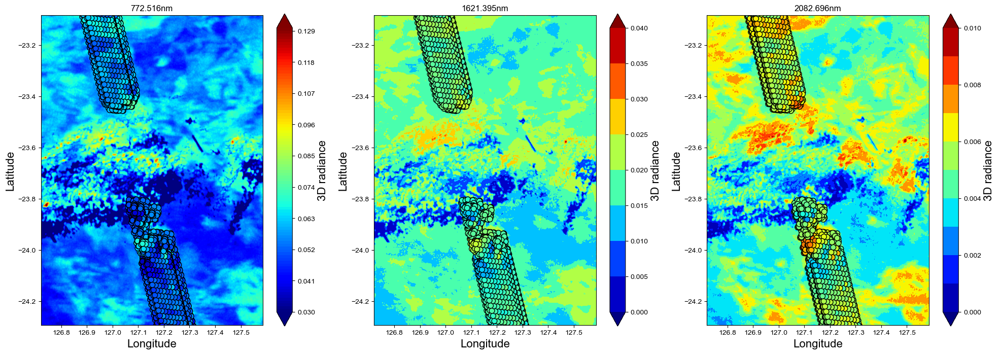

In [38]:


f, (ax1, ax2, ax3)=plt.subplots(1, 3, figsize=(24, 8))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
for ax in (ax1, ax2, ax3):
    ax.imshow(img,extent=wesn)
    ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
    ax.set_ylim(np.min(lat_dom), np.max(lat_dom))
    ax.set_xlabel('Longitude', fontsize=16)
    ax.set_ylabel('Latitude', fontsize=16)
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o1.lon.shape)



# ax1

vmax = 0.13
vmin = 0.03
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax

l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])
cc1 = ax1.contourf(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
mask = (o1.co2.flatten()*1e6)>0

for i in range(o1.lon.shape[0]):
    ax1.scatter(np.array(l1b_lon)[mask]+lon_lat_move_list_o2a[i][0], 
                np.array(l1b_lat)[mask]+lon_lat_move_list_o2a[i][1],
                  c=np.array(l1b_continuum)[mask],
                  s=60,
                  cmap='jet',
                  vmin=vmin, vmax=vmax,
                  marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar1 = f.colorbar(cc1, ax=ax1)#, extend='both')
cbar1.set_label('3D radiance', fontsize=16)
ax1.set_title(f'{o1.lam[10]:.3f}nm')



# ax2

vmax = 0.04
vmin = 0.0
lev = np.arange(vmin, vmax+1e-7, 0.005)
rad_to_plot = o2.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax

l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o2.lon.shape[0]):
    for j in range(o2.lon.shape[1]):
        l1b_lon.append(o2.lon[i, j])
        l1b_lat.append(o2.lat[i, j])
        l1b_continuum.append(o2.l1b[i, j, np.argmin(np.abs(o2.wvl[i, j, :]-o2.lam[10]))])
cc2 = ax2.contourf(o2.lon2d, o2.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
mask = (o2.co2.flatten()*1e6)>0
for i in range(o1.lon.shape[0]):
    ax2.scatter(np.array(l1b_lon)[mask]+lon_lat_move_list_wco2[i][0], 
                np.array(l1b_lat)[mask]+lon_lat_move_list_wco2[i][1],
              c=np.array(l1b_continuum)[mask],
              s=60,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar2 = f.colorbar(cc2, ax=ax2)#, extend='both')
cbar2.set_label('3D radiance', fontsize=16)
ax2.set_title(f'{o2.lam[10]:.3f}nm')


# ax3

vmax = 0.01
vmin = 0.00
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o3.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax

l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o3.lon.shape[1]):
        l1b_lon.append(o3.lon[i, j])
        l1b_lat.append(o3.lat[i, j])
        l1b_continuum.append(o3.l1b[i, j, np.argmin(np.abs(o3.wvl[i, j, :]-o3.lam[10]))])
cc3 = ax3.contourf(o3.lon2d, o3.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
mask = (o3.co2.flatten()*1e6)>0
for i in range(o1.lon.shape[0]):
    ax3.scatter(np.array(l1b_lon)[mask]+lon_lat_move_list_sco2[i][0], 
                np.array(l1b_lat)[mask]+lon_lat_move_list_sco2[i][1],
              c=np.array(l1b_continuum)[mask],
              s=60,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar3 = f.colorbar(cc3, ax=ax3)#, extend='both')
cbar3.set_label('3D radiance', fontsize=16)
ax3.set_title(f'{o3.lam[10]:.3f}nm')



plt.show()

In [39]:
o2a_slope, o2a_inter = np.zeros_like(o1.lon), np.zeros_like(o1.lon)
wco2_slope, wco2_inter = np.zeros_like(o1.lon), np.zeros_like(o1.lon)
sco2_slope, sco2_inter = np.zeros_like(o1.lon), np.zeros_like(o1.lon)
lon_all_1d = np.array(o1.lon_all).reshape(o1.slope_1km_all.shape[:2])[:, 0]
lat_all_1d = np.array(o1.lat_all).reshape(o1.slope_1km_all.shape[:2])[0, :]
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        lon_ind = np.argmin(np.abs(lon_all_1d-(o1.lon[i, j]+lon_lat_move_list_o2a[i][0])))
        lat_ind = np.argmin(np.abs(lat_all_1d-(o1.lat[i, j]+lon_lat_move_list_o2a[i][1])))
        o2a_slope[i, j] = o1.slope_1km_all[lon_ind, lat_ind, 0]
        o2a_inter[i, j] = o1.inter_1km_all[lon_ind, lat_ind, 0]
        wco2_slope[i, j] = o2.slope_1km_all[lon_ind, lat_ind, 0]
        wco2_inter[i, j] = o2.inter_1km_all[lon_ind, lat_ind, 0]
        sco2_slope[i, j] = o3.slope_1km_all[lon_ind, lat_ind, 0]
        sco2_inter[i, j] = o3.inter_1km_all[lon_ind, lat_ind, 0]
        
    

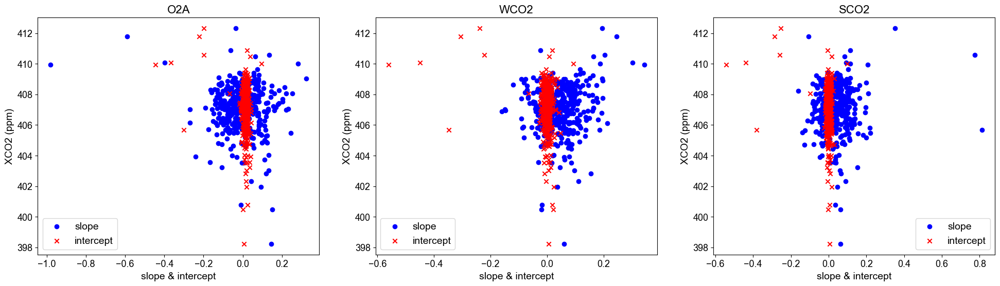

In [40]:
title_size = 16
label_size = 14
legend_size = 14
tick_size = 13
f, (ax1, ax2, ax3)=plt.subplots(1, 3, figsize=(24, 6))

ax1.scatter(o2a_slope.flatten(), o1.co2.flatten()*1e6, marker='o', color='b', label='slope')
ax1.scatter(o2a_inter.flatten(), o1.co2.flatten()*1e6, marker='x', color='r', label='intercept')
ax1.set_title('O2A', fontsize=title_size)
ax2.scatter(wco2_slope.flatten(), o2.co2.flatten()*1e6, marker='o', color='b', label='slope')
ax2.scatter(wco2_inter.flatten(), o2.co2.flatten()*1e6, marker='x', color='r', label='intercept')
ax2.set_title('WCO2', fontsize=title_size)
ax3.scatter(sco2_slope.flatten(), o3.co2.flatten()*1e6, marker='o', color='b', label='slope')
ax3.scatter(sco2_inter.flatten(), o3.co2.flatten()*1e6, marker='x', color='r', label='intercept')
ax3.set_title('SCO2', fontsize=title_size)

ax1.legend(loc='lower left', fontsize=legend_size)
ax2.legend(loc='lower left', fontsize=legend_size)
ax3.legend(loc='lower right', fontsize=legend_size)
for ax in (ax1, ax2, ax3):
    ax.set_xlabel('slope & intercept', fontsize=label_size)
    ax.set_ylabel('XCO2 (ppm)', fontsize=label_size)
    ax.tick_params(axis='both', which='major', labelsize=tick_size)
    

plt.show()

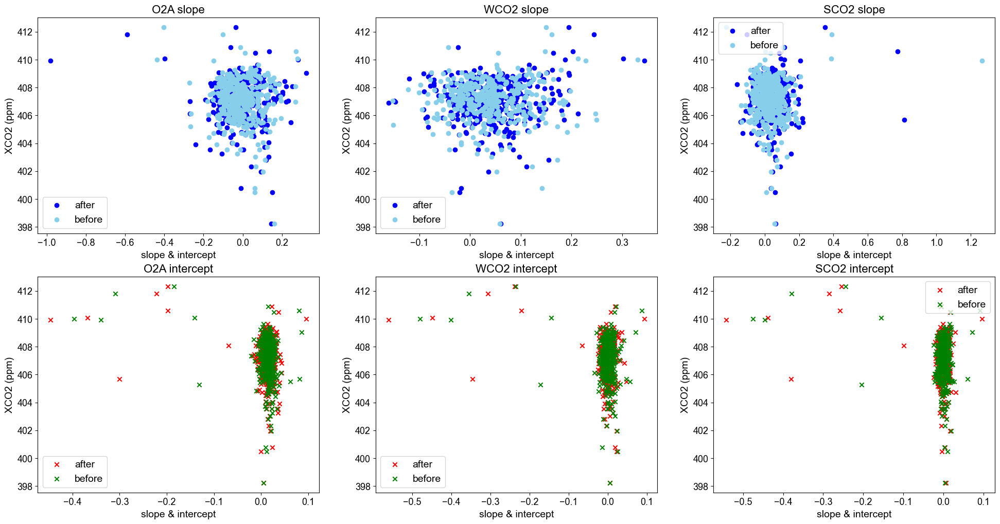

In [41]:
title_size = 16
label_size = 14
legend_size = 14
tick_size = 13
f, ((ax1, ax2, ax3), (ax4, ax5, ax6))=plt.subplots(2, 3, figsize=(24, 12))

ax1.scatter(o2a_slope.flatten(), o1.co2.flatten()*1e6, marker='o', color='b', label='after')
ax1.scatter(o1.slope_1km[:,:,0].flatten(), o1.co2.flatten()*1e6, marker='o', color='skyblue', label='before')
ax1.set_title('O2A slope', fontsize=title_size)
ax2.scatter(wco2_slope.flatten(), o2.co2.flatten()*1e6, marker='o', color='b', label='after')
ax2.scatter(o2.slope_1km[:,:,0].flatten(), o2.co2.flatten()*1e6, marker='o', color='skyblue', label='before')
ax2.set_title('WCO2 slope', fontsize=title_size)
ax3.scatter(sco2_slope.flatten(), o3.co2.flatten()*1e6, marker='o', color='b', label='after')
ax3.scatter(o3.slope_1km[:,:,0].flatten(), o3.co2.flatten()*1e6, marker='o', color='skyblue', label='before')
ax3.set_title('SCO2 slope', fontsize=title_size)

ax4.scatter(o2a_inter.flatten(), o1.co2.flatten()*1e6, marker='x', color='r', label='after')
ax4.scatter(o1.inter_1km[:,:,0].flatten(), o1.co2.flatten()*1e6, marker='x', color='green', label='before')
ax4.set_title('O2A intercept', fontsize=title_size)
ax5.scatter(wco2_inter.flatten(), o2.co2.flatten()*1e6, marker='x', color='r', label='after')
ax5.scatter(o2.inter_1km[:,:,0].flatten(), o2.co2.flatten()*1e6, marker='x', color='green', label='before')
ax5.set_title('WCO2 intercept', fontsize=title_size)
ax6.scatter(sco2_inter.flatten(), o3.co2.flatten()*1e6, marker='x', color='r', label='after')
ax6.scatter(o3.inter_1km[:,:,0].flatten(), o3.co2.flatten()*1e6, marker='x', color='green', label='before')
ax6.set_title('SCO2 intercept', fontsize=title_size)


ax1.legend(loc='lower left', fontsize=legend_size)
ax2.legend(loc='lower left', fontsize=legend_size)
ax3.legend(loc='upper left', fontsize=legend_size)
ax4.legend(loc='lower left', fontsize=legend_size)
ax5.legend(loc='lower left', fontsize=legend_size)
ax6.legend(loc='upper right', fontsize=legend_size)
for ax in (ax1, ax2, ax3, ax4, ax5, ax6):
    ax.set_xlabel('slope & intercept', fontsize=label_size)
    ax.set_ylabel('XCO2 (ppm)', fontsize=label_size)
    ax.tick_params(axis='both', which='major', labelsize=tick_size)
    

plt.show()

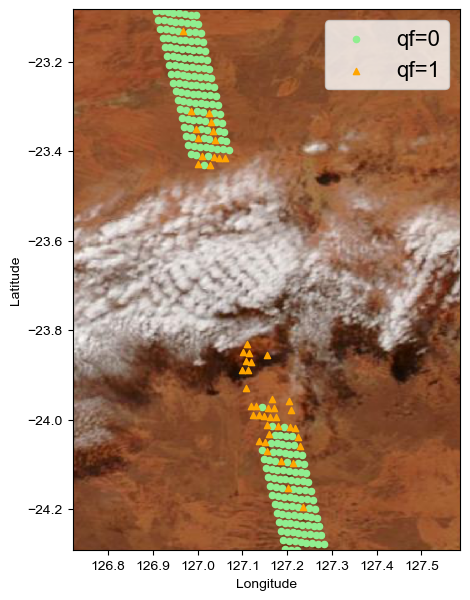

In [66]:
f,frame=plt.subplots(figsize=(5, 20))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
frame.scatter(qf_lon.flatten()[qf_array[:, :, 0].flatten()==0], qf_lat.flatten()[qf_array[:, :, 0].flatten()==0], s=20,
              marker='o', color='lightgreen', label='qf=0')
frame.scatter(qf_lon.flatten()[qf_array[:, :, 0].flatten()==1], qf_lat.flatten()[qf_array[:, :, 0].flatten()==1], s=20,
              marker='^', color='orange', label='qf=1')

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

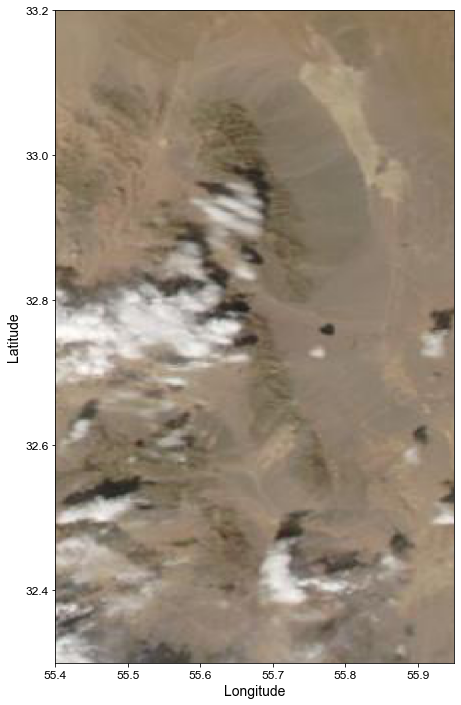

In [37]:
f,ax=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
ax.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = (o1.co2.flatten()*1e6)>407.7


ax.set_xlabel('Longitude', fontsize=14)
ax.set_ylabel('Latitude', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=12)
#ax.tick_params(axis='both', which='minor', labelsize=8)
plt.show()

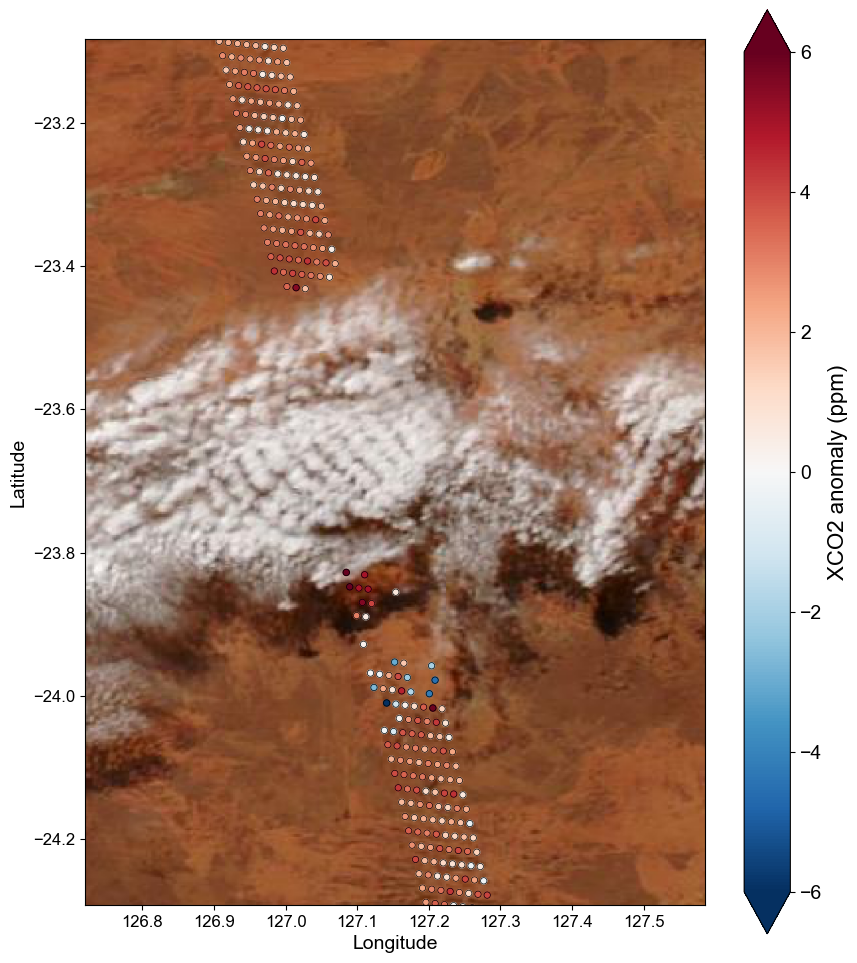

In [69]:
f,ax=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
ax.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = (o1.co2.flatten()*1e6)>0

cc = ax.scatter(o1.lon.flatten(), o1.lat.flatten(),
                   s=20,
                   marker='o', c=o1.co2.flatten()*1e6-405, cmap='RdBu_r',
                    vmin=-6, vmax=6)
ax.scatter(o1.lon.flatten()[mask], o1.lat.flatten()[mask],
              s=21,
              marker='o', facecolor='none', edgecolors='k', linewidths=0.5)
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             ax, 'r')
cbar = f.colorbar(cc, extend='both')
cbar.set_label('XCO2 anomaly (ppm)', fontsize=16)
cbar.ax.tick_params(labelsize=14)

#plt.legend(fontsize=16, facecolor='white')
ax.set_xlabel('Longitude', fontsize=14)
ax.set_ylabel('Latitude', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=12)
#ax.tick_params(axis='both', which='minor', labelsize=8)
plt.show()

In [35]:
np.where(o1.snd.flatten()==select_snd[0])[0][0]

NameError: name 'select_snd' is not defined

NameError: name 'select_snd' is not defined

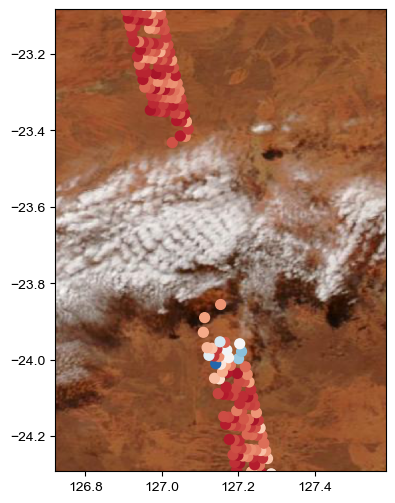

In [71]:
f,ax=plt.subplots(figsize=(5, 6))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
ax.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = (o1.co2.flatten()*1e6)>408

cc = ax.scatter(o1.lon.flatten()[~mask], o1.lat.flatten()[~mask],
              s=50,
              marker='o', c=(o1.co2.flatten()*1e6)[~mask]-403,
              cmap='RdBu_r', vmin=-6, vmax=6)
"""
for i in range(8):
    snd = select_snd[i]
    info = compare[compare.snd==snd]
    lon_tmp, lat_tmp = (o1.lon.flatten()[np.where(o1.snd.flatten()==select_snd[i])[0][0]],
                        o1.lat.flatten()[np.where(o1.snd.flatten()==select_snd[i])[0][0]])
    #if i in [0, 1, 2, 3]:
    #    lon_tmp += -0.012
    #    lat_tmp += -0.03
    #elif i in [4, 5]:
    #    lon_tmp += 0.007
    #    lat_tmp += -0.015
    #elif i in [6, 7]:
    #    lon_tmp += 0.016
    #    lat_tmp += 0.022
    if i in [0, 1, 2, 3]:
        edge = 'r'
    elif i in [4, 5]:
        edge = 'g'
    elif i in [6, 7]:
        edge = 'b'
    ax.scatter(lon_tmp, lat_tmp,
              s=55,
              marker='o', c=(o1.co2.flatten()*1e6)[np.where(o1.snd.flatten()==select_snd[i])[0][0]]-403, 
              edgecolors=edge, linewidths=0.75,
              cmap='RdBu_r', vmin=-6, vmax=6)
mask = (o1.co2.flatten()*1e6)>407.7
select_snd = o1.snd.flatten()[mask]
#"""
#"""
for i in range(8):
    snd = select_snd[i]
    info = compare[compare.snd==snd]
    lon_tmp, lat_tmp = (o1.lon.flatten()[np.where(o1.snd.flatten()==select_snd[i])[0][0]],
                        o1.lat.flatten()[np.where(o1.snd.flatten()==select_snd[i])[0][0]])
    #if i in [0, 1, 2, 3]:
    #    lon_tmp += -0.012
    #    lat_tmp += -0.03
    #elif i in [4, 5]:
    #    lon_tmp += 0.007
    #    lat_tmp += -0.015
    #elif i in [6, 7]:
    #    lon_tmp += 0.016
    #    lat_tmp += 0.022
    if i in [0, 1, 2, 3]:
        edge = 'r'
    elif i in [4, 5]:
        edge = 'g'
    elif i in [6, 7]:
        edge = 'b'
    ax.scatter(lon_tmp, lat_tmp,
              s=55,
              marker='o', c=info['XCO2 [unperturbed]']-405, 
              edgecolors=edge, linewidths=0.75,
              cmap='RdBu_r', vmin=-6, vmax=6)
#"""


#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             ax, 'r')
cbar = f.colorbar(cc, extend='both')
cbar.set_label('XCO2 anomaly (ppm)', fontsize=16)
cbar.ax.tick_params(labelsize=14)

#plt.legend(fontsize=16, facecolor='white')
ax.set_xlabel('Longitude', fontsize=14)
ax.set_ylabel('Latitude', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=12)

plt.show()

In [326]:
dia = h5py.File('../simulation/data/oco/oco2_L1bScND_22646a_181004_B10003r_200409075522.h5', 'r')

In [336]:
dia_lon = dia['SoundingGeometry/sounding_longitude'][...]
dia_lon_geoid = dia['SoundingGeometry/sounding_longitude_geoid'][...]
dia_lat = dia['SoundingGeometry/sounding_latitude'][...]
dai_snd = dia['SoundingGeometry/sounding_id'][...]


In [57]:
h1_unpert = h5py.File('full-unperturb_20181018_45points_avg_perturbed.h5', "r")
h1_unmodified = h5py.File('full-unperturb_20181018_45points_avg_unmodified.h5', "r")
h5_snd = h1_unpert['snd'][...]
h5_lon = h1_unpert['lon'][...]
h5_lat = h1_unpert['lat'][...]
h1_o2a_inter = h1_unpert['pert_o2'][...][:, 0]
h1_o2a_slope = h1_unpert['pert_o2'][...][:, 1]
h1_wco2_inter = h1_unpert['pert_wco2'][...][:, 0]
h1_wco2_slope = h1_unpert['pert_wco2'][...][:, 1]
h1_sco2_inter = h1_unpert['pert_sco2'][...][:, 0]
h1_sco2_slope = h1_unpert['pert_sco2'][...][:, 1]

h5_xco2_retrieved_unpert = h1_unpert['xco2_retrieved'][...]
h5_xco2_L2_file_unpert = h1_unpert['xco2_L2_file'][...]
h5_xco2_retrieved_unmodified = h1_unmodified['xco2_retrieved'][...]
h5_xco2_L2_file_unmodified = h1_unmodified['xco2_L2_file'][...]


del_XCO2_unpert_minus_unmodified = h5_xco2_retrieved_unpert - h5_xco2_retrieved_unmodified
del_XCO2_unpert_minus_L2 = h5_xco2_retrieved_unpert - h5_xco2_L2_file_unpert

compare = pd.DataFrame(np.array([h5_snd, h5_lon, h5_lat,
                                 h1_o2a_slope, h1_o2a_inter,
                                 h1_wco2_slope, h1_wco2_inter,
                                 h1_sco2_slope, h1_sco2_inter,
                                 h5_xco2_retrieved_unpert, 
                                 h5_xco2_retrieved_unmodified, 
                                 h5_xco2_L2_file_unpert]).T,
                       columns=['snd', 'lon', 'lat',
                                'o2a slope', 'o2a intercept', 
                                'wco2 slope', 'wco2 intercept',
                                'sco2 slope', 'sco2 intercept',
                                'XCO2 [unperturbed]',
                                'XCO2 [unmodified]',
                                'XCO2 [L2]',])
compare

,snd,lon,lat,o2a slope,o2a intercept,wco2 slope,wco2 intercept,sco2 slope,sco2 intercept,XCO2 [unperturbed],XCO2 [unmodified],XCO2 [L2]
0,2.018102e+15,55.793259,32.335785,0.566609,0.046351,0.193208,0.052939,0.094452,0.042696,407.249209,-2.000000,408.184453
1,2.018102e+15,55.806389,32.330879,0.566609,0.046351,0.193208,0.052939,0.094452,0.042696,408.174620,-2.000000,408.262073
2,2.018102e+15,55.812843,32.334187,0.566609,0.046351,0.193208,0.052939,0.094452,0.042696,409.304278,-2.000000,409.758155
3,2.018102e+15,55.762775,32.450859,-4.398778,0.109042,-0.246010,-0.220787,-1.185949,-0.163536,-2.000000,-2.000000,410.856213
4,2.018102e+15,55.775902,32.445988,-4.398778,0.109042,-0.246010,-0.220787,-1.185949,-0.163536,-2.000000,-2.000000,410.325622
5,2.018102e+15,55.781868,32.437611,-4.398778,0.109042,-0.246010,-0.220787,-1.185949,-0.163536,-2.000000,409.229648,408.177177
6,2.018102e+15,55.745758,32.499245,-4.398778,0.109042,-0.246010,-0.220787,-1.185949,-0.163536,-2.000000,416.339723,412.793161
7,2.018102e+15,55.752068,32.491020,-4.398778,0.109042,-0.246010,-0.220787,-1.185949,-0.163536,-2.000000,410.882896,409.178436
8,2.018102e+15,55.764496,32.474369,-4.398778,0.109042,-0.246010,-0.220787,-1.185949,-0.163536,-2.000000,-2.000000,408.230640
9,2.018102e+15,55.770535,32.466057,-4.398778,0.109042,-0.246010,-0.220787,-1.185949,-0.163536,-2.000000,-2.000000,408.367429


In [152]:
mask = (o1.co2.flatten()*1e6)>408
select_snd = o1.snd.flatten()[mask]
mask_a = np.logical_or(o1.snd.flatten()==(select_snd[4]), o1.snd.flatten()==(select_snd[5]))
mask_b = np.logical_or(o1.snd.flatten()==(select_snd[6]), o1.snd.flatten()==(select_snd[7]))
mask_c = np.logical_or(np.logical_or(o1.snd.flatten()==(select_snd[0]), o1.snd.flatten()==(select_snd[1])),
                       np.logical_or(o1.snd.flatten()==(select_snd[2]), o1.snd.flatten()==(select_snd[3])))


In [55]:
from scipy.interpolate import RegularGridInterpolator

itp = RegularGridInterpolator((sorted(set(o1.lon_all)), sorted(set(o1.lat_all))),
                              (o1.inter_1km_all[:,:,0]), method='nearest') 
res = itp((56., 32.3))
res

array(1.03891024)

In [396]:
ddata = pd.DataFrame(np.array([o1.snd.flatten(),
                              o1.lon.flatten(),
                              o1.lat.flatten(),
                              o1.co2.flatten()*1e6,]).T,
                     columns=['SND', 'longitude', 'latitude', 'XCO2'],
                     )
ddata.to_csv('central_Asia_snd.txt', index=False)
                     

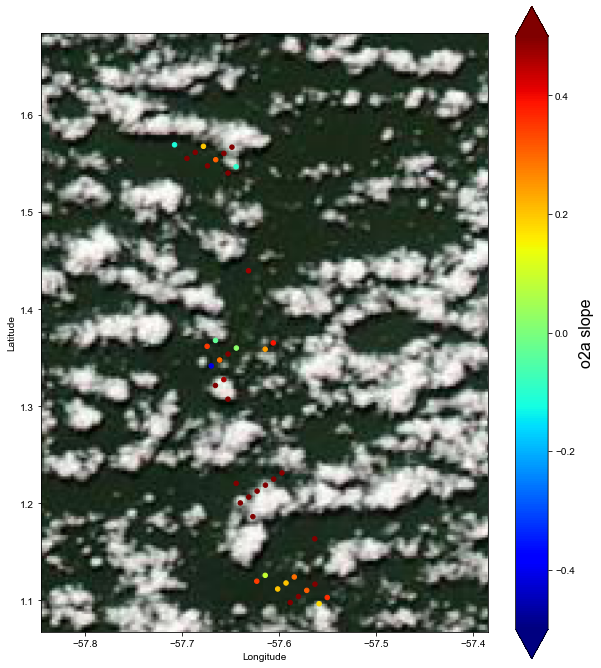

In [71]:
f,frame=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
cc = frame.scatter(o1.lon.flatten()[mask], o1.lat.flatten()[mask],
              s=20,
              marker='o', c=o1.slope_1km[:,:,0].flatten()[mask], cmap='jet',
              vmin=-0.5, vmax=0.5)

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, extend='both')
cbar.set_label('o2a slope', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

(256,) (32, 8)


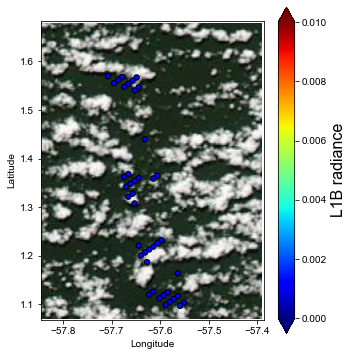

In [26]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o3.l1b[i, j, np.argmin(np.abs(o3.wvl[i, j, :]-o3.lam[10]))])

f,frame=plt.subplots(figsize=(5, 6))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
#mask = (o1.co2.flatten()*1e6)>407.7
print(mask.shape, o1.lon.shape)
vmin = 0.00
vmax = 0.01
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
#cc = frame.contourf(o1.lon2d, o1.lat2d, rad_to_plot, np.arange(0.02, vmax+0.005, 0.02), cmap='jet',
#                   vmin=0.02, vmax=vmax, extend='both')
cc = frame.scatter(o1.lon.flatten()[mask], o1.lat.flatten()[mask],
              c=np.array(l1b_continuum)[mask],
              s=30,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
mask = (o1.co2.flatten()*1e6)>407.7
frame.scatter(o1.lon.flatten()[mask], o1.lat.flatten()[mask],
              facecolors='none',
              s=30,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k', linewidths=2)
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, extend='both')
cbar.set_label('L1B radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

(-1.2, 0.3)

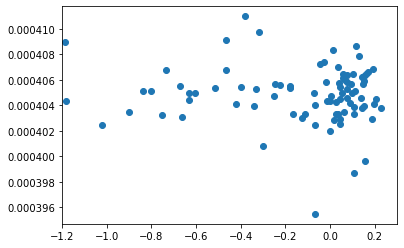

In [74]:
plt.scatter(o1.slope_1km[:,:,0].flatten(), o1.co2.flatten())
plt.xlim(-1.2,0.3)
#plt.colorbar()

In [167]:
o1.l1b.shape

(22, 8, 1016)

(496,) (62, 8)


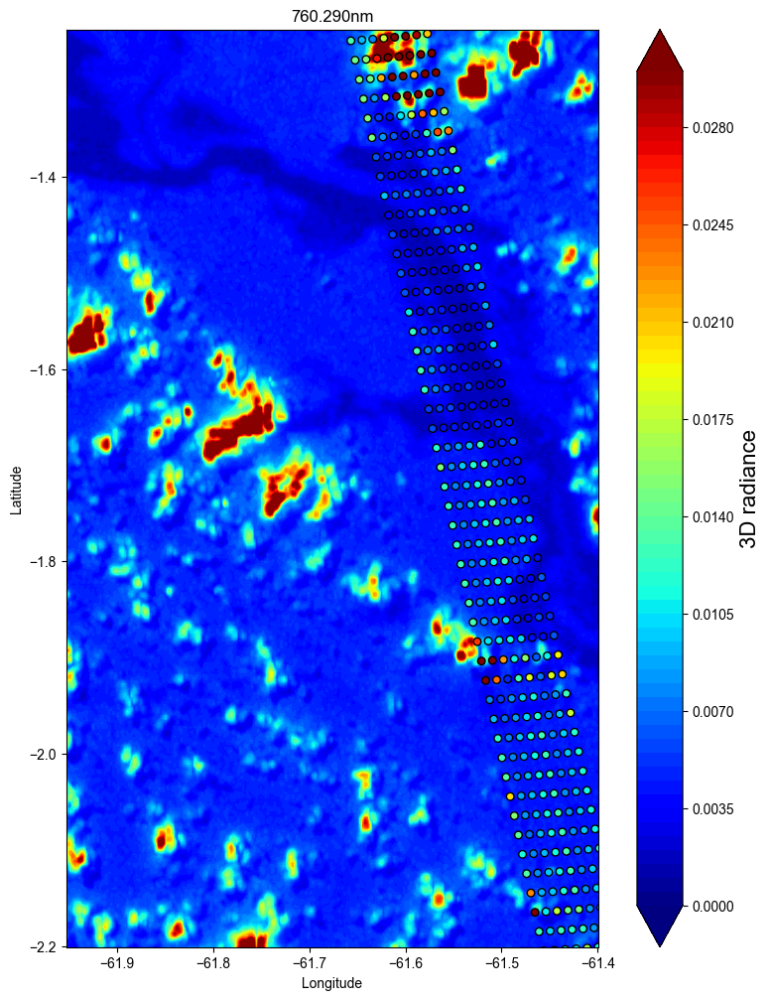

In [134]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[2]))])

f,frame=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o1.lon.shape)
vmax = 0.03
vmin = 0.0
lev = np.arange(vmin, vmax+1e-7, 0.0005)
rad_to_plot = o1.rad_c3d[:,:,2].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = frame.contourf(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both')
frame.scatter(np.array(l1b_lon), np.array(l1b_lat),
              c=np.array(l1b_continuum),
              s=30,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)#, extend='both')
cbar.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title(f'{o1.lam[2]:.3f}nm')

plt.show()

In [73]:
o1.lon.min()

-57.76729

In [38]:
png[1]

[-57.85, -57.39, 1.07, 1.68]

In [41]:
boundary_list

[[[-57.8453, -57.3853, 1.0676, 1.6843], 'r']]

In [42]:
print(lon_w, lon_e)

-57.8453 -57.3853


(496,) (62, 8)


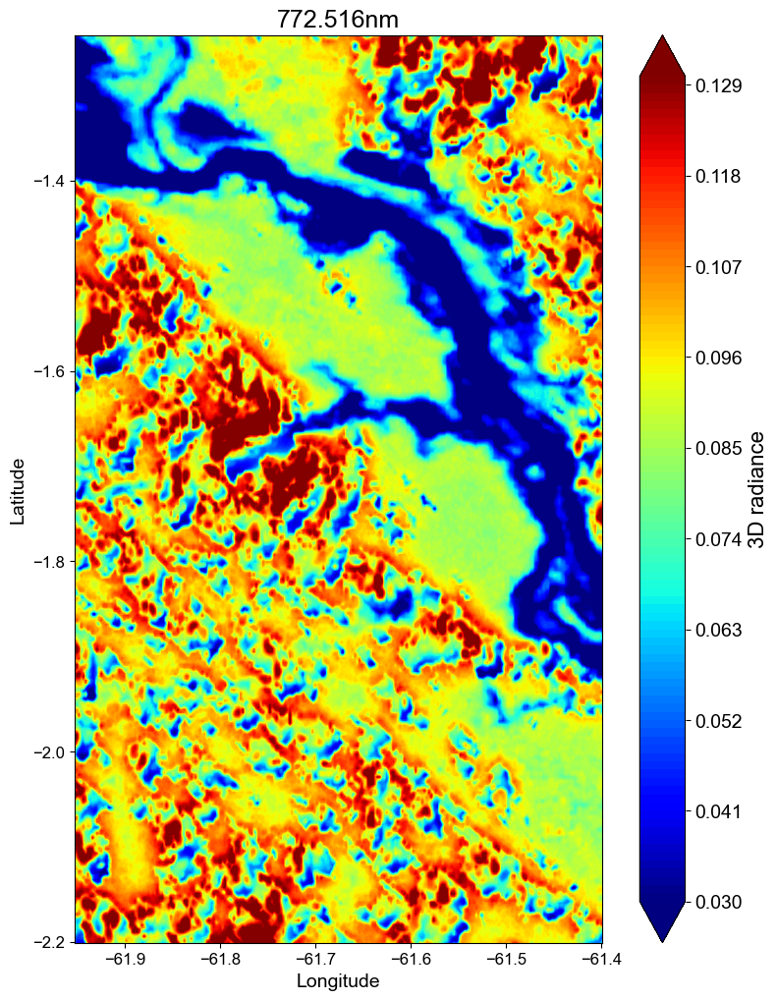

In [37]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])

f,ax=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
ax.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)

print(mask.shape, o1.lon.shape)
vmax = 0.13
vmin = 0.03
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = ax.contourf(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both')

cbar = f.colorbar(cc, extend='both')
cbar.set_label('3D radiance', fontsize=16)
cbar.ax.tick_params(labelsize=14)
ax.set_xlabel('Longitude', fontsize=14)
ax.set_ylabel('Latitude', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=12)


ax.set_title(f'{o1.lam[10]:.3f}nm', fontsize=18)

plt.show()

(496,) (62, 8)


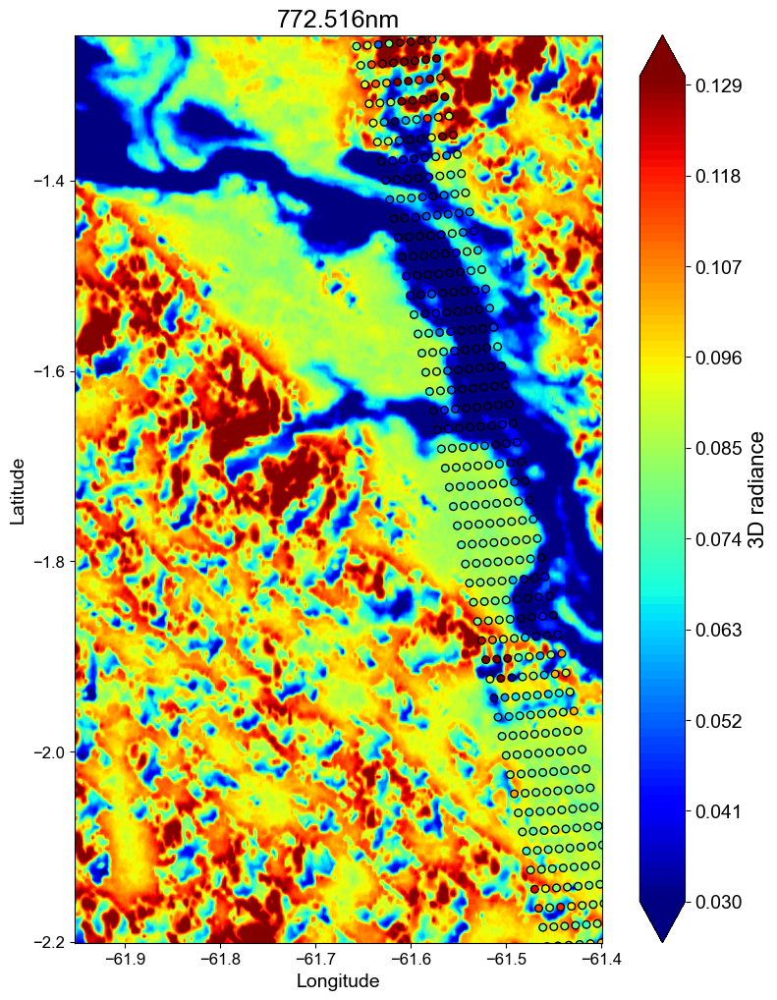

In [38]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])

f,ax=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
ax.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)

print(mask.shape, o1.lon.shape)
vmax = 0.13
vmin = 0.03
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = ax.contourf(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both')
ax.scatter(np.array(l1b_lon), np.array(l1b_lat),
              c=np.array(l1b_continuum),
              s=30,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
cbar = f.colorbar(cc, extend='both')
cbar.set_label('3D radiance', fontsize=16)
cbar.ax.tick_params(labelsize=14)
ax.set_xlabel('Longitude', fontsize=14)
ax.set_ylabel('Latitude', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=12)


ax.set_title(f'{o1.lam[10]:.3f}nm', fontsize=18)

plt.show()

(496,) (62, 8)


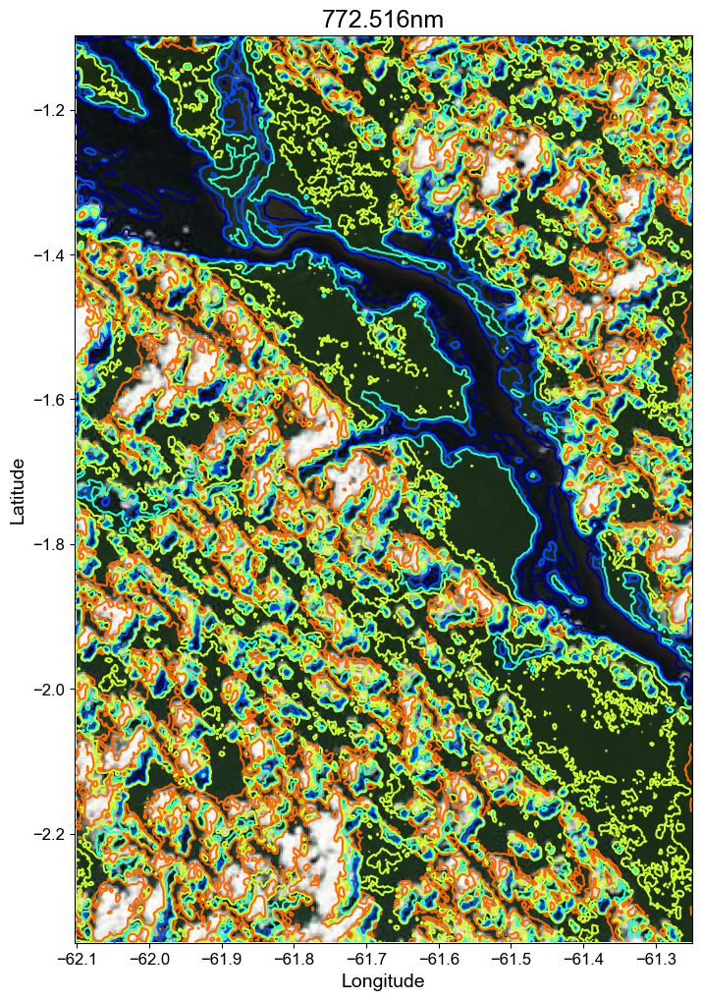

In [39]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])

f,ax=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
ax.imshow(img,extent=wesn)
lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]
ax.set_xlim(np.min(lon_dom), np.max(lon_dom))
ax.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)

print(mask.shape, o1.lon.shape)
vmax = 0.13
vmin = 0.03
lev = np.arange(vmin, vmax+1e-7, 0.02)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = ax.contour(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both')

#cbar = f.colorbar(cc, extend='both')
#cbar.set_label('3D radiance', fontsize=16)
#cbar.ax.tick_params(labelsize=14)
ax.set_xlabel('Longitude', fontsize=14)
ax.set_ylabel('Latitude', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=12)


ax.set_title(f'{o1.lam[10]:.3f}nm', fontsize=18)

plt.show()

(496,) (62, 8)


NameError: name 'l1b_860_lon_2d' is not defined

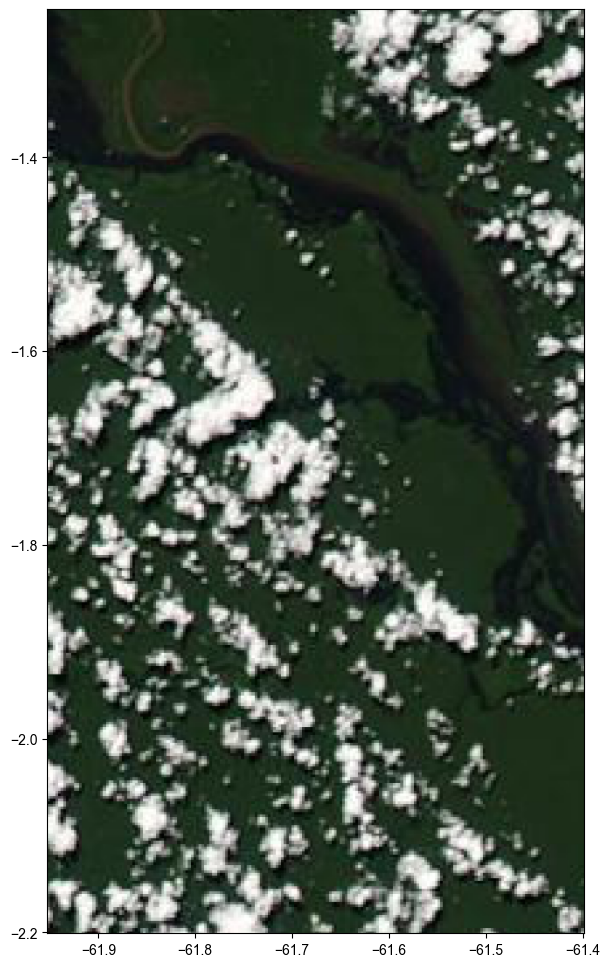

In [40]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])

f,frame=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
mask = (o1.co2.flatten()*1e6)>407.7
print(mask.shape, o1.lon.shape)
vmax = 0.13
vmin = 0.03
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = frame.contourf(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both')
"""
frame.scatter(np.array(l1b_lon)[mask], np.array(l1b_lat)[mask],
              c=np.array(l1b_continuum)[mask],
              s=30,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#"""
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)#, extend='both')
cbar.set_label('MODIS 860nm radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('MODIS 860nm radiance')

plt.show()

(256,) (32, 8)


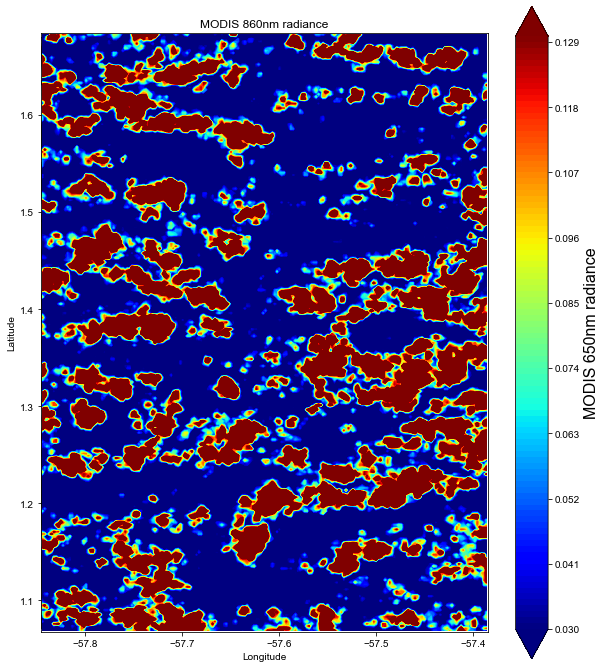

In [34]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])

f,frame=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
mask = (o1.co2.flatten()*1e6)>407.7
print(mask.shape, o1.lon.shape)
vmax = 0.13
vmin = 0.03
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = frame.contourf(l1b_650_lon_2d, l1b_650_lat_2d, rad_650_2d, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both')
"""
frame.scatter(np.array(l1b_lon)[mask], np.array(l1b_lat)[mask],
              c=np.array(l1b_continuum)[mask],
              s=30,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#"""
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)#, extend='both')
cbar.set_label('MODIS 650nm radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('MODIS 860nm radiance')

plt.show()

(376,) (47, 8)


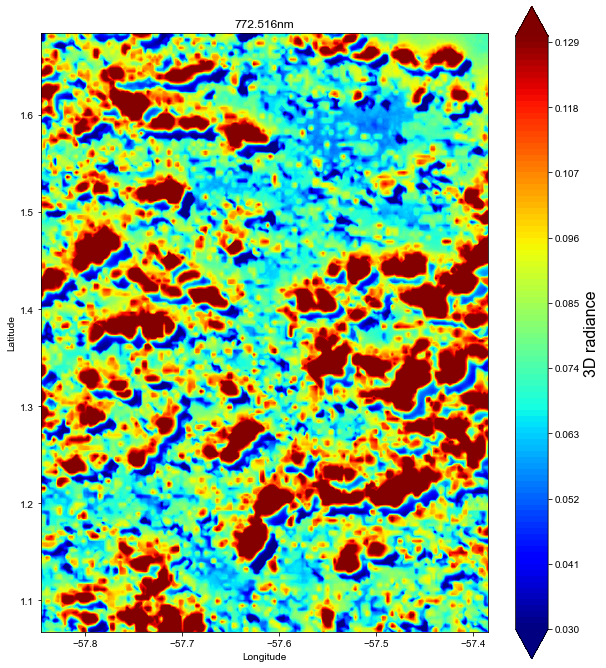

In [76]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])

f,frame=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o1.lon.shape)
vmax = 0.13
vmin = 0.03
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = frame.contourf(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
mask = (o1.co2.flatten()*1e6)>408
frame.scatter(np.array(l1b_lon)[mask], np.array(l1b_lat)[mask],
              c=np.array(l1b_continuum)[mask],
              s=60,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)#, extend='both')
cbar.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title(f'{o1.lam[10]:.3f}nm')

plt.show()

(496,) (62, 8)


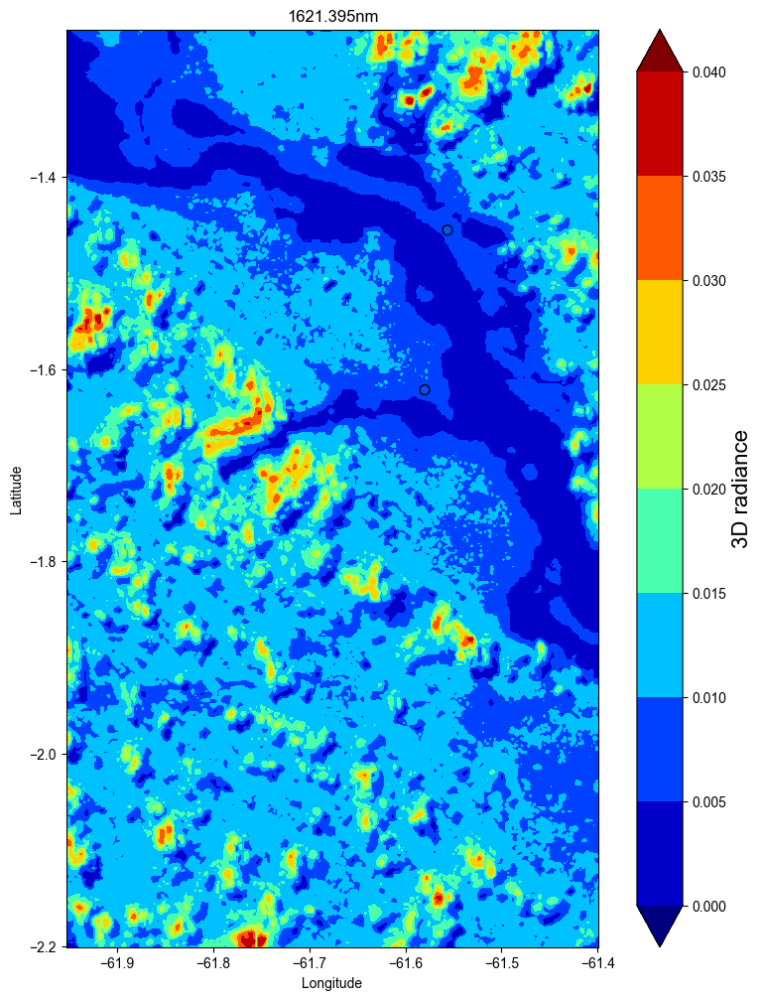

In [41]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o2.lon.shape[0]):
    for j in range(o2.lon.shape[1]):
        l1b_lon.append(o2.lon[i, j])
        l1b_lat.append(o2.lat[i, j])
        l1b_continuum.append(o2.l1b[i, j, np.argmin(np.abs(o2.wvl[i, j, :]-o2.lam[10]))])

f,frame=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)

lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.imshow(img,extent=wesn)
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o2.lon.shape)
vmax = 0.04
vmin = 0.0
lev = np.arange(vmin, vmax+1e-7, 0.005)
rad_to_plot = o2.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = frame.contourf(o2.lon2d, o2.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
mask = (o2.co2.flatten()*1e6)>408
frame.scatter(np.array(l1b_lon)[mask], np.array(l1b_lat)[mask],
              c=np.array(l1b_continuum)[mask],
              s=50,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)#, extend='both')
cbar.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title(f'{o2.lam[10]:.3f}nm')

plt.show()

(496,) (62, 8)


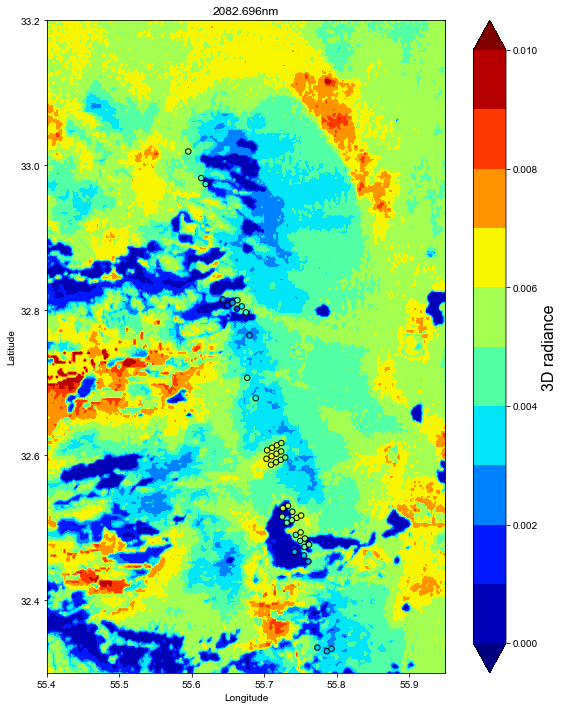

In [99]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o3.lon.shape[0]):
    for j in range(o3.lon.shape[1]):
        l1b_lon.append(o3.lon[i, j])
        l1b_lat.append(o3.lat[i, j])
        l1b_continuum.append(o3.l1b[i, j, np.argmin(np.abs(o3.wvl[i, j, :]-o3.lam[10]))])

f,frame=plt.subplots(figsize=(10, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)

lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.imshow(img,extent=wesn)

frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o3.lon.shape)
vmax = 0.01
vmin = 0.00
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o3.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = frame.contourf(o3.lon2d, o3.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, np.arange(0.02, 0.14+1e-7, 0.02), cmap='jet',
#                   vmin=0.02, vmax=0.14, extend='both')#, alpha=0.5)
mask = (o1.co2.flatten()*1e6)>408
frame.scatter(np.array(l1b_lon)[mask], np.array(l1b_lat)[mask],
              c=np.array(l1b_continuum)[mask],
              s=30,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)#, extend='both')
cbar.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title(f'{o3.lam[10]:.3f}nm')

plt.show()

In [17]:
l1b_lon_o2a, l1b_lat_o2a, l1b_continuum_o2a = [], [], []
l1b_lon_wco2, l1b_lat_wco2, l1b_continuum_wco2 = [], [], []
l1b_lon_sco2, l1b_lat_sco2, l1b_continuum_sco2 = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon_o2a.append(o1.lon[i, j])
        l1b_lat_o2a.append(o1.lat[i, j])
        l1b_continuum_o2a.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])
for i in range(o2.lon.shape[0]):
    for j in range(o2.lon.shape[1]):
        l1b_lon_wco2.append(o2.lon[i, j])
        l1b_lat_wco2.append(o2.lat[i, j])
        l1b_continuum_wco2.append(o2.l1b[i, j, np.argmin(np.abs(o2.wvl[i, j, :]-o2.lam[10]))])
for i in range(o3.lon.shape[0]):
    for j in range(o3.lon.shape[1]):
        l1b_lon_sco2.append(o3.lon[i, j])
        l1b_lat_sco2.append(o3.lat[i, j])
        l1b_continuum_sco2.append(o3.l1b[i, j, np.argmin(np.abs(o3.wvl[i, j, :]-o3.lam[10]))])

mask = (o1.co2.flatten()*1e6)>408  

group_list = [[0, 3], [3, 20], [20, 32], [32, 34], [34, 42], [42, 45]]
lon_lat_move_list = []

for i in range(len(group_list)):
    start, end = group_list[i]
    lon_array = np.array(l1b_lon_o2a)[mask][start:end]
    lat_array = np.array(l1b_lat_o2a)[mask][start:end]
    l1b_array_o2a = np.array(l1b_continuum_o2a)[mask][start:end]
    l1b_array_wco2 = np.array(l1b_continuum_wco2)[mask][start:end]
    l1b_array_sco2 = np.array(l1b_continuum_sco2)[mask][start:end]
    
    lon_1d = o1.lon2d[:, 0]
    lat_1d = o1.lat2d[0, :]
    indices_x = np.int_(np.round((lon_array-lon_1d[0])/(((lon_1d[1:]-lon_1d[:-1])).mean()), decimals=0))
    indices_y = np.int_(np.round((lat_array-lat_1d[0])/(((lat_1d[1:]-lat_1d[:-1])).mean()), decimals=0))

    o2a_err_sqrt_init = np.sqrt(np.sum((l1b_array_o2a-o1.rad_c3d[indices_x,indices_y,10])**2))
    o2a_err_sqrt = o2a_err_sqrt_init.copy()
    wco2_err_sqrt_init = np.sqrt(np.sum((l1b_array_wco2-o2.rad_c3d[indices_x,indices_y,10])**2))
    wco2_err_sqrt = wco2_err_sqrt_init.copy()
    sco2_err_sqrt_init = np.sqrt(np.sum((l1b_array_sco2-o3.rad_c3d[indices_x,indices_y,10])**2))
    sco2_err_sqrt = sco2_err_sqrt_init.copy()
    lon_move_final_o2a, lat_move_final_o2a = 0, 0
    lon_move_final_wco2, lat_move_final_wco2 = 0, 0
    lon_move_final_sco2, lat_move_final_sco2 = 0, 0
    for lon_move in np.linspace(-0.025, 0.025, num=51):
        for lat_move in np.linspace(-0.025, 0.025, num=51):
            indices_x_new = np.int_(np.round((lon_array+lon_move-lon_1d[0])/(((lon_1d[1:]-lon_1d[:-1])).mean()), decimals=0))
            indices_y_new = np.int_(np.round((lat_array+lat_move-lat_1d[0])/(((lat_1d[1:]-lat_1d[:-1])).mean()), decimals=0))


            temp_o2a = np.sqrt(np.sum((l1b_array_o2a-o1.rad_c3d[indices_x_new,indices_y_new,10])**2))
            temp_wco2 = np.sqrt(np.sum((l1b_array_wco2-o2.rad_c3d[indices_x_new,indices_y_new,10])**2))
            temp_sco2 = np.sqrt(np.sum((l1b_array_sco2-o3.rad_c3d[indices_x_new,indices_y_new,10])**2))
            if temp_o2a < o2a_err_sqrt:
                o2a_err_sqrt = temp_o2a
                lon_move_final_o2a, lat_move_final_o2a = lon_move, lat_move
            if temp_wco2 < wco2_err_sqrt:
                wco2_err_sqrt = temp_wco2
                lon_move_final_wco2, lat_move_final_wco2 = lon_move, lat_move
            if temp_sco2 < sco2_err_sqrt:
                sco2_err_sqrt = temp_sco2
                lon_move_final_sco2, lat_move_final_sco2 = lon_move, lat_move
    lon_lat_move_list.append([np.round(lon_move_final_o2a, 3), np.round(lat_move_final_o2a, 3)])
    print('-'*15)
    print(start, end)
    print(lon_move_final_o2a, lat_move_final_o2a, o2a_err_sqrt_init, o2a_err_sqrt) 
    print(lon_move_final_wco2, lat_move_final_wco2, wco2_err_sqrt_init, wco2_err_sqrt) 
    print(lon_move_final_sco2, lat_move_final_sco2, sco2_err_sqrt_init, sco2_err_sqrt) 

---------------
0 3
0.019999999999999997 0.0010000000000000009 0.014857145281624955 0.0004508621383623956
0.018999999999999996 -0.0010000000000000009 0.0031405583213156684 0.000537435045277732
0.011000000000000003 0.020999999999999998 0.0003742088226608488 9.546217490103811e-05
---------------
3 20
0.020999999999999998 -0.016 0.10611271265514492 0.03941173443979115
0.024 -0.022000000000000002 0.03293324515765045 0.012011640836108407
0.020999999999999998 -0.016 0.011640173949124144 0.0033836717450386215
---------------
20 32
0.0010000000000000009 0.002999999999999999 0.01770986232774135 0.005696997797834878
0.0010000000000000009 0.0019999999999999983 0.004326751894808946 0.00281944564452916
-0.012 -0.013000000000000001 0.001955215046037882 0.001241847712847254
---------------
32 34
0.0049999999999999975 0.011000000000000003 0.004536152505108621 4.129476789622529e-05
0.006999999999999999 -0.0020000000000000018 0.0014357101279099645 5.8445915425111406e-05
-0.013000000000000001 0.023 0.000

In [135]:
lon_lat_move_list


[[0.02, 0.001],
 [0.021, -0.016],
 [0.001, 0.003],
 [0.005, 0.011],
 [-0.007, 0.006],
 [0.016, 0.003]]

In [120]:
l1b_lon_o2a, l1b_lat_o2a, l1b_continuum_o2a = [], [], []
l1b_lon_wco2, l1b_lat_wco2, l1b_continuum_wco2 = [], [], []
l1b_lon_sco2, l1b_lat_sco2, l1b_continuum_sco2 = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon_o2a.append(o1.lon[i, j])
        l1b_lat_o2a.append(o1.lat[i, j])
        l1b_continuum_o2a.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])
for i in range(o2.lon.shape[0]):
    for j in range(o2.lon.shape[1]):
        l1b_lon_wco2.append(o2.lon[i, j])
        l1b_lat_wco2.append(o2.lat[i, j])
        l1b_continuum_wco2.append(o2.l1b[i, j, np.argmin(np.abs(o2.wvl[i, j, :]-o2.lam[10]))])
for i in range(o3.lon.shape[0]):
    for j in range(o3.lon.shape[1]):
        l1b_lon_sco2.append(o3.lon[i, j])
        l1b_lat_sco2.append(o3.lat[i, j])
        l1b_continuum_sco2.append(o3.l1b[i, j, np.argmin(np.abs(o3.wvl[i, j, :]-o3.lam[10]))])

mask = (o1.co2.flatten()*1e6)>408  

group_list = [[0, 3], [3, 20], [20, 32], [32, 34], [34, 42], [42, 45]]
for i in [0]:#range(len(group_list)):
    start, end = group_list[i]
    lon_array = np.array(l1b_lon_o2a)[mask][start:end]
    lat_array = np.array(l1b_lat_o2a)[mask][start:end]
    l1b_array_o2a = np.array(l1b_continuum_o2a)[mask][start:end]
    l1b_array_wco2 = np.array(l1b_continuum_wco2)[mask][start:end]
    l1b_array_sco2 = np.array(l1b_continuum_sco2)[mask][start:end]
    
    lon_1d = o1.lon2d[:, 0]
    lat_1d = o1.lat2d[0, :]
    indices_x = np.int_(np.round((lon_array-lon_1d[0])/(((lon_1d[1:]-lon_1d[:-1])).mean()), decimals=0))
    indices_y = np.int_(np.round((lat_array-lat_1d[0])/(((lat_1d[1:]-lat_1d[:-1])).mean()), decimals=0))

    o2a_err_sqrt_init = np.sqrt(np.sum((l1b_array_o2a-o1.rad_c3d[indices_x,indices_y,10])**2))
    o2a_err_sqrt = o2a_err_sqrt_init.copy()
    wco2_err_sqrt_init = np.sqrt(np.sum((l1b_array_wco2-o2.rad_c3d[indices_x,indices_y,10])**2))
    wco2_err_sqrt = wco2_err_sqrt_init.copy()
    sco2_err_sqrt_init = np.sqrt(np.sum((l1b_array_sco2-o3.rad_c3d[indices_x,indices_y,10])**2))
    sco2_err_sqrt = sco2_err_sqrt_init.copy()
    print(lon_array)
    lon_move, lat_move = -0.135, 0.135
    lon_array += lon_move
    print(lon_array)
    print(lat_array)
    lat_array += lat_move
    print(lat_array)
    indices_x_new = np.int_(np.round((lon_array-lon_1d[0])/(((lon_1d[1:]-lon_1d[:-1])).mean()), decimals=0))
    indices_y_new = np.int_(np.round((lat_array-lat_1d[0])/(((lat_1d[1:]-lat_1d[:-1])).mean()), decimals=0))


    o2a_err_sqrt = np.sqrt(np.sum((l1b_array_o2a-o1.rad_c3d[indices_x_new,indices_y_new,10])**2))
    wco2_err_sqrt = np.sqrt(np.sum((l1b_array_wco2-o2.rad_c3d[indices_x_new,indices_y_new,10])**2))
    sco2_err_sqrt = np.sqrt(np.sum((l1b_array_sco2-o3.rad_c3d[indices_x_new,indices_y_new,10])**2))
            
print(o2a_err_sqrt_init, o2a_err_sqrt) 
print(wco2_err_sqrt_init, wco2_err_sqrt) 
print(sco2_err_sqrt_init, sco2_err_sqrt) 

[55.77326  55.78639  55.792843]
[55.63826  55.65139  55.657845]
[32.334785 32.32988  32.333187]
[32.469784 32.464878 32.468185]
0 0 0.014857145281624955 0.0002997233432148637
0 0 0.0031405583213156684 0.0007175354908276133
0 0 0.0003742088226608488 0.00037735635814872


[55.77326  55.78639  55.792843 55.741776 55.7549   55.760868 55.72476
 55.731068 55.743496 55.749535 55.7555   55.725662 55.738102 55.75011
 55.75599  55.76174  55.732704 55.73875  55.744724 55.750896 55.703037
 55.709343 55.703835 55.710068 55.71626  55.710773 55.716835 55.72282
 55.71736  55.72326  55.729015 55.72356  55.688194 55.676537 55.64276
 55.649117 55.679714 55.65624  55.66235  55.66299  55.668938 55.674747
 55.61305  55.61912  55.59515 ] [32.334785 32.32988  32.333187 32.466858 32.461987 32.45361  32.515244
 32.50702  32.490368 32.482056 32.47368  32.52707  32.510418 32.493732
 32.485317 32.47687  32.53047  32.52216  32.513786 32.516945 32.595257
 32.587055 32.60705  32.598854 32.590504 32.61051  32.602203 32.59383
 32.613842 32.605427 32.596992 32.61701  32.678867 32.707035 32.81515
 32.806984 32.765457 32.810574 32.802284 32.81401  32.805614 32.7972
 32.982613 32.97427  33.019245]


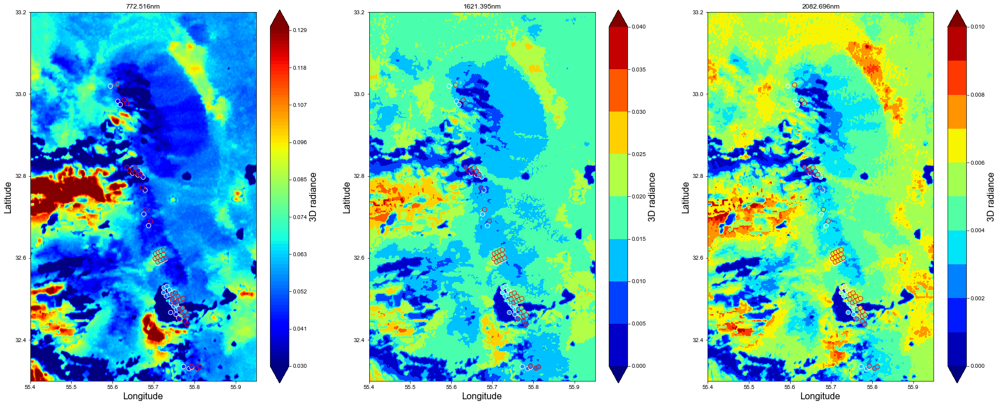

In [50]:
label_size=16

l1b_lon_o2a, l1b_lat_o2a, l1b_continuum_o2a = [], [], []
l1b_lon_wco2, l1b_lat_wco2, l1b_continuum_wco2 = [], [], []
l1b_lon_sco2, l1b_lat_sco2, l1b_continuum_sco2 = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon_o2a.append(o1.lon[i, j])
        l1b_lat_o2a.append(o1.lat[i, j])
        l1b_continuum_o2a.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])
for i in range(o2.lon.shape[0]):
    for j in range(o2.lon.shape[1]):
        l1b_lon_wco2.append(o2.lon[i, j])
        l1b_lat_wco2.append(o2.lat[i, j])
        l1b_continuum_wco2.append(o2.l1b[i, j, np.argmin(np.abs(o2.wvl[i, j, :]-o2.lam[10]))])
for i in range(o3.lon.shape[0]):
    for j in range(o3.lon.shape[1]):
        l1b_lon_sco2.append(o3.lon[i, j])
        l1b_lat_sco2.append(o3.lat[i, j])
        l1b_continuum_sco2.append(o3.l1b[i, j, np.argmin(np.abs(o3.wvl[i, j, :]-o3.lam[10]))])

mask = (o1.co2.flatten()*1e6)>408  
start, end = 0, 45

        
f,(frame, frame2, frame3)=plt.subplots(1, 3, figsize=(30, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]

frame.imshow(img,extent=wesn)

frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
#mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
vmax_o2a = 0.13
vmin_o2a = 0.03
lev = np.arange(vmin_o2a, vmax_o2a+1e-7, 0.001)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax_o2a] = vmax_o2a
cc = frame.contourf(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin_o2a, vmax=vmax_o2a, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)


frame.scatter(np.array(l1b_lon_o2a)[mask][start:end], np.array(l1b_lat_o2a)[mask][start:end],
              c=np.array(l1b_continuum_o2a)[mask][start:end],
              s=60,
              cmap='jet',
              vmin=vmin_o2a, vmax=vmax_o2a,
              marker='o', edgecolors='white')
print(np.array(l1b_lon_o2a)[mask][start:end], np.array(l1b_lat_o2a)[mask][start:end])
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, ax=frame, extend='both')
cbar.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame.set_xlabel('Longitude', fontsize=label_size)
frame.set_ylabel('Latitude', fontsize=label_size)
frame.set_title(f'{o1.lam[10]:.3f}nm')


# wco2
frame2.imshow(img,extent=wesn)
frame2.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame2.set_ylim(np.min(lat_dom), np.max(lat_dom))
vmax_wco2 = 0.04
vmin_wco2 = 0.0
lev = np.arange(vmin_wco2, vmax_wco2+1e-7, 0.005)
rad_to_plot = o2.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax_wco2] = vmax_wco2
cc2 = frame2.contourf(o2.lon2d, o2.lat2d, rad_to_plot, lev, cmap='jet', 
                   vmin=vmin_wco2, vmax=vmax_wco2, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
frame2.scatter(np.array(l1b_lon_wco2)[mask][start:end], np.array(l1b_lat_wco2)[mask][start:end],
              c=np.array(l1b_continuum_wco2)[mask][start:end],
              s=60,
              cmap='jet',
              vmin=vmin_wco2, vmax=vmax_wco2,
              marker='o', edgecolors='white')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar2 = f.colorbar(cc2, ax=frame2, extend='both')
cbar2.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame2.set_xlabel('Longitude', fontsize=label_size)
frame2.set_ylabel('Latitude', fontsize=label_size)
frame2.set_title(f'{o2.lam[10]:.3f}nm')

#sco2

frame3.imshow(img,extent=wesn)
frame3.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame3.set_ylim(np.min(lat_dom), np.max(lat_dom))
vmax_sco2 = 0.01
vmin_sco2 = 0.00
lev = np.arange(vmin_sco2, vmax_sco2+1e-7, 0.001)
rad_to_plot = o3.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax_sco2] = vmax_sco2
cc3 = frame3.contourf(o3.lon2d, o3.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin_sco2, vmax=vmax_sco2, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, np.arange(0.02, 0.14+1e-7, 0.02), cmap='jet',
#                   vmin=0.02, vmax=0.14, extend='both')#, alpha=0.5)
frame3.scatter(np.array(l1b_lon_sco2)[mask][start:end], np.array(l1b_lat_sco2)[mask][start:end],
              c=np.array(l1b_continuum_sco2)[mask][start:end],
              s=60,
              cmap='jet',
              vmin=vmin_sco2, vmax=vmax_sco2,
              marker='o', edgecolors='white')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar3 = f.colorbar(cc3, ax=frame3, extend='both')
cbar3.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame3.set_xlabel('Longitude', fontsize=label_size)
frame3.set_ylabel('Latitude', fontsize=label_size)
frame3.set_title(f'{o3.lam[10]:.3f}nm')


group_list = [[0, 3], [3, 20], [20, 32], [32, 34], [34, 42], [42, 45]]
lon_lat_move_list = [[0.02, 0.001],
 [0.021, -0.016],
 [0.001, 0.003],
 [0.005, 0.011],
 [-0.007, 0.006],
 [0.016, 0.003]]
o2a_slope_avg, o2a_inter_avg = [], []
wco2_slope_avg, wco2_inter_avg = [], []
sco2_slope_avg, sco2_inter_avg = [], []
lon_1d = o1.lon2d[:, 0]
lat_1d = o1.lat2d[0, :]
lon_all_1d = np.array(o1.lon_all).reshape(o1.slope_1km_all[:,:,0].shape)[:, 0]
lat_all_1d = np.array(o1.lat_all).reshape(o1.slope_1km_all[:,:,0].shape)[0, :]
for i in range(len(group_list)):
    start, end = group_list[i]
    lon_move, lat_move = lon_lat_move_list[i]
    lon_array = np.array(l1b_lon_o2a)[mask][start:end]+lon_move
    lat_array = np.array(l1b_lat_o2a)[mask][start:end]+lat_move
    frame.scatter(np.array(l1b_lon_o2a)[mask][start:end]+lon_move, np.array(l1b_lat_o2a)[mask][start:end]+lat_move,
                  c=np.array(l1b_continuum_o2a)[mask][start:end],
                  s=60,
                  cmap='jet',
                  vmin=vmin_o2a, vmax=vmax_o2a,
                  marker='o', edgecolors='r')
    frame2.scatter(np.array(l1b_lon_wco2)[mask][start:end]+lon_move, np.array(l1b_lat_wco2)[mask][start:end]+lat_move,
                  c=np.array(l1b_continuum_wco2)[mask][start:end],
                  s=60,
                  cmap='jet',
                  vmin=vmin_wco2, vmax=vmax_wco2,
                  marker='o', edgecolors='r')
    frame3.scatter(np.array(l1b_lon_sco2)[mask][start:end]+lon_move, np.array(l1b_lat_sco2)[mask][start:end]+lat_move,
                  c=np.array(l1b_continuum_sco2)[mask][start:end],
                  s=60,
                  cmap='jet',
                  vmin=vmin_sco2, vmax=vmax_sco2,
                  marker='o', edgecolors='r')
    indices_x_new = np.int_(np.round((lon_array+lon_move-lon_all_1d[0])/(((lon_all_1d[1:]-lon_all_1d[:-1])).mean()), decimals=0))
    indices_y_new = np.int_(np.round((lat_array+lat_move-lat_all_1d[0])/(((lat_all_1d[1:]-lat_all_1d[:-1])).mean()), decimals=0))


    o2a_slope_avg.append(o1.slope_1km_all[indices_x_new, indices_y_new, 0].mean())
    o2a_inter_avg.append(o1.inter_1km_all[indices_x_new, indices_y_new, 0].mean())
    wco2_slope_avg.append(o2.slope_1km_all[indices_x_new, indices_y_new, 0].mean())
    wco2_inter_avg.append(o2.inter_1km_all[indices_x_new, indices_y_new, 0].mean())
    sco2_slope_avg.append(o3.slope_1km_all[indices_x_new, indices_y_new, 0].mean())
    sco2_inter_avg.append(o3.inter_1km_all[indices_x_new, indices_y_new, 0].mean())

plt.show()

[55.77326  55.78639  55.792843 55.741776 55.7549   55.760868 55.72476
 55.731068 55.743496 55.749535 55.7555   55.725662 55.738102 55.75011
 55.75599  55.76174  55.732704 55.73875  55.744724 55.750896 55.703037
 55.709343 55.703835 55.710068 55.71626  55.710773 55.716835 55.72282
 55.71736  55.72326  55.729015 55.72356  55.688194 55.676537 55.64276
 55.649117 55.679714 55.65624  55.66235  55.66299  55.668938 55.674747
 55.61305  55.61912  55.59515 ] [32.334785 32.32988  32.333187 32.466858 32.461987 32.45361  32.515244
 32.50702  32.490368 32.482056 32.47368  32.52707  32.510418 32.493732
 32.485317 32.47687  32.53047  32.52216  32.513786 32.516945 32.595257
 32.587055 32.60705  32.598854 32.590504 32.61051  32.602203 32.59383
 32.613842 32.605427 32.596992 32.61701  32.678867 32.707035 32.81515
 32.806984 32.765457 32.810574 32.802284 32.81401  32.805614 32.7972
 32.982613 32.97427  33.019245]


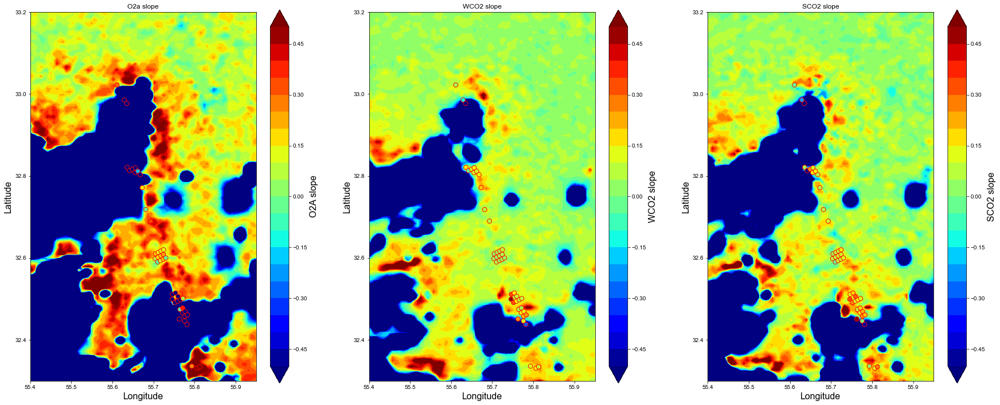

In [49]:
label_size=16
snd_list = []
l1b_lon_o2a, l1b_lat_o2a, l1b_continuum_o2a = [], [], []
l1b_lon_wco2, l1b_lat_wco2, l1b_continuum_wco2 = [], [], []
l1b_lon_sco2, l1b_lat_sco2, l1b_continuum_sco2 = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon_o2a.append(o1.lon[i, j])
        l1b_lat_o2a.append(o1.lat[i, j])
        l1b_continuum_o2a.append(o1.slope_1km[i, j, 0])
for i in range(o2.lon.shape[0]):
    for j in range(o2.lon.shape[1]):
        l1b_lon_wco2.append(o2.lon[i, j])
        l1b_lat_wco2.append(o2.lat[i, j])
        l1b_continuum_wco2.append(o2.slope_1km[i, j, 0])
for i in range(o3.lon.shape[0]):
    for j in range(o3.lon.shape[1]):
        l1b_lon_sco2.append(o3.lon[i, j])
        l1b_lat_sco2.append(o3.lat[i, j])
        l1b_continuum_sco2.append(o3.slope_1km[i, j, 0])

mask = (o1.co2.flatten()*1e6)>408  
start, end = 0, 45
lon_all_2d = np.array(o1.lon_all).reshape(o1.slope_1km_all[:,:,0].shape)
lat_all_2d = np.array(o1.lat_all).reshape(o1.slope_1km_all[:,:,0].shape)
        
f,(frame, frame2, frame3)=plt.subplots(1, 3, figsize=(30, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]

frame.imshow(img,extent=wesn)

frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
#mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
vmax_o2a = 0.5
vmin_o2a = -0.5
lev = np.arange(vmin_o2a, vmax_o2a+1e-7, 0.05)
rad_to_plot = o1.slope_1km_all[:,:,0].copy()
#rad_to_plot[rad_to_plot>vmax_o2a] = vmax_o2a
cc = frame.contourf(lon_all_2d, lat_all_2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin_o2a, vmax=vmax_o2a, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)

"""
frame.scatter(np.array(l1b_lon_o2a)[mask][start:end], np.array(l1b_lat_o2a)[mask][start:end],
              c=None,
              s=60,
              cmap='jet',
              vmin=vmin_o2a, vmax=vmax_o2a,
              marker='o', edgecolors='k')"""
print(np.array(l1b_lon_o2a)[mask][start:end], np.array(l1b_lat_o2a)[mask][start:end])
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, ax=frame, extend='both')
cbar.set_label('O2A slope', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame.set_xlabel('Longitude', fontsize=label_size)
frame.set_ylabel('Latitude', fontsize=label_size)
frame.set_title('O2a slope')


# wco2
frame2.imshow(img,extent=wesn)
frame2.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame2.set_ylim(np.min(lat_dom), np.max(lat_dom))
vmax_wco2 = 0.5
vmin_wco2 = -0.5
lev = np.arange(vmin_wco2, vmax_wco2+1e-7, 0.05)
rad_to_plot = o2.slope_1km_all[:,:,0].copy()
#rad_to_plot[rad_to_plot>vmax_wco2] = vmax_wco2
cc2 = frame2.contourf(lon_all_2d, lat_all_2d, rad_to_plot, lev, cmap='jet', 
                   vmin=vmin_wco2, vmax=vmax_wco2, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
"""frame2.scatter(np.array(l1b_lon_wco2)[mask][start:end], np.array(l1b_lat_wco2)[mask][start:end],
              c=np.array(l1b_continuum_wco2)[mask][start:end],
              s=60,
              cmap='jet',
              vmin=vmin_wco2, vmax=vmax_wco2,
              marker='o', edgecolors='white')"""
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar2 = f.colorbar(cc2, ax=frame2, extend='both')
cbar2.set_label('WCO2 slope', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame2.set_xlabel('Longitude', fontsize=label_size)
frame2.set_ylabel('Latitude', fontsize=label_size)
frame2.set_title('WCO2 slope')

#sco2

frame3.imshow(img,extent=wesn)
frame3.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame3.set_ylim(np.min(lat_dom), np.max(lat_dom))
vmax_sco2 = 0.5
vmin_sco2 = -0.5
lev = np.arange(vmin_sco2, vmax_sco2+1e-7, 0.05)
rad_to_plot = o3.slope_1km_all[:,:,0].copy()
#rad_to_plot[rad_to_plot>vmax_sco2] = vmax_sco2
cc3 = frame3.contourf(lon_all_2d, lat_all_2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin_sco2, vmax=vmax_sco2, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, np.arange(0.02, 0.14+1e-7, 0.02), cmap='jet',
#                   vmin=0.02, vmax=0.14, extend='both')#, alpha=0.5)
"""frame3.scatter(np.array(l1b_lon_sco2)[mask][start:end], np.array(l1b_lat_sco2)[mask][start:end],
              c=np.array(l1b_continuum_sco2)[mask][start:end],
              s=60,
              cmap='jet',
              vmin=vmin_sco2, vmax=vmax_sco2,
              marker='o', edgecolors='white')"""
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar3 = f.colorbar(cc3, ax=frame3, extend='both')
cbar3.set_label('SCO2 slope', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame3.set_xlabel('Longitude', fontsize=label_size)
frame3.set_ylabel('Latitude', fontsize=label_size)
frame3.set_title('SCO2 slope')


group_list = [[0, 3], [3, 20], [20, 32], [32, 34], [34, 42], [42, 45]]
lon_lat_move_list = [[0.02, 0.001],
 [0.021, -0.016],
 [0.001, 0.003],
 [0.005, 0.011],
 [-0.007, 0.006],
 [0.016, 0.003]]
o2a_slope_avg, o2a_inter_avg = [], []
wco2_slope_avg, wco2_inter_avg = [], []
sco2_slope_avg, sco2_inter_avg = [], []
lon_1d = o1.lon2d[:, 0]
lat_1d = o1.lat2d[0, :]
lon_all_1d = np.array(o1.lon_all).reshape(o1.slope_1km_all[:,:,0].shape)[:, 0]
lat_all_1d = np.array(o1.lat_all).reshape(o1.slope_1km_all[:,:,0].shape)[0, :]
for i in range(len(group_list)):
    start, end = group_list[i]
    lon_move, lat_move = lon_lat_move_list[i]
    lon_array = np.array(l1b_lon_o2a)[mask][start:end]+lon_move
    lat_array = np.array(l1b_lat_o2a)[mask][start:end]+lat_move
    #"""
    frame.scatter(np.array(l1b_lon_o2a)[mask][start:end]+lon_move, np.array(l1b_lat_o2a)[mask][start:end]+lat_move,
                  c=np.array(l1b_continuum_o2a)[mask][start:end],
                  s=60,
                  cmap='jet',
                  vmin=vmin_o2a, vmax=vmax_o2a,
                  marker='o', edgecolors='r')
    frame2.scatter(np.array(l1b_lon_wco2)[mask][start:end]+lon_move, np.array(l1b_lat_wco2)[mask][start:end]+lat_move,
                  c=np.array(l1b_continuum_wco2)[mask][start:end],
                  s=60,
                  cmap='jet',
                  vmin=vmin_wco2, vmax=vmax_wco2,
                  marker='o', edgecolors='r')
    frame3.scatter(np.array(l1b_lon_sco2)[mask][start:end]+lon_move, np.array(l1b_lat_sco2)[mask][start:end]+lat_move,
                  c=np.array(l1b_continuum_sco2)[mask][start:end],
                  s=60,
                  cmap='jet',
                  vmin=vmin_sco2, vmax=vmax_sco2,
                  marker='o', edgecolors='r')
    #"""    
    indices_x_new = np.int_(np.round((lon_array+lon_move-lon_all_1d[0])/(((lon_all_1d[1:]-lon_all_1d[:-1])).mean()), decimals=0))
    indices_y_new = np.int_(np.round((lat_array+lat_move-lat_all_1d[0])/(((lat_all_1d[1:]-lat_all_1d[:-1])).mean()), decimals=0))


    o2a_slope_avg.append(o1.slope_1km_all[indices_x_new, indices_y_new, 0].mean())
    o2a_inter_avg.append(o1.inter_1km_all[indices_x_new, indices_y_new, 0].mean())
    wco2_slope_avg.append(o2.slope_1km_all[indices_x_new, indices_y_new, 0].mean())
    wco2_inter_avg.append(o2.inter_1km_all[indices_x_new, indices_y_new, 0].mean())
    sco2_slope_avg.append(o3.slope_1km_all[indices_x_new, indices_y_new, 0].mean())
    sco2_inter_avg.append(o3.inter_1km_all[indices_x_new, indices_y_new, 0].mean())

plt.show()

In [56]:
mask = (o1.co2.flatten()*1e6)>408

group_list = [[0, 3], [3, 20], [20, 32], [32, 34], [34, 42], [42, 45]]
lon_lat_move_list = [[0.02, 0.001],
 [0.021, -0.016],
 [0.001, 0.003],
 [0.005, 0.011],
 [-0.007, 0.006],
 [0.016, 0.003]]

select_snd = o1.snd.flatten()[mask]
print(select_snd)
output = np.zeros((45, 11))
oco_list = [o1, o2, o3]
slope_list = [o2a_slope_avg, wco2_slope_avg, sco2_slope_avg]
inter_list = [o2a_inter_avg, wco2_inter_avg, sco2_inter_avg]
for i in range(len(group_list)):
    start, end = group_list[i]
    lon_move, lat_move = lon_lat_move_list[i]
    lon_array = np.array(l1b_lon_o2a)[mask][start:end]+lon_move
    lat_array = np.array(l1b_lat_o2a)[mask][start:end]+lat_move
    for j in range(len(lon_array)):
        output[start+j, 0] = select_snd[start+j]
        lon_tmp, lat_tmp = lon_array[j], lat_array[j]
        output[start+j, 1:3] = lon_tmp, lat_tmp
        output[start+j, 3:5] = o1.co2.flatten()[mask][start+j]*1e6, o1.psur.flatten()[mask][start+j]/1000
        for k in range(3):
            output[start+j, k*2+1+5] = slope_list[k][i]
            output[start+j, k*2+5] = inter_list[k][i]

"""for i in range(8):
    snd = select_snd[i]
    mask_snd = o1.snd.flatten()==snd
    output[i, 0] = snd
    lon_tmp, lat_tmp = o1.lon.flatten()[mask_snd][0], o1.lat.flatten()[mask_snd][0]
    if i in [0, 1, 2, 3]:
        lon_tmp += -0.012
        lat_tmp += -0.03
    elif i in [4, 5]:
        lon_tmp += 0.007
        lat_tmp += -0.015
    elif i in [6, 7]:
        lon_tmp += 0.016
        lat_tmp += 0.022
    output[i, 1:3] = lon_tmp, lat_tmp
    output[i, 3:5] = o1.co2.flatten()[mask_snd][0]*1e6, o1.psur.flatten()[mask_snd][0]/1000
    for j in range(3):
        ocosim = oco_list[j]
        itp_slope = RegularGridInterpolator((sorted(set(o1.lon_all)), sorted(set(o1.lat_all))),
                              (ocosim.slope_1km_all[:,:,0]), method='linear') 
        
        output[i, j*2+5] = itp_slope((lon_tmp, lat_tmp))
        itp_inter = RegularGridInterpolator((sorted(set(o1.lon_all)), sorted(set(o1.lat_all))),
                              (ocosim.inter_1km_all[:,:,0]), method='linear') 
        output[i, j*2+1+5] = itp_inter((lon_tmp, lat_tmp))"""
output = pd.DataFrame(output, columns=['SND', 'LON', 'LAT', 'L2XCO2[ppm]', 'L2PSUR[kPa]',
                                       'i1', 's1', 'i2', 's2', 'i3', 's3'])
output.SND = output.SND.apply(lambda x:'SND'+str(int(x)))
output
output.to_csv('output.csv', index=False)

[2018101809315901 2018101809315934 2018101809315976 2018101809320132
 2018101809320175 2018101809320176 2018101809320201 2018101809320202
 2018101809320204 2018101809320205 2018101809320206 2018101809320232
 2018101809320234 2018101809320236 2018101809320237 2018101809320238
 2018101809320274 2018101809320275 2018101809320276 2018101809320308
 2018101809320331 2018101809320332 2018101809320372 2018101809320373
 2018101809320374 2018101809320404 2018101809320405 2018101809320406
 2018101809320436 2018101809320437 2018101809320438 2018101809320478
 2018101809320503 2018101809320532 2018101809320701 2018101809320702
 2018101809320707 2018101809320734 2018101809320735 2018101809320776
 2018101809320777 2018101809320778 2018101809321035 2018101809321036
 2018101809321073]


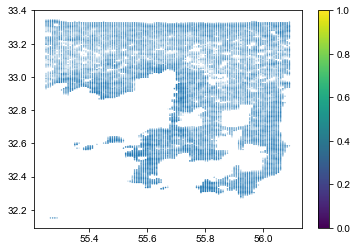

In [29]:
plt.scatter(np.array(o1.lon_all).reshape(o1.slope_1km_all[:,:,0].shape),
            np.array(o1.lat_all).reshape(o1.slope_1km_all[:,:,0].shape), 
           o1.slope_1km_all[:,:,0], cmap='jet')
plt.colorbar()
plt.show()

[55.77326  55.78639  55.792843 55.741776 55.7549   55.760868 55.72476
 55.731068 55.743496 55.749535 55.7555   55.725662 55.738102 55.75011
 55.75599  55.76174  55.732704 55.73875  55.744724 55.750896 55.703037
 55.709343 55.703835 55.710068 55.71626  55.710773 55.716835 55.72282
 55.71736  55.72326  55.729015 55.72356  55.688194 55.676537 55.64276
 55.649117 55.679714 55.65624  55.66235  55.66299  55.668938 55.674747
 55.61305  55.61912  55.59515 ] [32.334785 32.32988  32.333187 32.466858 32.461987 32.45361  32.515244
 32.50702  32.490368 32.482056 32.47368  32.52707  32.510418 32.493732
 32.485317 32.47687  32.53047  32.52216  32.513786 32.516945 32.595257
 32.587055 32.60705  32.598854 32.590504 32.61051  32.602203 32.59383
 32.613842 32.605427 32.596992 32.61701  32.678867 32.707035 32.81515
 32.806984 32.765457 32.810574 32.802284 32.81401  32.805614 32.7972
 32.982613 32.97427  33.019245]


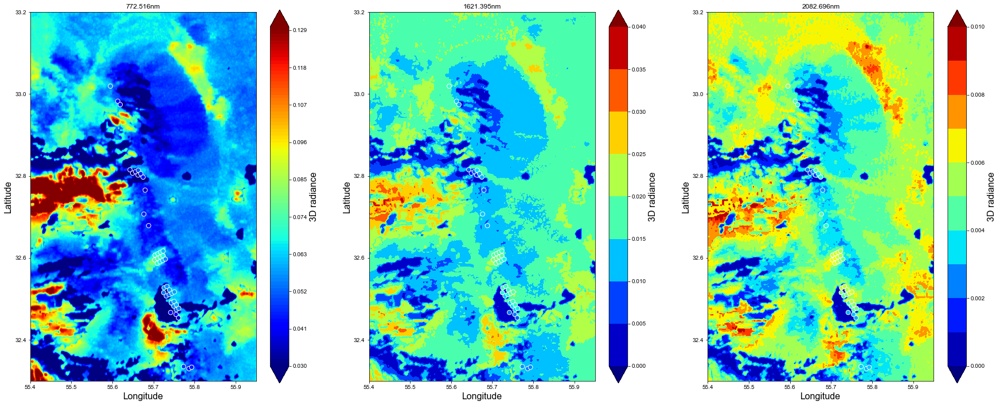

In [123]:
label_size=16

l1b_lon_o2a, l1b_lat_o2a, l1b_continuum_o2a = [], [], []
l1b_lon_wco2, l1b_lat_wco2, l1b_continuum_wco2 = [], [], []
l1b_lon_sco2, l1b_lat_sco2, l1b_continuum_sco2 = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon_o2a.append(o1.lon[i, j])
        l1b_lat_o2a.append(o1.lat[i, j])
        l1b_continuum_o2a.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])
for i in range(o2.lon.shape[0]):
    for j in range(o2.lon.shape[1]):
        l1b_lon_wco2.append(o2.lon[i, j])
        l1b_lat_wco2.append(o2.lat[i, j])
        l1b_continuum_wco2.append(o2.l1b[i, j, np.argmin(np.abs(o2.wvl[i, j, :]-o2.lam[10]))])
for i in range(o3.lon.shape[0]):
    for j in range(o3.lon.shape[1]):
        l1b_lon_sco2.append(o3.lon[i, j])
        l1b_lat_sco2.append(o3.lat[i, j])
        l1b_continuum_sco2.append(o3.l1b[i, j, np.argmin(np.abs(o3.wvl[i, j, :]-o3.lam[10]))])

mask = (o1.co2.flatten()*1e6)>408  

group_list = [[0, 3], [3, 20], [20, 32], [32, 34], [34, 42], [42, 45]]
start, end = 0, 45
        
f,(frame, frame2, frame3)=plt.subplots(1, 3, figsize=(30, 12))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]

frame.imshow(img,extent=wesn)

frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
#mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
vmax = 0.13
vmin = 0.03
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = frame.contourf(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)


frame.scatter(np.array(l1b_lon_o2a)[mask][start:end], np.array(l1b_lat_o2a)[mask][start:end],
              c=np.array(l1b_continuum_o2a)[mask][start:end],
              s=60,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='white')
print(np.array(l1b_lon_o2a)[mask][start:end], np.array(l1b_lat_o2a)[mask][start:end])
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, ax=frame)#, extend='both')
cbar.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame.set_xlabel('Longitude', fontsize=label_size)
frame.set_ylabel('Latitude', fontsize=label_size)
frame.set_title(f'{o1.lam[10]:.3f}nm')


# wco2
frame2.imshow(img,extent=wesn)
frame2.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame2.set_ylim(np.min(lat_dom), np.max(lat_dom))
vmax = 0.04
vmin = 0.0
lev = np.arange(vmin, vmax+1e-7, 0.005)
rad_to_plot = o2.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc2 = frame2.contourf(o2.lon2d, o2.lat2d, rad_to_plot, lev, cmap='jet', 
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')#, alpha=0.5)
frame2.scatter(np.array(l1b_lon_wco2)[mask][start:end], np.array(l1b_lat_wco2)[mask][start:end],
              c=np.array(l1b_continuum_wco2)[mask][start:end],
              s=60,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='white')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar2 = f.colorbar(cc2, ax=frame2)#, extend='both')
cbar2.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame2.set_xlabel('Longitude', fontsize=label_size)
frame2.set_ylabel('Latitude', fontsize=label_size)
frame2.set_title(f'{o2.lam[10]:.3f}nm')

#sco2

frame3.imshow(img,extent=wesn)
frame3.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame3.set_ylim(np.min(lat_dom), np.max(lat_dom))
vmax = 0.01
vmin = 0.00
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o3.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc3 = frame3.contourf(o3.lon2d, o3.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both', alpha=1)

#frame.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, np.arange(0.02, 0.14+1e-7, 0.02), cmap='jet',
#                   vmin=0.02, vmax=0.14, extend='both')#, alpha=0.5)
frame3.scatter(np.array(l1b_lon_sco2)[mask][start:end], np.array(l1b_lat_sco2)[mask][start:end],
              c=np.array(l1b_continuum_sco2)[mask][start:end],
              s=60,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='white')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar3 = f.colorbar(cc3, ax=frame3)#, extend='both')
cbar3.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame3.set_xlabel('Longitude', fontsize=label_size)
frame3.set_ylabel('Latitude', fontsize=label_size)
frame3.set_title(f'{o3.lam[10]:.3f}nm')








plt.show()

(176,) (22, 8)


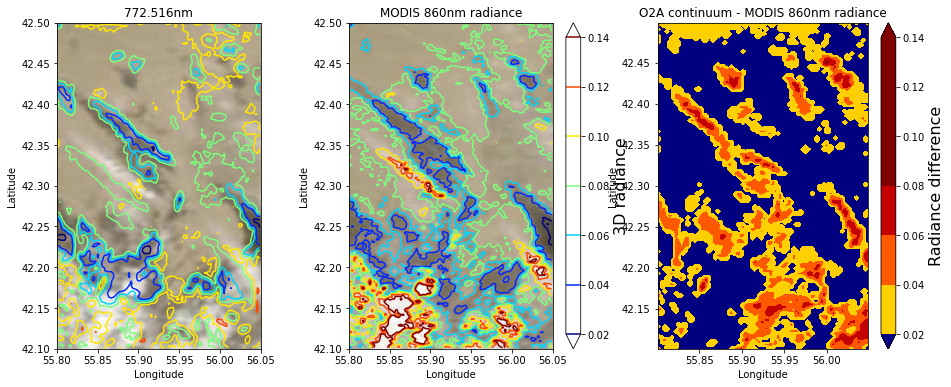

In [215]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        l1b_lon.append(o1.lon[i, j])
        l1b_lat.append(o1.lat[i, j])
        l1b_continuum.append(o1.l1b[i, j, np.argmin(np.abs(o1.wvl[i, j, :]-o1.lam[10]))])

f,(frame, frame2, frame3)=plt.subplots(1, 3, figsize=(16, 6))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]

frame.imshow(img,extent=wesn)
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o1.lon.shape)
vmax = 0.14
vmin = 0.02
lev = np.arange(vmin, vmax+1e-7, 0.02)
rad_to_plot = o1.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = frame.contour(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both')
frame.set_xlabel('Longitude')
frame.set_ylabel('Latitude')
frame.set_title(f'{o1.lam[10]:.3f}nm')

frame2.imshow(img,extent=wesn)
frame2.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame2.set_ylim(np.min(lat_dom), np.max(lat_dom))


cc2 = frame2.contour(l1b_860_lon_2d, l1b_860_lat_2d, rad_860_2d, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both')


cbar = f.colorbar(cc2, ax=frame2)#, extend='both')
cbar.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame2.set_xlabel('Longitude')
frame2.set_ylabel('Latitude')
frame2.set_title('MODIS 860nm radiance')


vmax2 = 0.08
vmin2 = -0.08
lev2 = np.arange(vmin, vmax+1e-7, 0.02)
diff_to_plot = o1.rad_c3d[:,:,10]-rad_860_2d
diff_to_plot[diff_to_plot<vmin] = vmin
cc3 = frame3.contourf(o1.lon2d, o1.lat2d, diff_to_plot, lev2,
                      cmap='jet',
                      vmin=vmin2, vmax=vmax2,
                      extend='both')


cbar = f.colorbar(cc3, ax=frame3)#, extend='both')
cbar.set_label('Radiance difference', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
frame3.set_xlabel('Longitude')
frame3.set_ylabel('Latitude')
frame3.set_title('O2A continuum - MODIS 860nm radiance')

plt.show()

(176,) (22, 8)


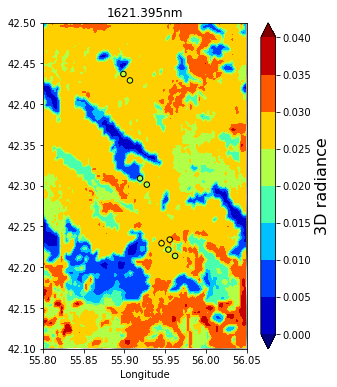

In [118]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o2.lon.shape[0]):
    for j in range(o2.lon.shape[1]):
        l1b_lon.append(o2.lon[i, j])
        l1b_lat.append(o2.lat[i, j])
        l1b_continuum.append(o2.l1b[i, j, np.argmin(np.abs(o2.wvl[i, j, :]-o2.lam[10]))])

f,frame=plt.subplots(figsize=(5, 6))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = o2.dom[:2]
lat_dom = o2.dom[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
mask = (o1.co2.flatten()*1e6)>407.7
print(mask.shape, o2.lon.shape)
vmax = 0.04
vmin = 0.0
lev = np.arange(vmin, vmax+1e-7, 0.005)
rad_to_plot = o2.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = frame.contourf(o2.lon2d, o2.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both')
frame.scatter(np.array(l1b_lon)[mask], np.array(l1b_lat)[mask],
              c=np.array(l1b_continuum)[mask],
              s=30,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)#, extend='both')
cbar.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
#plt.ylabel('Latitude')
plt.title(f'{o2.lam[10]:.3f}nm')

plt.show()

(176,) (22, 8)


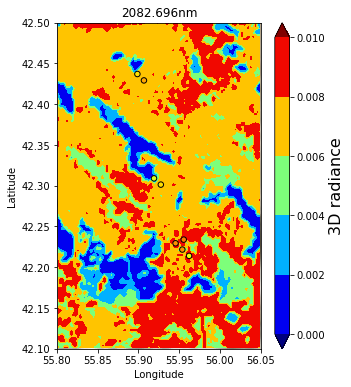

In [86]:
l1b_lon, l1b_lat, l1b_continuum = [], [], []
for i in range(o3.lon.shape[0]):
    for j in range(o3.lon.shape[1]):
        l1b_lon.append(o3.lon[i, j])
        l1b_lat.append(o3.lat[i, j])
        l1b_continuum.append(o3.l1b[i, j, np.argmin(np.abs(o3.wvl[i, j, :]-o3.lam[10]))])

f,frame=plt.subplots(figsize=(5, 6))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = o3.dom[:2]
lat_dom = o3.dom[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
mask = (o1.co2.flatten()*1e6)>407.7
print(mask.shape, o3.lon.shape)
vmax = 0.01
vmin = 0.0
lev = np.arange(vmin, vmax+1e-7, 0.002)
rad_to_plot = o3.rad_c3d[:,:,10].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
cc = frame.contourf(o3.lon2d, o3.lat2d, rad_to_plot, lev, cmap='jet',
                   vmin=vmin, vmax=vmax, extend='both')
frame.scatter(np.array(l1b_lon)[mask], np.array(l1b_lat)[mask],
              c=np.array(l1b_continuum)[mask],
              s=30,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)#, extend='both')
cbar.set_label('3D radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title(f'{o3.lam[10]:.3f}nm')

plt.show()

(-0.015, 0.25)

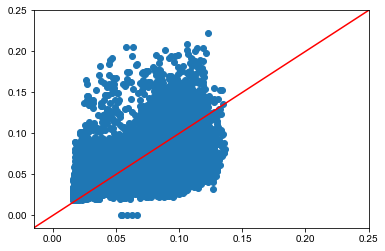

In [344]:
plt.scatter(o1.rad_c3d[:,:,10].flatten(), rad_860_2d.flatten())
plt.plot([-0.015,0.25], [-0.015,0.25], 'r')
plt.ylim(-0.015,0.25)
plt.xlim(-0.015,0.25)

(496,) (62, 8)


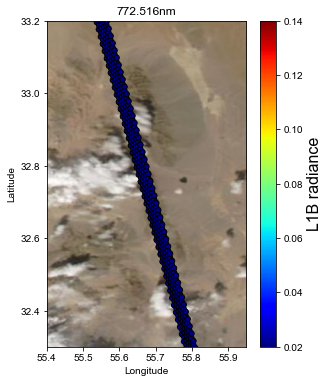

In [75]:
f,frame=plt.subplots(figsize=(5, 6))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = [lon_w, lon_e]
lat_dom = [lat_s, lat_n]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o1.lon.shape)
vmax = 0.13
vmin = 0.03
lev = np.arange(vmin, vmax+1e-7, 0.001)
rad_to_plot = o1.rad_c3d[:,:,2].copy()
rad_to_plot[rad_to_plot>vmax] = vmax
#cc = frame.contourf(o1.lon2d, o1.lat2d, rad_to_plot, lev, cmap='jet',
#                   vmin=vmin, vmax=vmax, extend='both')
cc = frame.scatter(np.array(l1b_lon), np.array(l1b_lat),
              c=np.array(l1b_continuum),
              s=30,
              cmap='jet',
              vmin=vmin, vmax=vmax,
              marker='o', edgecolors='k')
#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)#, extend='both')
cbar.set_label('L1B radiance', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title(f'{o1.lam[10]:.3f}nm')

plt.show()

(176,) (22, 8)


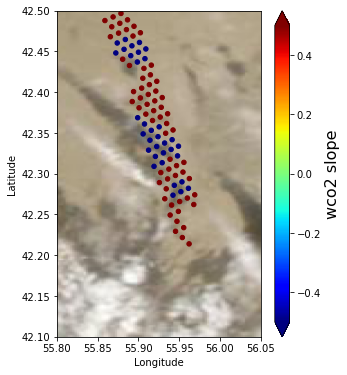

In [83]:
f,frame=plt.subplots(figsize=(5, 6))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o1.lon.shape)
cc = frame.scatter(o1.lon.flatten()[mask], o1.lat.flatten()[mask],
              s=20,
              marker='o', c=o2.inter_1km[:,:,0].flatten()[mask]*100, cmap='jet',
              vmin=-0.5, vmax=0.5)

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc, extend='both')
cbar.set_label('wco2 slope', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

(176,) (22, 8)


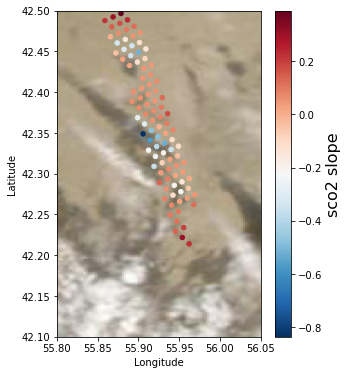

In [84]:
f,frame=plt.subplots(figsize=(5, 6))
img = png[0]
wesn= png[1]
img = mpimg.imread(img)
frame.imshow(img,extent=wesn)
lon_dom = o1.dom[:2]
lat_dom = o1.dom[2:]
frame.set_xlim(np.min(lon_dom), np.max(lon_dom))
frame.set_ylim(np.min(lat_dom), np.max(lat_dom))
mask = np.logical_or(qf_array[:, :, 0].flatten()==0, qf_array[:, :, 0].flatten()==1)
print(mask.shape, o1.lon.shape)
cc = frame.scatter(o1.lon.flatten()[mask], o1.lat.flatten()[mask],
              s=20,
              marker='o', c=o3.inter_1km[:,:,0].flatten()[mask], cmap='RdBu_r')

#for i in range(len(boundary_list)):
#    boundary = boundary_list[i]
#    plot_rec(np.mean(boundary[0][:2]), np.mean(boundary[0][2:]), 
#             0.5, lat_interval, 
#             frame, 'r')
cbar = f.colorbar(cc)
cbar.set_label('sco2 slope', fontsize=16)
#plt.legend(fontsize=16, facecolor='white')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()

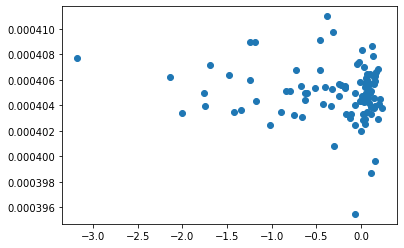

In [87]:
plt.scatter(o1.slope_1km[:,:,0].flatten(), o2.co2[:,:].flatten())

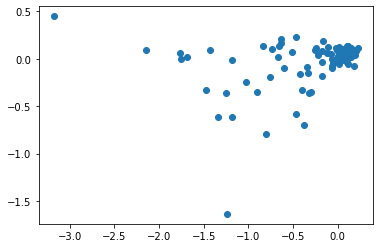

In [90]:
plt.scatter(o1.slope_1km[:,:,0].flatten(), o3.slope_1km[:,:,0].flatten())

In [23]:
plt.plot(o1.wvl[30,0,:], o1.l1b[30,0,:])
plt.plot(o1.lam, o1.clr[30, 0, :], label='clear sky')
plt.plot(o1.lam, o1.c1d[30, 0, :], label='1D')
plt.plot(o1.lam, o1.c3d[30, 0, :], label='3D')
plt.title('Average o2a radiances', fontsize=16)

IndexError: index 30 is out of bounds for axis 0 with size 27

In [298]:
i, j =9, 4
o1.l1b[i, j, :]/o1.toa

ValueError: operands could not be broadcast together with shapes (1016,) (11,) 

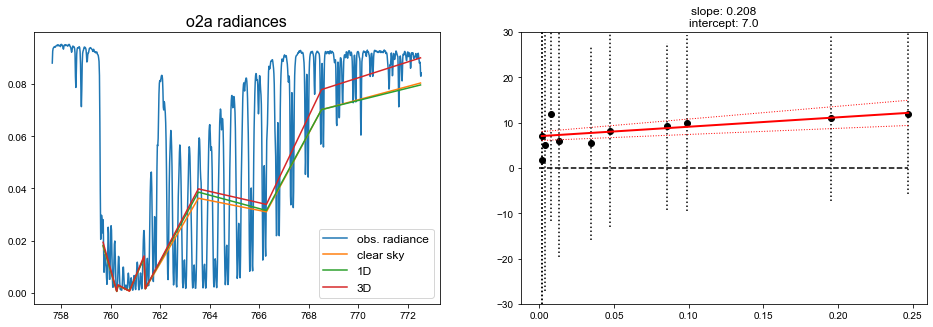

In [368]:
i, j = 11, 7
f, (ax0, ax1) = plt.subplots(1, 2, figsize=(16,5,))
f.patch.set_facecolor('white')
#plt.subplots_adjust(hspace=0.3)
#f.suptitle(f'{o1.lat[i, 0]:.2f}$^\circ$N', fontsize=22)

ax0.plot(o1.wvl[i, j, :], o1.l1b[i, j, :], label='obs. radiance')
ax0.plot(o1.lam, o1.rad_1km_clr[i, j, :], label='clear sky')
ax0.plot(o1.lam, o1.rad_1km_c1d[i, j, :], label='1D')
ax0.plot(o1.lam, o1.rad_1km_c3d[i, j, :], label='3D')
ax0.set_title('o2a radiances', fontsize=16)
ax0.legend(fontsize=12)
plot_perturbation_1km(o1, i, j, frame=ax1)
#o1.plot_perturbation(i, 1, frame=ax1)
plt.show()

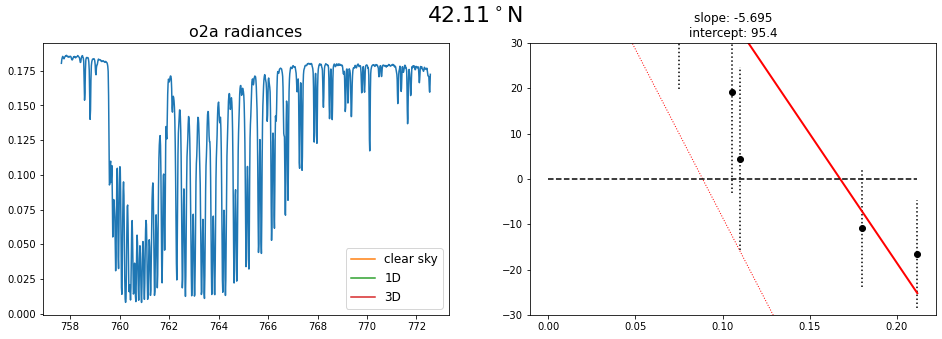

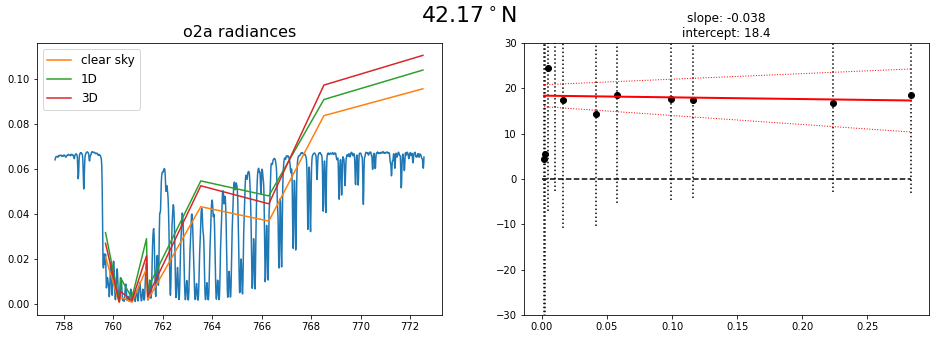

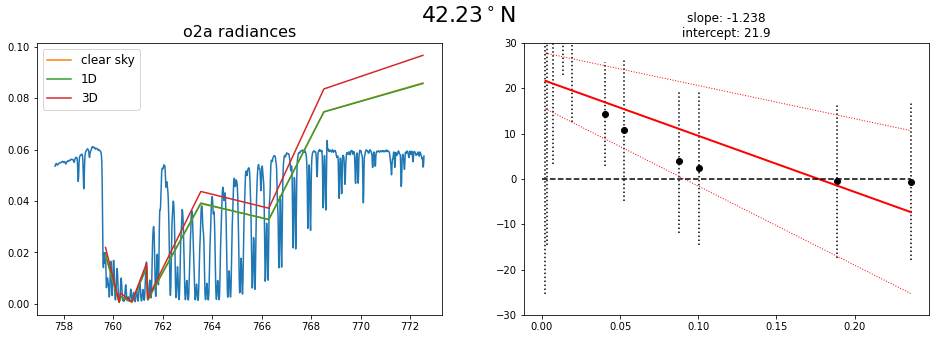

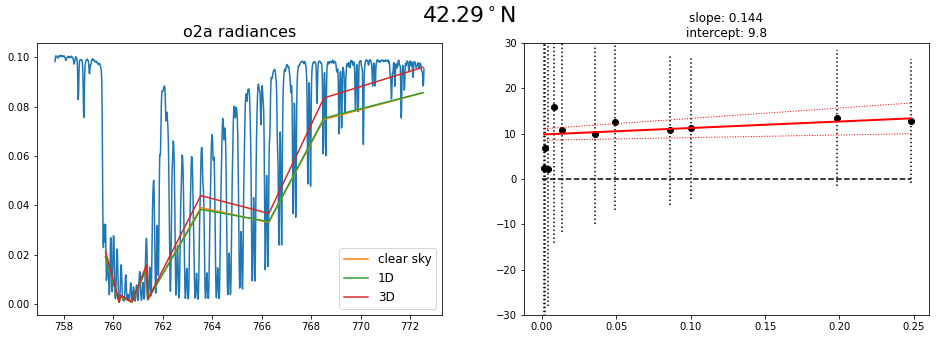

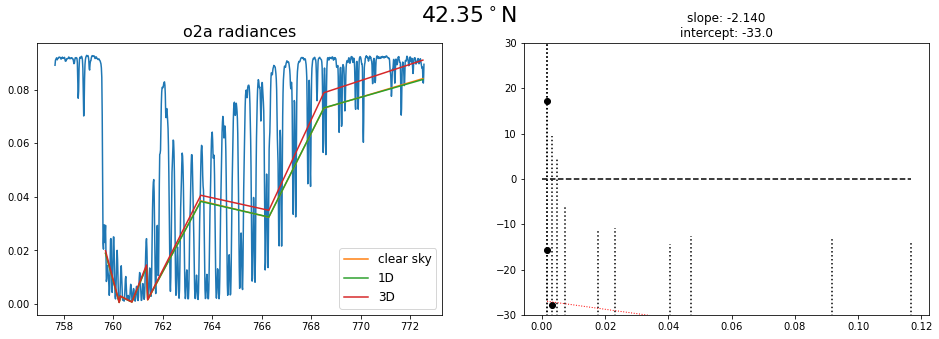

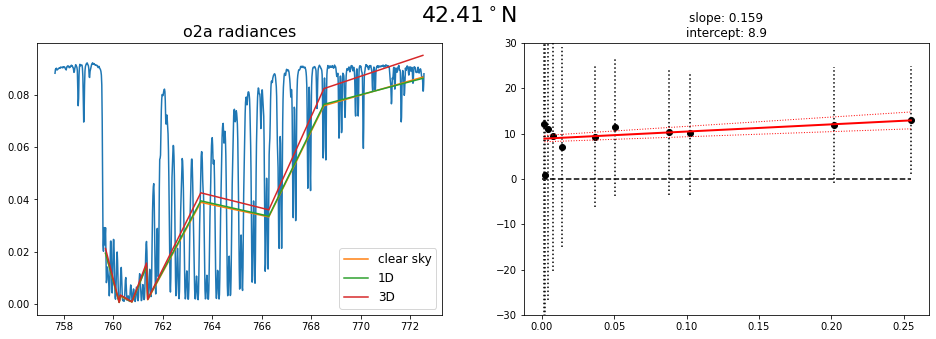

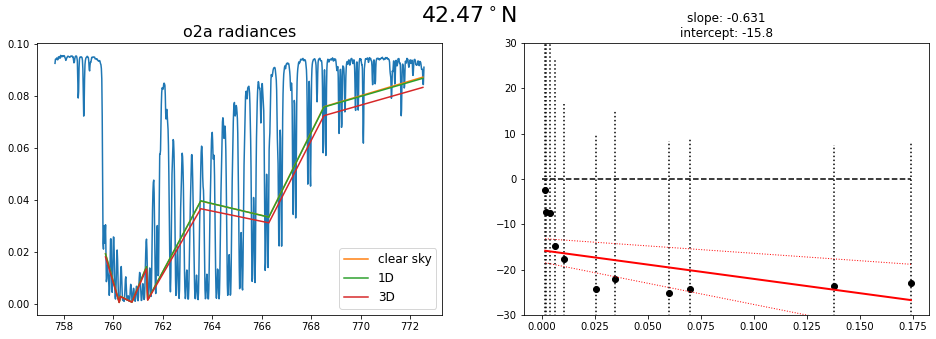

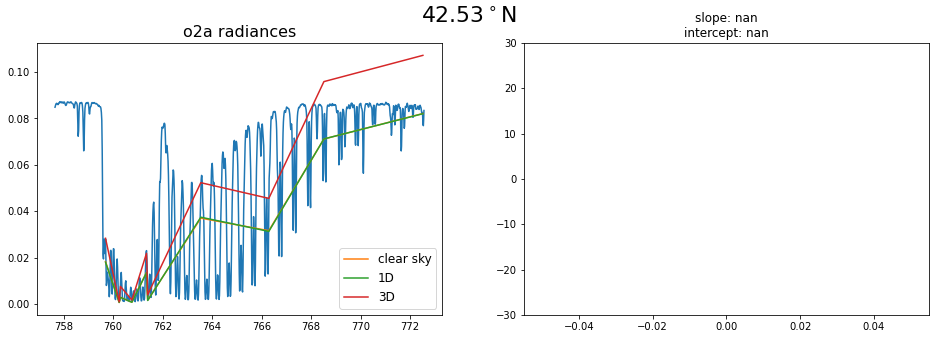

In [278]:
for i in range(0, o1.lon.shape[0],3):
    f, (ax0, ax1) = plt.subplots(1, 2, figsize=(16,5,))
    f.patch.set_facecolor('white')
    #plt.subplots_adjust(hspace=0.3)
    f.suptitle(f'{o1.lat[i, 0]:.2f}$^\circ$N', fontsize=22)
    j = 4
    ax0.plot(o1.wvl[i, j, :], o1.l1b[i, j, :])
    ax0.plot(o1.lam, o1.rad_1km_clr[i, j, :], label='clear sky')
    ax0.plot(o1.lam, o1.rad_1km_c1d[i, j, :], label='1D')
    ax0.plot(o1.lam, o1.rad_1km_c3d[i, j, :], label='3D')
    ax0.set_title('o2a radiances', fontsize=16)
    ax0.legend(fontsize=12)
    plot_perturbation_1km(o1, i, 1, frame=ax1)
    #o1.plot_perturbation(i, 1, frame=ax1)
    plt.show()

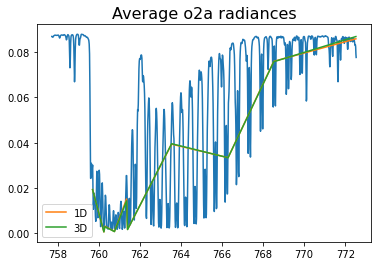

In [47]:
OCO_class_list = [o1]#, o2, o3]
title_list = ['Average o2a radiances','Average wco2 radiances','Average sco2 radiances']

for i in range(1):
    c1d_mean, c3d_mean, l1b_mean = [], [], []
    c1d_std, c3d_std = [], []
    for wvl_index in range(11):
        var_o = OCO_class_list[i]
        lon_list = var_o.lon[:, :].flatten(order='F')
        lon_select = var_o.lon[:, :].flatten(order='F')
        lat_select = var_o.lat[:, :].flatten(order='F')
        qf_select = qf_array[:, :, 0].flatten(order='F')
        l1b_wvl = var_o.wvl[0,3,3:-3]
        c1d_mean.append(var_o.c1d[:, :, wvl_index].mean())
        c3d_mean.append(var_o.c3d[:, :, wvl_index].mean())
        c1d_std.append(var_o.c1d[:, :, wvl_index].std())
        c3d_std.append(var_o.c3d[:, :, wvl_index].std())
    for ww in l1b_wvl:
        for j in range(8):
            wv_index = np.argmin(np.abs(ww-var_o.wvl[0,j,:]))        
            if j==0:
                y2 = var_o.l1b[:, j, wv_index]  
            else:
                y2 = np.append(y2, var_o.l1b[:, j, wv_index])   
        l1b_mean.append(np.mean(y2))
        
    plt.plot(l1b_wvl, l1b_mean)
    #plt.plot(o1.lam, o1.clr.mean(axis=(0,1)), label='clear sky')
    plt.plot(var_o.lam, c1d_mean, label='1D')
    plt.plot(var_o.lam, c3d_mean, label='3D')
    plt.legend()
    plt.title(title_list[i], fontsize=16)
    plt.show()
    plt.close()

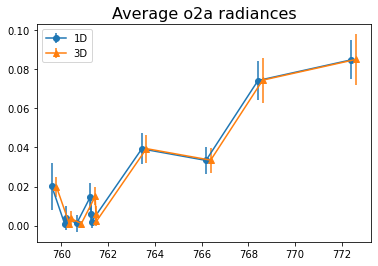

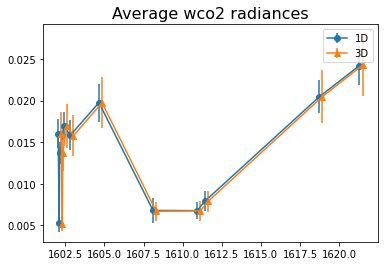

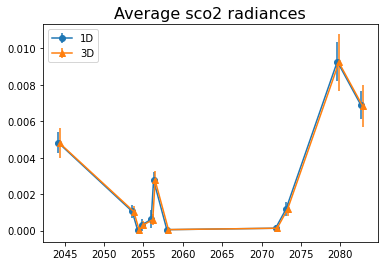

In [306]:
OCO_class_list = [o1, o2, o3]
title_list = ['Average o2a radiances','Average wco2 radiances','Average sco2 radiances']

for i in range(3):
    c1d_mean, c3d_mean, l1b_mean = [], [], []
    c1d_std, c3d_std = [], []
    for wvl_index in range(11):
        var_o = OCO_class_list[i]
        lon_list = var_o.lon[:, :].flatten(order='F')
        lon_select = var_o.lon[:, :].flatten(order='F')
        lat_select = var_o.lat[:, :].flatten(order='F')
        qf_select = qf_array[:, :, 0].flatten(order='F')
        l1b_wvl = var_o.wvl[0,3,3:-3]
        c1d_mean.append(var_o.c1d[:, :, wvl_index].mean())
        c3d_mean.append(var_o.c3d[:, :, wvl_index].mean())
        c1d_std.append(var_o.c1d[:, :, wvl_index].std())
        c3d_std.append(var_o.c3d[:, :, wvl_index].std())
    for ww in l1b_wvl:
        for j in range(8):
            wv_index = np.argmin(np.abs(ww-var_o.wvl[0,j,:]))        
            if j==0:
                y2 = var_o.l1b[:, j, o1_wv_index]  
            else:
                y2 = np.append(y2, var_o.l1b[:, j, wv_index])   
        l1b_mean.append(np.mean(y2))
        
    #plt.plot(l1b_wvl, l1b_mean)
    #plt.plot(o1.lam, o1.clr.mean(axis=(0,1)), label='clear sky')
    plt.errorbar(var_o.lam-0.1, c1d_mean, yerr=c1d_std, label='1D', marker='o')
    plt.errorbar(var_o.lam+0.1, c3d_mean, yerr=c3d_std, label='3D', marker='^')
    plt.legend()
    plt.title(title_list[i], fontsize=16)
    plt.show()
    plt.close()

Text(0.5, 1.0, 'Average o2a radiances')

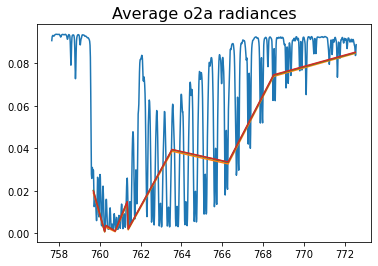

In [103]:
plt.plot(o1.wvl.mean(axis=(0,1)), o1.l1b.mean(axis=(0,1)))
plt.plot(o1.lam, o1.clr.mean(axis=(0,1)), label='clear sky')
plt.plot(o1.lam, o1.c1d.mean(axis=(0,1)), label='1D')
plt.plot(o1.lam, o1.c3d.mean(axis=(0,1)), label='3D')
plt.title('Average o2a radiances', fontsize=16)

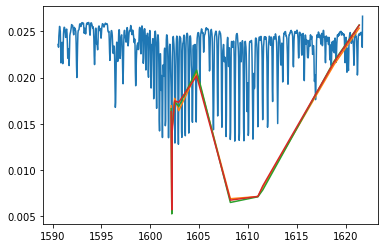

In [93]:
plt.plot(o2.wvl[30,0,:], o2.l1b[30,0,:])
plt.plot(o2.lam, o2.clr[30, 0, :], label='clear sky')
plt.plot(o2.lam, o2.c1d[30, 0, :], label='1D')
plt.plot(o2.lam, o2.c3d[30, 0, :], label='3D')

Text(0.5, 1.0, 'Average wco2 radiances')

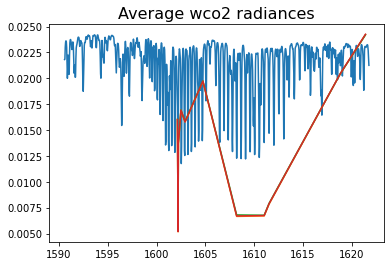

In [105]:
plt.plot(o2.wvl.mean(axis=(0,1)), o2.l1b.mean(axis=(0,1)))
plt.plot(o2.lam, o2.clr.mean(axis=(0,1)), label='clear sky')
plt.plot(o2.lam, o2.c1d.mean(axis=(0,1)), label='1D')
plt.plot(o2.lam, o2.c3d.mean(axis=(0,1)), label='3D')
plt.title('Average wco2 radiances', fontsize=16)

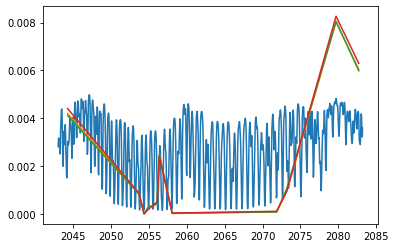

In [91]:
plt.plot(o3.wvl[0,0,:], o3.l1b[0,0,:])
plt.plot(o3.lam, o3.clr[0, 0, :], label='clear sky')
plt.plot(o3.lam, o3.c1d[0, 0, :], label='1D')
plt.plot(o3.lam, o3.c3d[0, 0, :], label='3D')

Text(0.5, 1.0, 'Average sco2 radiances')

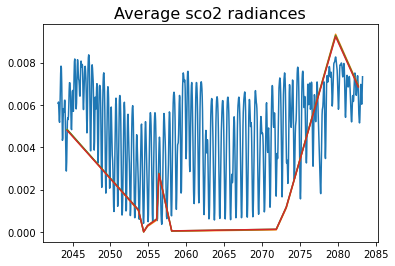

In [104]:
plt.plot(o3.wvl.mean(axis=(0,1)), o3.l1b.mean(axis=(0,1)))
plt.plot(o3.lam, o3.clr.mean(axis=(0,1)), label='clear sky')
plt.plot(o3.lam, o3.c1d.mean(axis=(0,1)), label='1D')
plt.plot(o3.lam, o3.c3d.mean(axis=(0,1)), label='3D')
plt.title('Average sco2 radiances', fontsize=16)

In [121]:
clr_obs_diff, c1d_obs_diff, c3d_obs_diff = np.zeros_like(o1.c3d), np.zeros_like(o1.c3d), np.zeros_like(o1.c3d)
c1d_clr_diff, c3d_clr_diff = np.zeros_like(o1.c3d), np.zeros_like(o1.c3d)
for i in range(o1.lon.shape[0]):
    for j in range(o1.lon.shape[1]):
        wv_index_list = []
        for w in range(11):
            index = np.argmin(np.abs(o1.lam[w]-o1.wvl[i,j,:]))
            clr_obs_diff[i, j, w] = o1.clr[i, j, w] - o1.l1b[i, j, index]
            c1d_obs_diff[i, j, w] = o1.c1d[i, j, w] - o1.l1b[i, j, index]
            c3d_obs_diff[i, j, w] = o1.c3d[i, j, w] - o1.l1b[i, j, index]
            c1d_clr_diff[i, j, w] = o1.c1d[i, j, w] - o1.l1b[i, j, w]
            c3d_clr_diff[i, j, w] = o1.c3d[i, j, w] - o1.l1b[i, j, w]

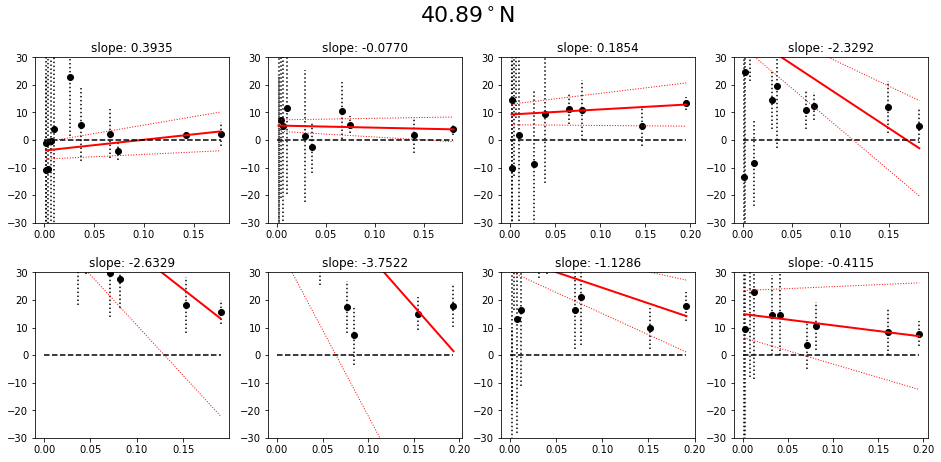

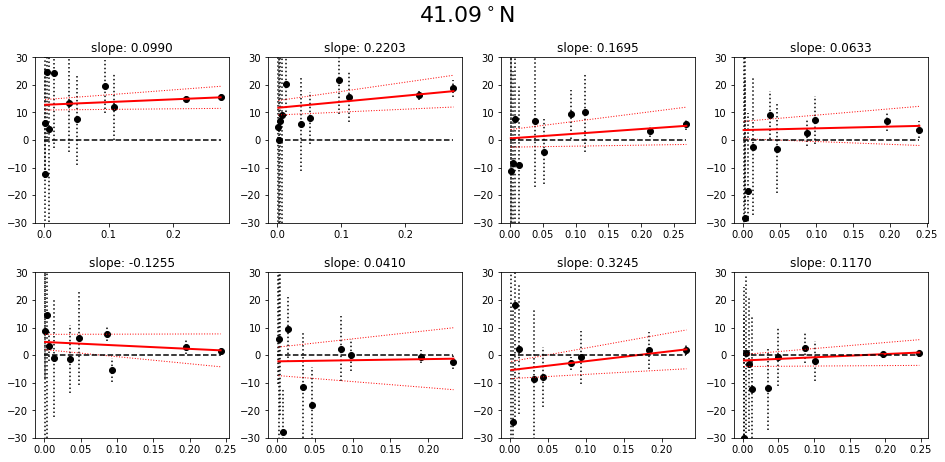

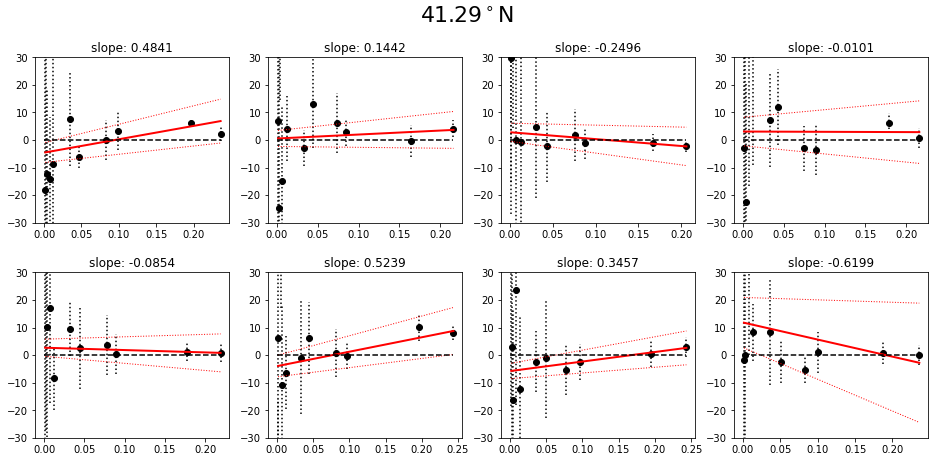

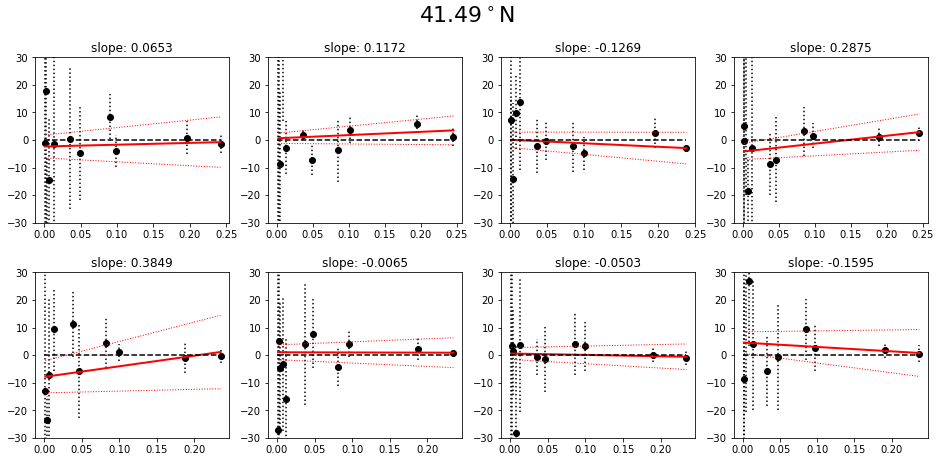

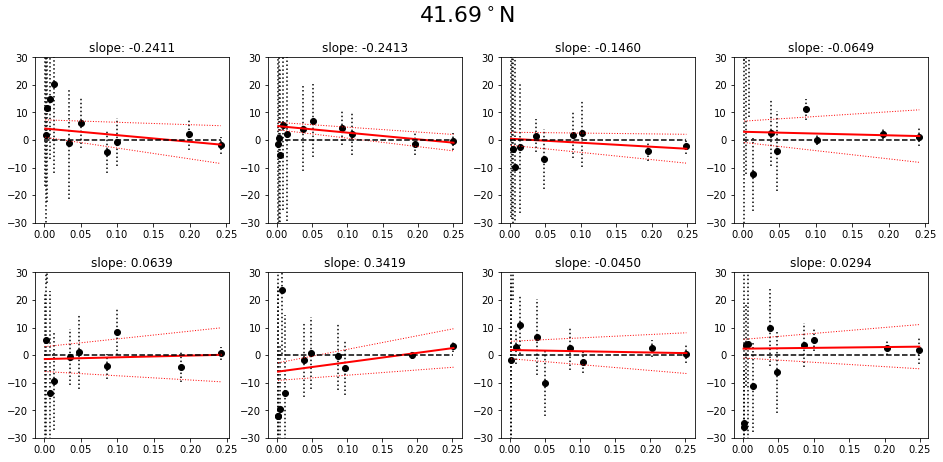

...

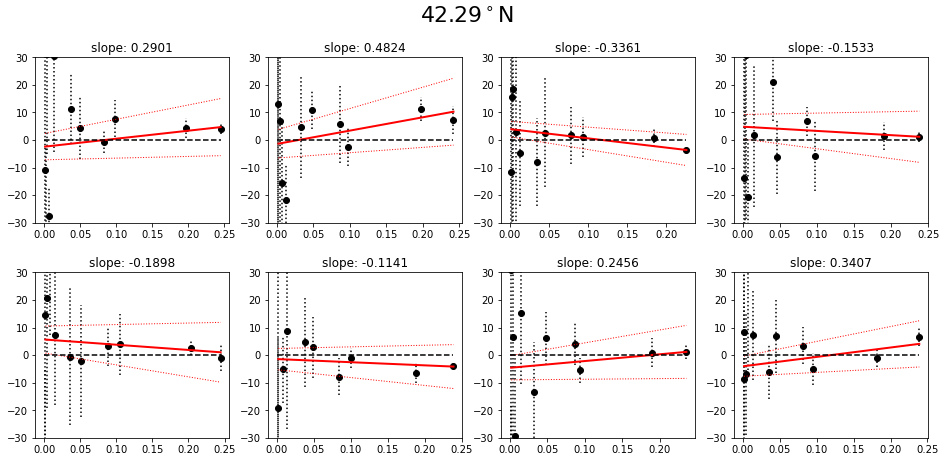

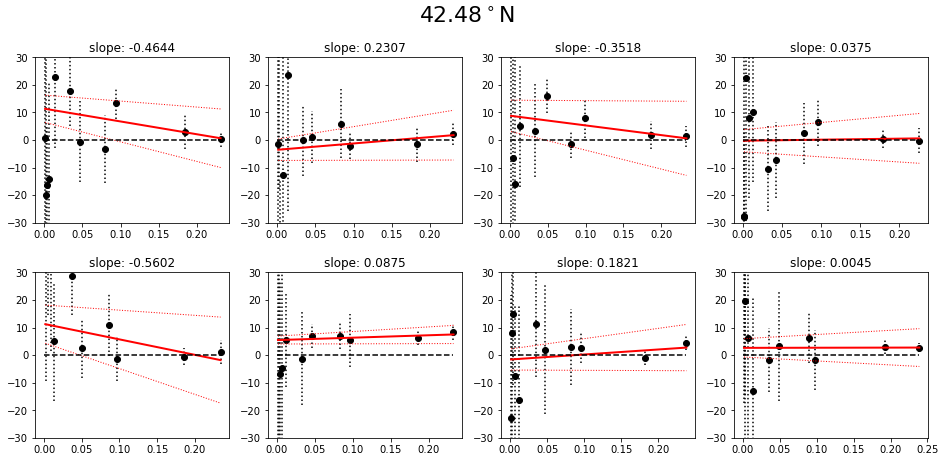

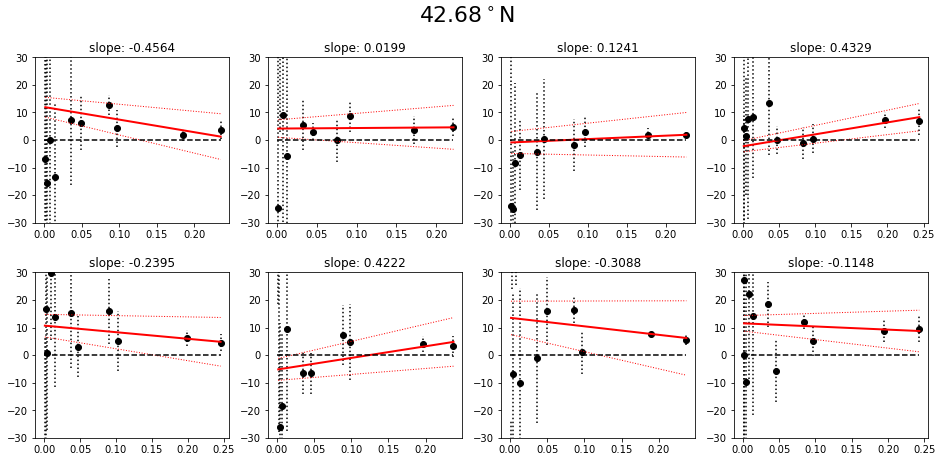

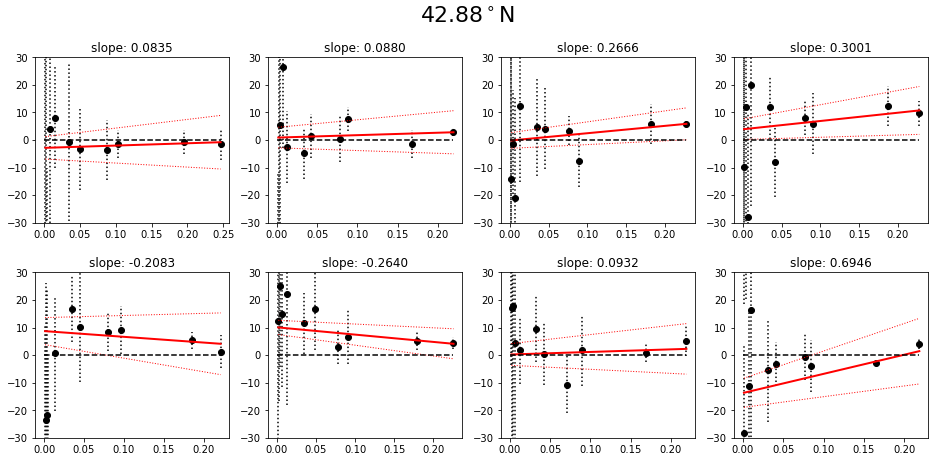

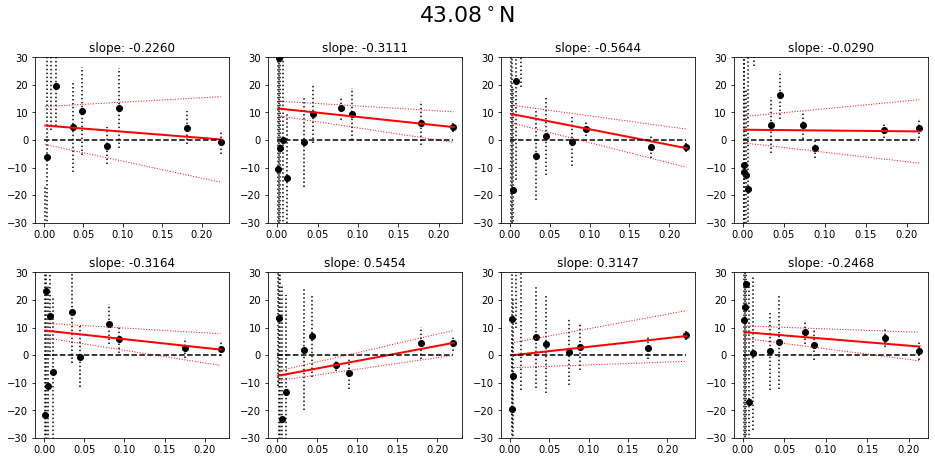

In [144]:
for i in range(0, o1.lon.shape[0],10):
    f, ((ax00, ax01, ax02, ax03),
        (ax10, ax11, ax12, ax13)) = plt.subplots(2, 4, figsize=(16, 7))
    f.patch.set_facecolor('white')
    plt.subplots_adjust(hspace=0.3)
    for j in range(8):
        ax = [ax00, ax01, ax02, ax03, ax10, ax11, ax12, ax13][j]
        o1.plot_perturbation(i, j, frame=ax)
    f.suptitle(f'{o1.lat[i, 3]:.2f}$^\circ$N', fontsize=22)
    plt.show()

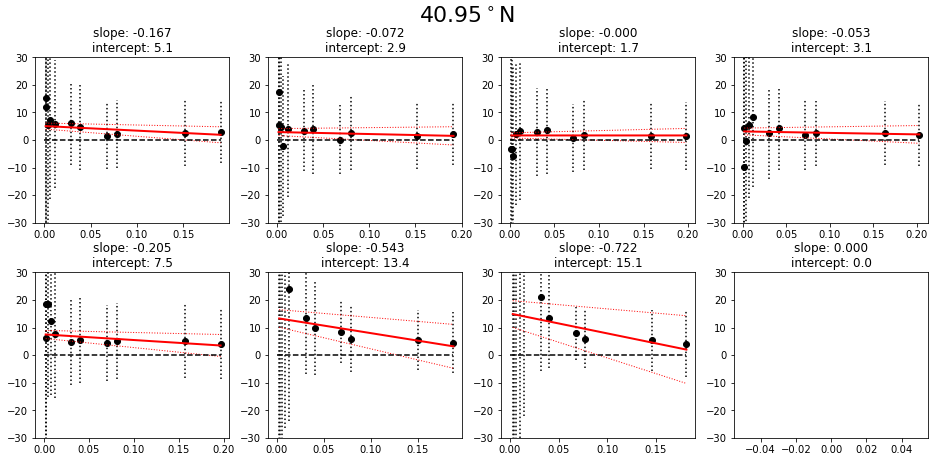

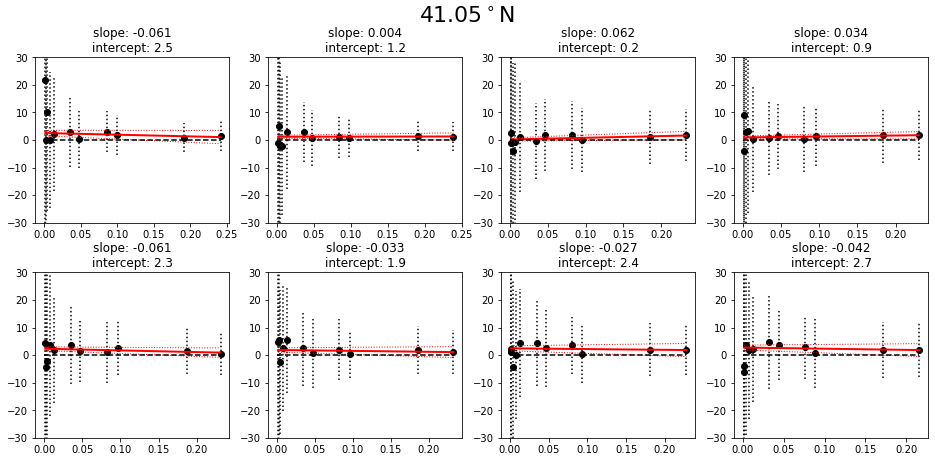

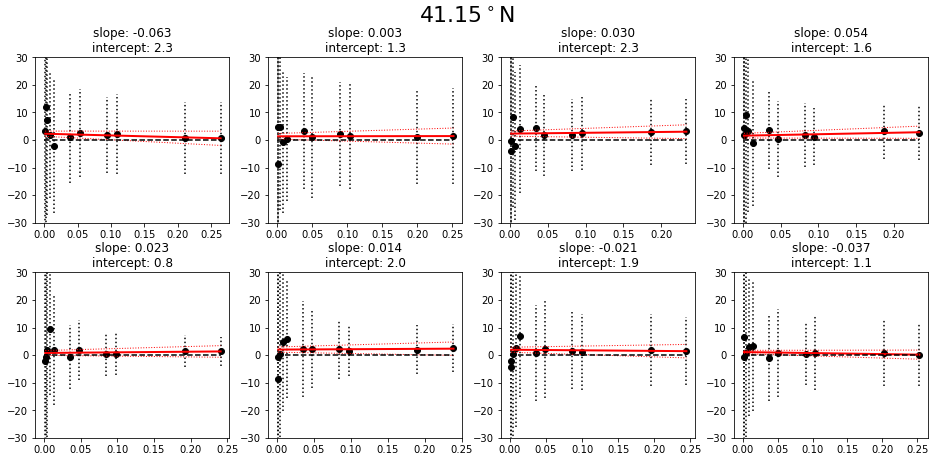

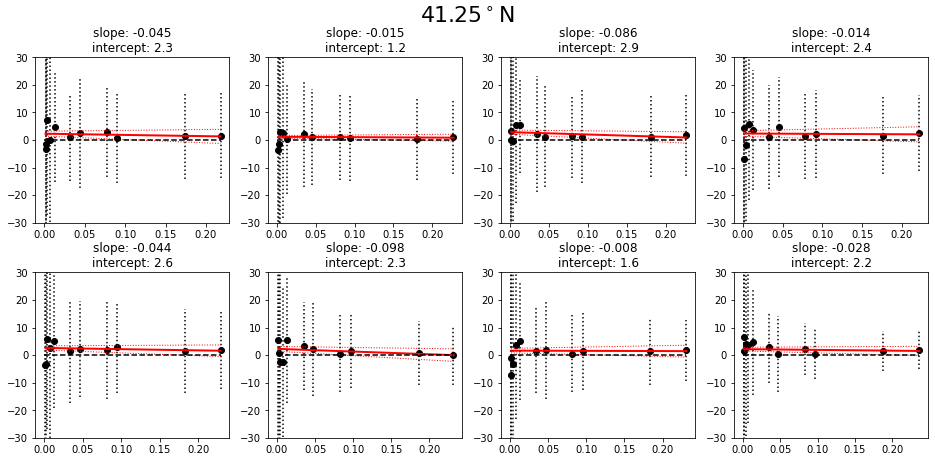

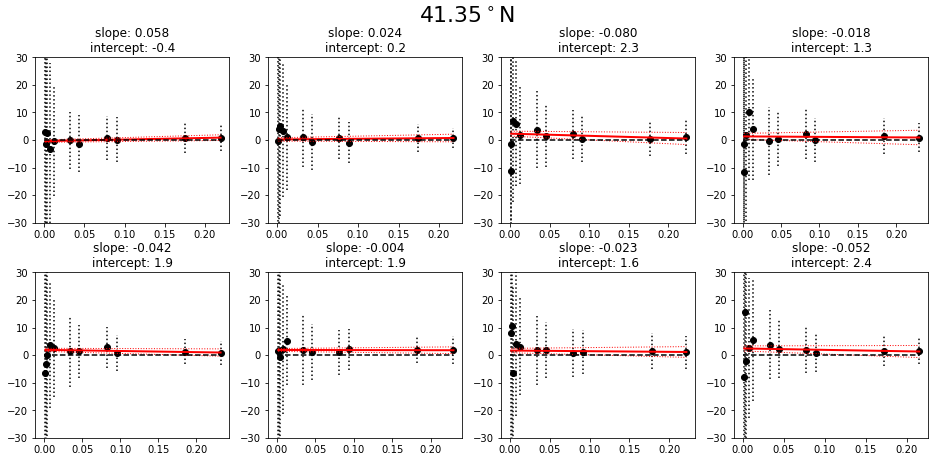

...

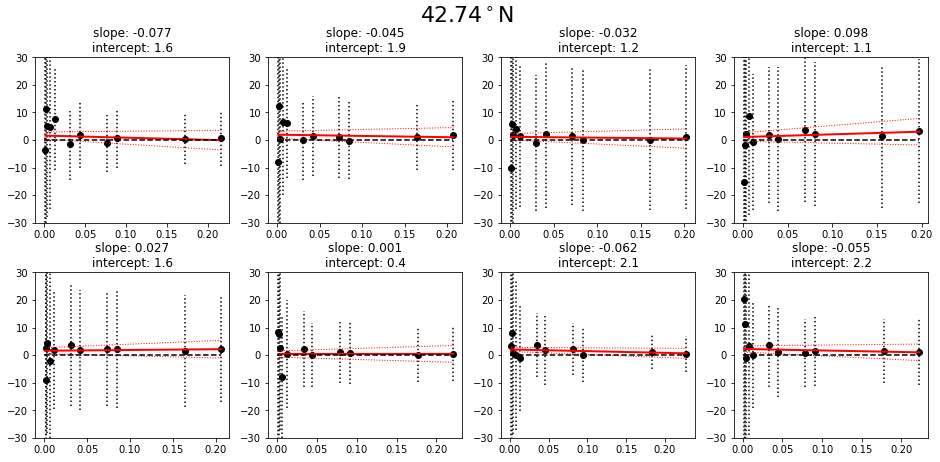

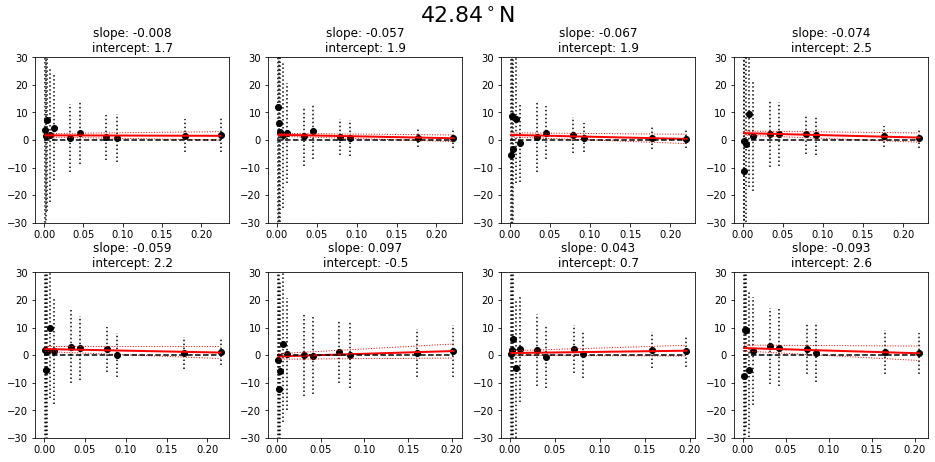

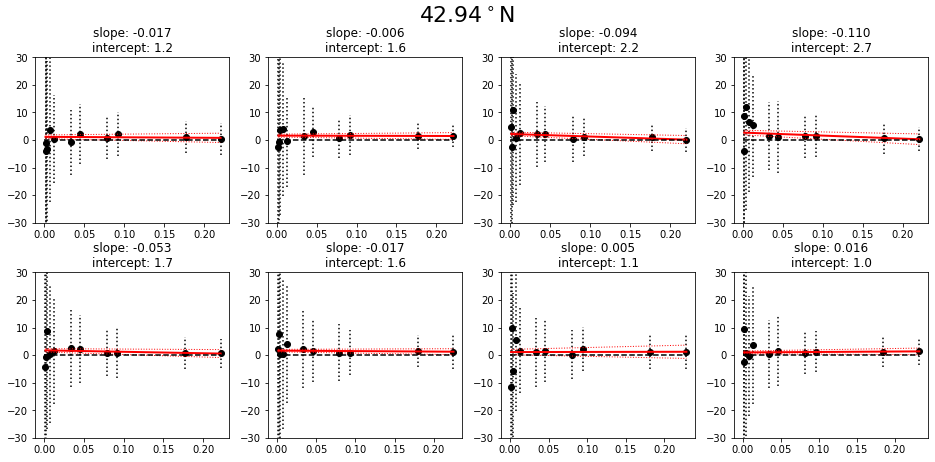

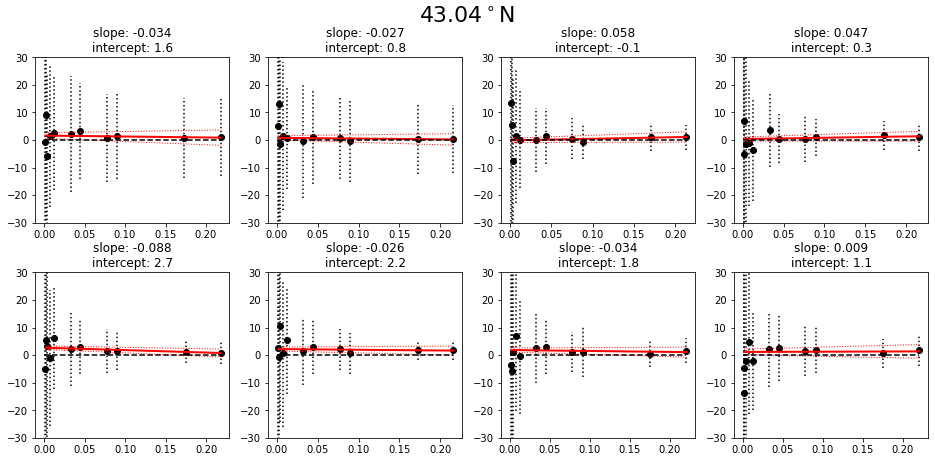

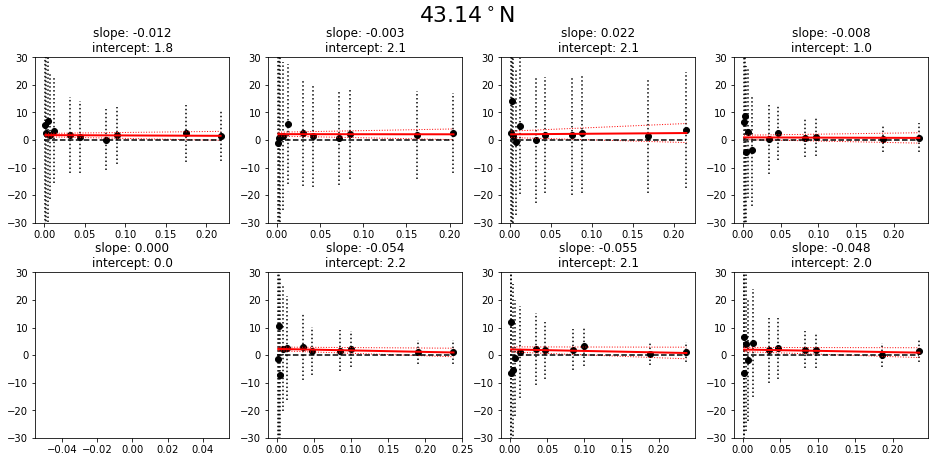

In [153]:
for i in range(3, o1.lon.shape[0],5):
    f, ((ax00, ax01, ax02, ax03),
        (ax10, ax11, ax12, ax13)) = plt.subplots(2, 4, figsize=(16, 7))
    f.patch.set_facecolor('white')
    plt.subplots_adjust(hspace=0.3)
    for j in range(8):
        ax = [ax00, ax01, ax02, ax03, ax10, ax11, ax12, ax13][j]
        plot_perturbation_1km(o1, i, j, frame=ax)
    f.suptitle(f'{o1.lat[i, 3]:.2f}$^\circ$N', fontsize=22)
    plt.show()

In [19]:
qf_array_flat = qf_array.reshape((len(o1.snd.flatten()), 3))
cld_array_flat = cld_array.reshape((len(o1.snd.flatten()), 4))

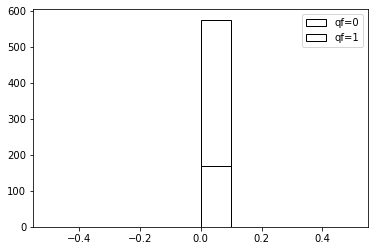

In [20]:
qf1_mask = qf_array_flat[:, 0] == 1
qf0_mask = qf_array_flat[:, 0] == 0
plt.hist(cld_array_flat[qf0_mask, 3], label='qf=0', fill=False)
plt.hist(cld_array_flat[qf1_mask, 3], label='qf=1', fill=False)
plt.legend()
plt.show()

In [21]:
def sort_remove_duplicate(array_1d):
    # creates an array of indices, sorted by unique element
    idx_sort = np.argsort(array_1d)

    # sorts records array so all unique elements are together 
    sorted_records_array = array_1d[idx_sort]

    # returns the unique values, the index of the first occurrence of a value, and the count for each element
    vals, idx_start, count = np.unique(sorted_records_array, return_counts=True, return_index=True)

    # splits the indices into separate arrays
    res = np.split(idx_sort, idx_start[1:])

    for i in range(len(res)):
        res[i] = res[i][0]
    return np.array(res)

In [28]:
res = sort_remove_duplicate(OCO_class.lat.flatten())
    if qf != None:
        if qf == 0:
            res = res[qf_array[:, 0]==0]
        elif qf == 1:
            res = res[qf_array[:, 0]==1]
        else:
            print('Error: qf must be 0 or 1!')
            return None
    reshape_len = OCO_class.lat.shape[0]*OCO_class.lat.shape[1]
    OCO_class_lon = OCO_class.lon.flatten()[res]

NameError: name 'OCO_class' is not defined

In [22]:
qf0 = qf_array[:, :, 0]==0
lon_list = o1.lon[:, :].flatten()
select_index = sort_remove_duplicate(lon_list)
lon_select = o1.lon[:, :].flatten()[select_index]
lat_select = o1.lat[:, :].flatten()[select_index]
qf_select = qf_array[:, :, 0].flatten()[select_index]
cloud_select = cld_array[:, :, 0].flatten()[select_index]
y1 = o1.slope_1km[:, :, 0].flatten()[select_index]
y2 = o1.slope_25p[:, :, 0].flatten()[select_index]
df = pd.DataFrame(np.array([lon_select, lat_select, qf_select, cloud_select, y1, y2]).T, 
                  columns=['lon', 'lat', 'qf', 'cloud_dis', 'slope_1km', 'slope_25p'])

In [23]:
df

,lon,lat,qf,cloud_dis,slope_1km,slope_25p
0,55.609459,43.223713,NaN,0.0,0.000000,0.000000
1,55.616299,43.203903,NaN,0.0,-0.141428,-0.163599
2,55.618076,43.216099,NaN,0.0,NaN,-0.163599
3,55.623085,43.184048,1.0,0.0,-0.115230,-0.055293
4,55.624908,43.196289,1.0,0.0,-0.099584,-0.091087
...,...,...,...,...,...,...
929,56.417309,40.888203,NaN,0.0,0.000000,0.000000
930,56.418335,40.900059,NaN,0.0,0.000000,0.000000
931,56.423714,40.868294,NaN,0.0,0.000000,0.000000
932,56.424725,40.880142,NaN,0.0,0.000000,0.000000


In [24]:
x = np.mean(np.array([lat_range[:-1], lat_range[1:]]), axis=0)
df[df.qf==0].groupby(pd.cut(df[df.qf==0]['lat'], lat_range)).mean()['slope_1km']

ValueError: bins must increase monotonically.

In [25]:
np.array(df[df.qf==0].groupby(pd.cut(df[df.qf==0]['lat'], lat_range)).mean()['slope_1km'])

ValueError: bins must increase monotonically.

In [174]:
#o1.lam[10]#-
o1.wvl[0,0,:]

array([757.66397438, 757.68145892, 757.69893798, ..., 772.55425406,
       772.56612993, 772.57799999])

In [266]:
test = var_o.l1b[:5, :3, 0]#.flatten()
test

array([[0.00281228, 0.00216548, 0.00299545],
       [0.00463535, 0.00429246, 0.00475709],
       [0.00502737, 0.00544119, 0.00547174],
       [0.00513544, 0.00472853, 0.00396241],
       [0.00549703, 0.0051446 , 0.00469676]], dtype=float32)

In [270]:
test.flatten(order='F')

array([0.00281228, 0.00463535, 0.00502737, 0.00513544, 0.00549703,
       0.00216548, 0.00429246, 0.00544119, 0.00472853, 0.0051446 ,
       0.00299545, 0.00475709, 0.00547174, 0.00396241, 0.00469676],
      dtype=float32)

In [269]:
np.append(np.append(test[:,0], test[:,1]), test[:,2])

array([0.00281228, 0.00463535, 0.00502737, 0.00513544, 0.00549703,
       0.00216548, 0.00429246, 0.00544119, 0.00472853, 0.0051446 ,
       0.00299545, 0.00475709, 0.00547174, 0.00396241, 0.00469676],
      dtype=float32)

In [259]:
np.argmin(np.abs(o1.lam[wvl_index]-o1.wvl[0,0,:]))

697

In [264]:
np.argmin(np.abs(o1.lam[wvl_index]-o1.wvl[,0,:]))

697

In [257]:
rad = []
for i in [80]:#range(o1.wvl.shape[0]):
    for j in range(8):
        #print(np.argmin(np.abs(o1.lam[wvl_index]-o1.wvl[i,j,:])))
        rad.append(o1.l1b[i,j, np.argmin(np.abs(o1.lam[wvl_index]-o1.wvl[i,j,:]))])
print(np.mean(rad), '+/-', np.std(rad))
print(np.std(rad)/np.mean(rad)*100)

0.07206385 +/- 0.0029053264
4.031600430607796


In [192]:
combine_df.to_csv('slope_comparison.csv', na_rep=np.nan)

In [183]:
snd_list

array([2015062217261905, 2015062217261933, 2015062217261934,
       2015062217261935, 2015062217261937, 2015062217261973,
       2015062217261974, 2015062217262004, 2015062217262171,
       2015062217262172, 2015062217262201, 2015062217262202,
       2015062217262203, 2015062217262232, 2015062217262233,
       2015062217262274, 2015062217262275, 2015062217262277,
       2015062217262337, 2015062217262338, 2015062217262533,
       2015062217262575, 2015062217262576, 2015062217262608,
       2015062217262637, 2015062217262675, 2015062217262676,
       2015062217262677, 2015062217260731, 2015062217260732,
       2015062217260772, 2015062217260773, 2015062217260774,
       2015062217260775, 2015062217260804, 2015062217260805,
       2015062217260806, 2015062217260831, 2015062217260837,
       2015062217260838, 2015062217260937, 2015062217260973,
       2015062217260974, 2015062217260975, 2015062217260976,
       2015062217260977, 2015062217260978, 2015062217261008,
       2015062217261137,

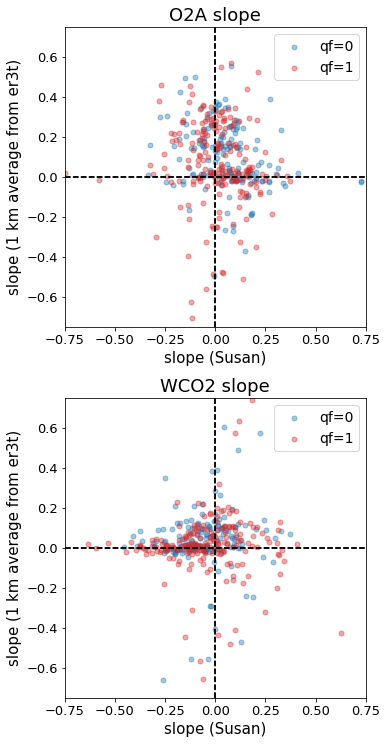

In [194]:
fig, (ax11, ax21) = plt.subplots(2, 1, figsize=(6, 11), sharex=False)
fig.tight_layout(pad=5.0)
light_jet = cm.jet#cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
ax_list = [ax11, ax21]
title_size = 18
label_size = 15
tick_size = 13
cloud_label = ['Cloud distance (km)', 'Cloud distance (km)']
xy_list = [('r', 'g'), ('r', 'b'), ('r', 'r/g'), ('r', 'r/b')]
qf0 = qf_array[:, :, 0]==0
qf1 = qf_array[:, :, 0]==1
OCO_class_list = [o1, o2]
#ax11.scatter(cld_array[:, :, 0][qf0], o1.slope_1km[:, :, 0][qf0], s=25, marker='o', alpha=0.5, label='1 km points (qf=0)')
#ax21.scatter(cld_array[:, :, 0][qf0], o2.slope_1km[:, :, 0][qf0], s=25, marker='o', alpha=0.5, label='s25 points (qf=0)')
susan_col = ['o2a_slope', 'wco2_sope']
color_list= ['tab:blue', 'tab:red']
#cld = cld_array[:, :, 0][qf0]
for qf_flag in [0, 1]:
    for i in range(2):
        x, y = [], []
        qf = qf_array[:, :, 0]==qf_flag
        ax = ax_list[i]
        var_o = OCO_class_list[i]
        # plot figure

        snd_list = var_o.snd[qf]
        slope_1km = var_o.slope_1km[:, :, 0][qf]
        for j in range(len(snd_list)):
            if snd_list[j] in list(susan_slope.index):
                x.append(susan_slope.loc[snd_list[j]][susan_col[i]])
                y.append(slope_1km[j])
        mask = ~np.isnan(x) & ~np.isnan(y)
        ax.scatter(x, y, s=25, marker='o', color=color_list[qf_flag], label=f'qf={qf_flag}', alpha=0.4)

        ax.set_ylabel('slope (1 km average from er3t)', fontsize=label_size)
        ax.set_xlabel('slope (Susan)', fontsize=label_size)
        #ax.set_xticks(range(0, 160, 20))
        ax.xaxis.set_tick_params(labelsize=tick_size)
        ax.yaxis.set_tick_params(labelsize=tick_size)

        ymin, ymax = -0.75, 0.75
        xmin, xmax = -0.75, 0.75
        ax.plot([xmin, xmax],[0,0],'k--')
        ax.plot([0, 0],[ymin, ymax],'k--')
        ax.set_ylim(ymin, ymax)
        ax.set_xlim(xmin, xmax)
        #ax.text((xmin+(xmax-xmin)*0.45), (ymin+(ymax-ymin)*0.1),
        #        f'y = {a:.2f} x exp(-{b:.2f}x)', fontsize=14)
        #ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')
        #ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
        #        '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')
        if qf_flag ==1:
            ax.legend(fontsize=14)
#ax11.set_ylabel('O2A slope', fontsize=label_size)
#ax21.set_ylabel('WCO2 slope', fontsize=label_size)
ax11.set_title('O2A slope', fontsize=title_size)
ax21.set_title('WCO2 slope', fontsize=title_size)
#fig.suptitle('qf=0', y=1.01, fontsize=title_size+2)
plt.show()

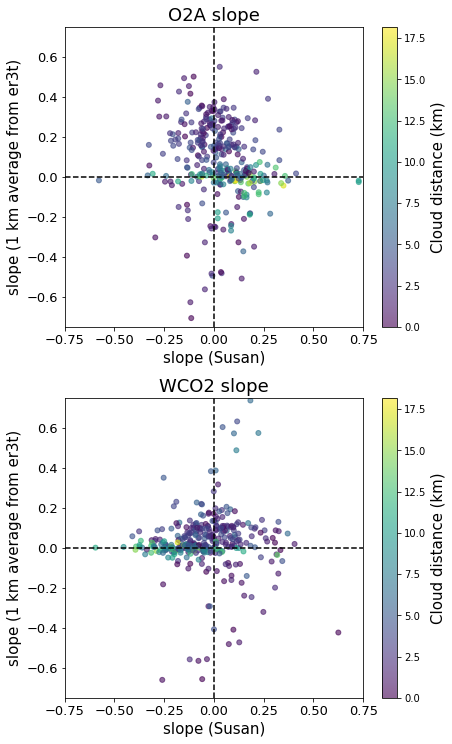

In [193]:
fig, (ax11, ax21) = plt.subplots(2, 1, figsize=(7, 11), sharex=False)
fig.tight_layout(pad=5.0)
light_jet = cm.jet#cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
ax_list = [ax11, ax21]
title_size = 18
label_size = 15
tick_size = 13
cloud_label = ['Cloud distance (km)', 'Cloud distance (km)']
xy_list = [('r', 'g'), ('r', 'b'), ('r', 'r/g'), ('r', 'r/b')]
qf0 = qf_array[:, :, 0]==0
qf1 = qf_array[:, :, 0]==1
OCO_class_list = [o1, o2]
#ax11.scatter(cld_array[:, :, 0][qf0], o1.slope_1km[:, :, 0][qf0], s=25, marker='o', alpha=0.5, label='1 km points (qf=0)')
#ax21.scatter(cld_array[:, :, 0][qf0], o2.slope_1km[:, :, 0][qf0], s=25, marker='o', alpha=0.5, label='s25 points (qf=0)')
susan_col = ['o2a_slope', 'wco2_sope']
color_list= ['tab:blue', 'tab:red']
#
for i in range(2):
    x, y = [], []
    dis = []
    qf = np.logical_or(qf_array[:, :, 0]==0, qf_array[:, :, 0]==1)
    cld = cld_array[:, :, 0][qf]
    ax = ax_list[i]
    var_o = OCO_class_list[i]
    # plot figure

    snd_list = var_o.snd[qf]
    slope_1km = var_o.slope_1km[:, :, 0][qf]
    for j in range(len(snd_list)):
        if snd_list[j] in list(susan_slope.index):
            x.append(susan_slope.loc[snd_list[j]][susan_col[i]])
            y.append(slope_1km[j])
            dis.append(cld[j])
    mask = ~np.isnan(x) & ~np.isnan(y)
    sca = ax.scatter(x, y, s=25, marker='o', c=dis, alpha=0.6)

    ax.set_ylabel('slope (1 km average from er3t)', fontsize=label_size)
    ax.set_xlabel('slope (Susan)', fontsize=label_size)
    #ax.set_xticks(range(0, 160, 20))
    ax.xaxis.set_tick_params(labelsize=tick_size)
    ax.yaxis.set_tick_params(labelsize=tick_size)

    ymin, ymax = -0.75, 0.75
    xmin, xmax = -0.75, 0.75
    ax.plot([xmin, xmax],[0,0],'k--')
    ax.plot([0, 0],[ymin, ymax],'k--')
    ax.set_ylim(ymin, ymax)
    ax.set_xlim(xmin, xmax)
    #ax.text((xmin+(xmax-xmin)*0.45), (ymin+(ymax-ymin)*0.1),
    #        f'y = {a:.2f} x exp(-{b:.2f}x)', fontsize=14)
    #ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')
    #ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
    #        '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')
    cbar = fig.colorbar(sca, ax=ax)#, location='bottom')
    cbar.set_label('Cloud distance (km)', fontsize=15)
#ax11.set_ylabel('O2A slope', fontsize=label_size)
#ax21.set_ylabel('WCO2 slope', fontsize=label_size)
ax11.set_title('O2A slope', fontsize=title_size)
ax21.set_title('WCO2 slope', fontsize=title_size)
#fig.suptitle('qf=0', y=1.01, fontsize=title_size+2)
plt.show()

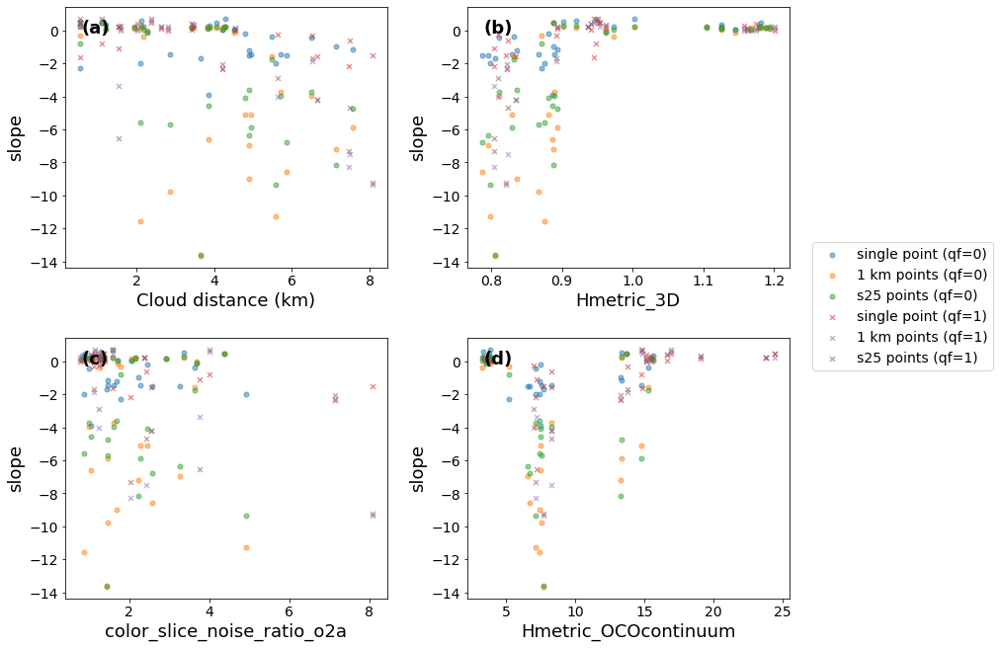

In [62]:
fig, ((ax11, ax12), (ax21, ax22)) = plt.subplots(2, 2, figsize=(12, 10), sharex=False)
fig.tight_layout(pad=5.0)
light_jet = cm.jet#cmap_map(lambda x: x/3 + 0.66, cm.jet)
subfig_index = ['a', 'b', 'c', 'd', 'e', 'f']
ax_list = [ax11, ax12, ax21, ax22]
label_size = 18
tick_size = 14
cloud_label = ['Cloud distance (km)', 'Hmetric_3D', 'color_slice_noise_ratio_o2a', 'Hmetric_OCOcontinuum']
xy_list = [('r', 'g'), ('r', 'b'), ('r', 'r/g'), ('r', 'r/b')]
qf0 = qf_array[:, :, 0]==0
qf1 = qf_array[:, :, 0]==1
for i in range(4):
    ax = ax_list[i]

    # plot figure
    #OCO_class.slope[i,j,:]
                #slope_1km, slope_1km_std = OCO_class.slope_1km[i, j, :]
                #slope_25p, slope_25p_std = OCO_class.slope_25p[i, j, :]
    ax.scatter(cld_array[:, :, i][qf0], o1.slope[:, :, 0][qf0], s=25, marker='o', alpha=0.5, label='single point (qf=0)')
    ax.scatter(cld_array[:, :, i][qf0], o1.slope_1km[:, :, 0][qf0], s=25, marker='o', alpha=0.5, label='1 km points (qf=0)')
    ax.scatter(cld_array[:, :, i][qf0], o1.slope_25p[:, :, 0][qf0], s=25, marker='o', alpha=0.5, label='s25 points (qf=0)')
    
    ax.scatter(cld_array[:, :, i][qf1], o1.slope[:, :, 0][qf1], s=25, marker='x', alpha=0.5, label='single point (qf=1)')
    ax.scatter(cld_array[:, :, i][qf1], o1.slope_1km[:, :, 0][qf1], s=25, marker='x', alpha=0.5, label='1 km points (qf=1)')
    ax.scatter(cld_array[:, :, i][qf1], o1.slope_25p[:, :, 0][qf1], s=25, marker='x', alpha=0.5, label='s25 points (qf=1)')
    
    """
    ax.plot(x_array, x_array, 'r', label='ideal')
    slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)
    ax.plot(x_array, x_array*slope+intercept, 'b', label='prediction')
    """
    ax.set_ylabel('slope', fontsize=label_size)
    ax.set_xlabel(cloud_label[i], fontsize=label_size)
    #ax.set_xticks(range(0, 160, 20))
    ax.xaxis.set_tick_params(labelsize=tick_size)
    ax.yaxis.set_tick_params(labelsize=tick_size)
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()
    
    #ymin, ymax = -1.5, 1.5
    """if ymax>3.8:
        ymax = 3.8
        ax.set_ylim(ymin, ymax)
    if ymin<-0.2:
        ymin = -0.2
        
        ax.set_ylim(ymin, ymax)"""
    ax.set_ylim(ymin, ymax)
    #ax.plot([-1, 1, 1, -1, -1], [-1, -1, 1, 1, -1], 'k-')
    ax.text((xmin+(xmax-xmin)*0.05), (ymin+(ymax-ymin)*0.9),
            '({})'.format(subfig_index[i]), fontsize=18, fontweight='bold')
    if i ==1:
        ax.legend(loc='center left', bbox_to_anchor=(1.05, -0.15), fontsize=14)

In [68]:
def plot_slope_comparison(OCO_class, z, fp, frame1, frame2, frame3, band, show_cat=False):


    frame1.plot(OCO_class.c3d[z,fp,:]/OCO_class.toa*np.pi,OCO_class.sl[z,fp,:]*100,'ko')    
    for l,wl in enumerate(OCO_class.lam):
        frame1.plot([OCO_class.c3d[z,fp,l]/OCO_class.toa[l]*np.pi,OCO_class.c3d[z,fp,l]/OCO_class.toa[l]*np.pi],
                 np.array([OCO_class.sl[z,fp,l]-OCO_class.sls[z,fp,l],
                           OCO_class.sl[z,fp,l]+OCO_class.sls[z,fp,l]])*100,'k:')        
    slope,slopes         = OCO_class.slope[z,fp,:]
    intercept,intercepts = OCO_class.inter[z,fp,:]
    mn = np.min(OCO_class.c3d[z,fp,:]/OCO_class.toa[:]*np.pi)
    mx = np.max(OCO_class.c3d[z,fp,:]/OCO_class.toa[:]*np.pi)
    xx=np.linspace(mn,mx,10)
    yy=intercept+slope*xx
    y1=intercept+intercepts+(slope+slopes)*xx
    y2=intercept-intercepts+(slope-slopes)*xx
    frame1.plot(xx,yy*100,'r-',linewidth=2)  
    frame1.plot(xx,y1*100,'r:',linewidth=1)  
    frame1.plot(xx,y2*100,'r:',linewidth=1)  
    frame1.plot([0,mx],[0,0],'k--')
    # ywc added
    if show_cat:
        frame1.set_title('Single point\n{} slope: {:.3f}, std/slope: {:.1f}%'.format(band, slope, abs(slopes/slope*100)))
    else:
        frame1.set_title('{} slope: {:.3f}, std/slope: {:.1f}%'.format(band, slope, abs(slopes/slope*100)))
    frame1.set_ylim(-30, 30)



    frame2.plot(OCO_class.rad_1km_c3d[z,fp,:]/OCO_class.toa*np.pi,OCO_class.sl_1km[z,fp,:]*100,'ko')    
    for l,wl in enumerate(OCO_class.lam):
        frame2.plot([OCO_class.rad_1km_c3d[z,fp,l]/OCO_class.toa[l]*np.pi,OCO_class.rad_1km_c3d[z,fp,l]/OCO_class.toa[l]*np.pi],
                 np.array([OCO_class.sl_1km[z,fp,l]-OCO_class.sls_1km[z,fp,l],
                           OCO_class.sl_1km[z,fp,l]+OCO_class.sls_1km[z,fp,l]])*100,'k:')        
    slope,slopes         = OCO_class.slope_1km[z,fp,:]
    intercept,intercepts = OCO_class.inter_1km[z,fp,:]
    mn = np.min(OCO_class.rad_1km_c3d[z,fp,:]/OCO_class.toa[:]*np.pi)
    mx = np.max(OCO_class.rad_1km_c3d[z,fp,:]/OCO_class.toa[:]*np.pi)
    xx=np.linspace(mn,mx,10)
    yy=intercept+slope*xx
    y1=intercept+intercepts+(slope+slopes)*xx
    y2=intercept-intercepts+(slope-slopes)*xx
    frame2.plot(xx,yy*100,'r-',linewidth=2)  
    frame2.plot(xx,y1*100,'r:',linewidth=1)  
    frame2.plot(xx,y2*100,'r:',linewidth=1)  
    frame2.plot([0,mx],[0,0],'k--')
    # ywc added
    if show_cat:
        frame2.set_title('Multiple points within 1 km\n{} slope: {:.3f}, std/slope: {:.1f}%'.format(band, slope, abs(slopes/slope*100)))
    else:
        frame2.set_title('{} slope: {:.3f}, std/slope: {:.1f}%'.format(band, slope, abs(slopes/slope*100)))
    frame2.set_ylim(-30, 30)




    frame3.plot(OCO_class.rad_25p_c3d[z,fp,:]/OCO_class.toa*np.pi,OCO_class.sl_25p[z,fp,:]*100,'ko')    
    for l,wl in enumerate(OCO_class.lam):
        frame3.plot([OCO_class.rad_25p_c3d[z,fp,l]/OCO_class.toa[l]*np.pi,OCO_class.rad_25p_c3d[z,fp,l]/OCO_class.toa[l]*np.pi],
                 np.array([OCO_class.sl_25p[z,fp,l]-OCO_class.sls_25p[z,fp,l],
                           OCO_class.sl_25p[z,fp,l]+OCO_class.sls_25p[z,fp,l]])*100,'k:')        
    slope,slopes         = OCO_class.slope_25p[z,fp,:]
    intercept,intercepts = OCO_class.inter_25p[z,fp,:]
    mn = np.min(OCO_class.rad_25p_c3d[z,fp,:]/OCO_class.toa[:]*np.pi)
    mx = np.max(OCO_class.rad_25p_c3d[z,fp,:]/OCO_class.toa[:]*np.pi)
    xx=np.linspace(mn,mx,10)
    yy=intercept+slope*xx
    y1=intercept+intercepts+(slope+slopes)*xx
    y2=intercept-intercepts+(slope-slopes)*xx
    frame3.plot(xx,yy*100,'r-',linewidth=2)  
    frame3.plot(xx,y1*100,'r:',linewidth=1)  
    frame3.plot(xx,y2*100,'r:',linewidth=1)  
    frame3.plot([0,mx],[0,0],'k--')
    # ywc added
    if show_cat:
        frame3.set_title('25 nearest points\n{} slope: {:.3f}, std/slope: {:.1f}%'.format(band, slope, abs(slopes/slope*100)))
    else:
        frame3.set_title('{} slope: {:.3f}, std/slope: {:.1f}%'.format(band, slope, abs(slopes/slope*100)))
    frame3.set_ylim(-30, 30)

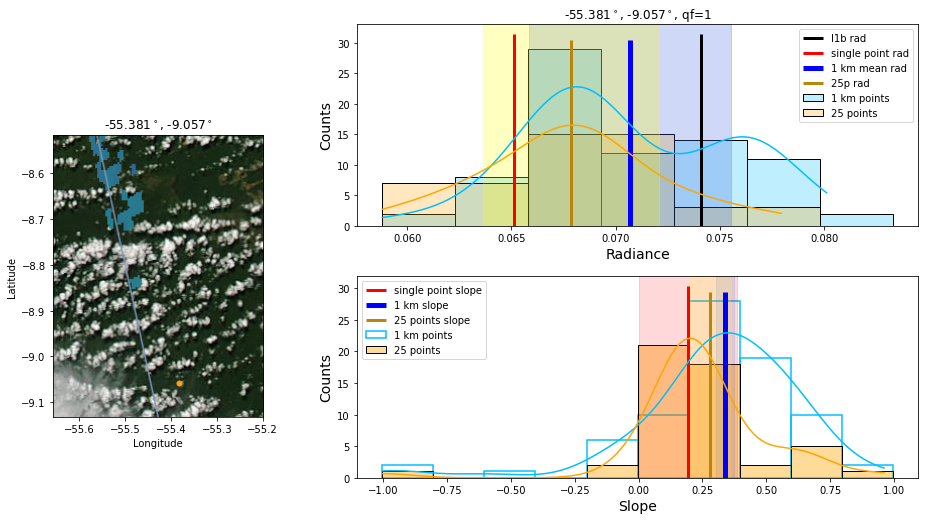

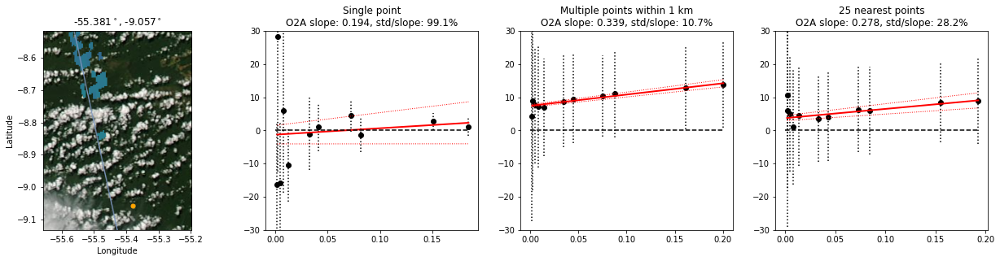

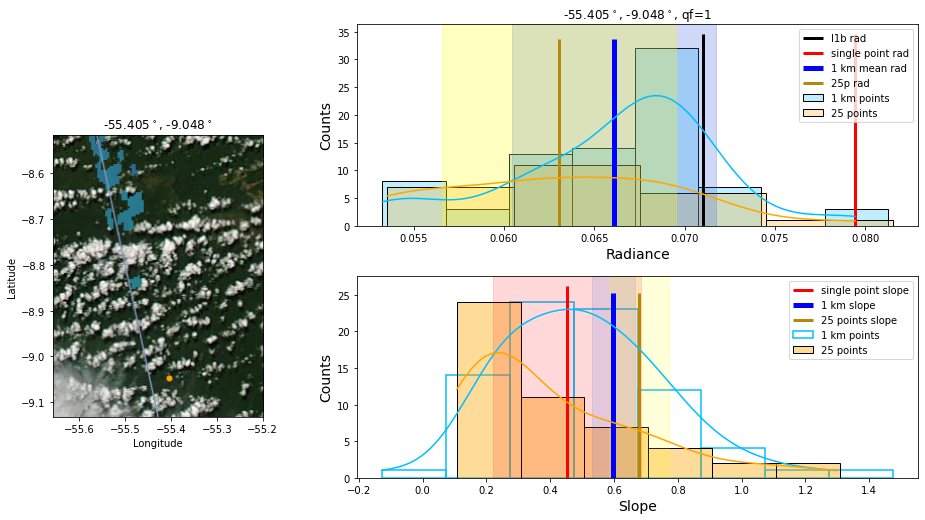

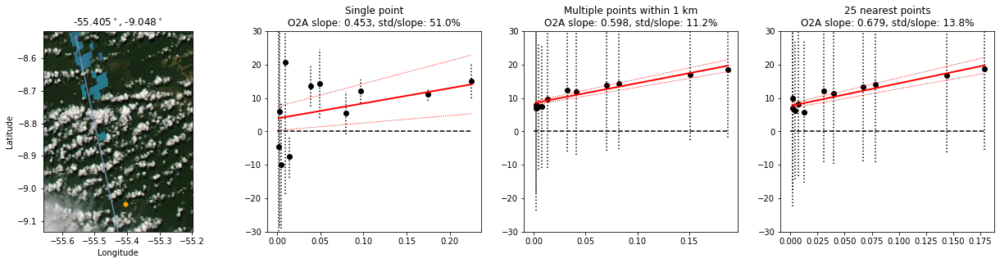

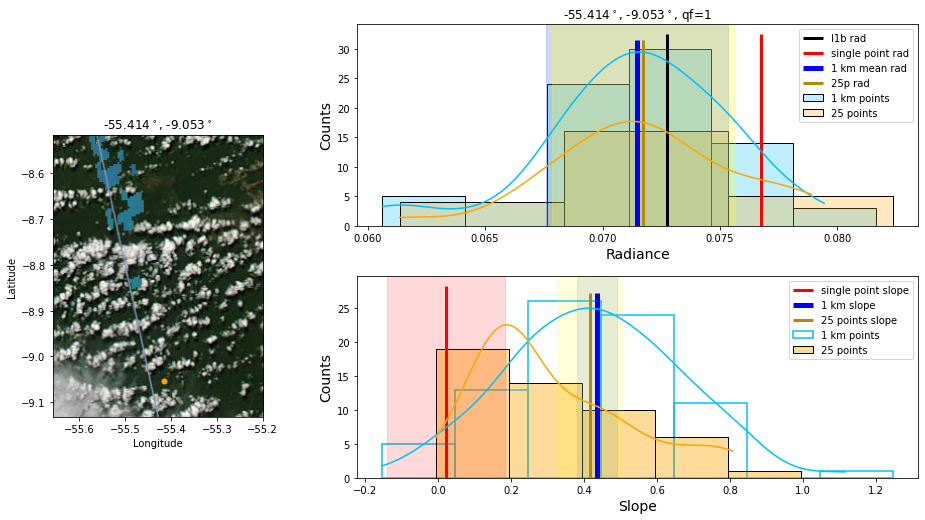

...

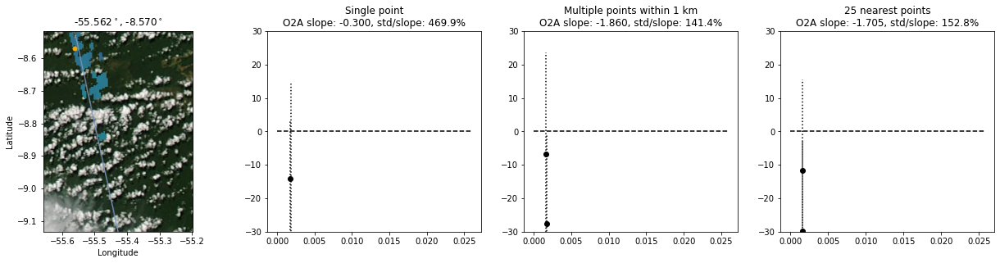

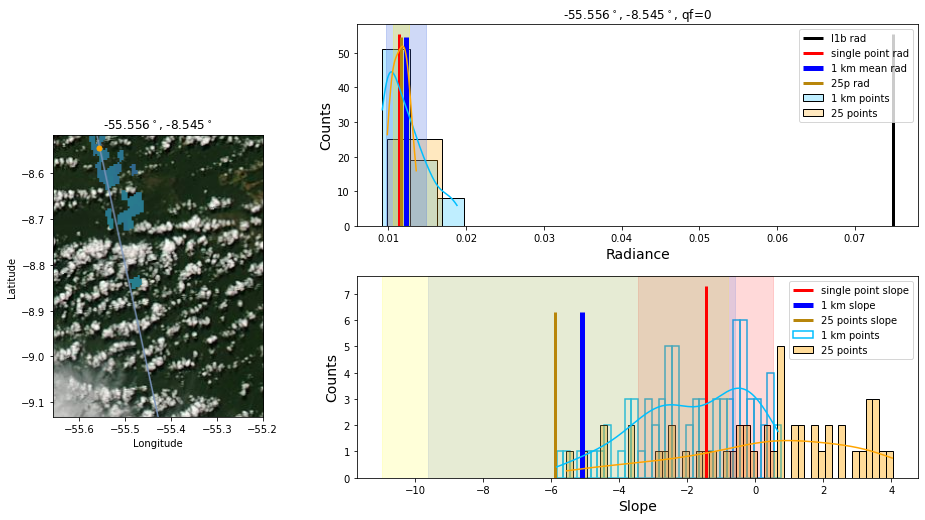

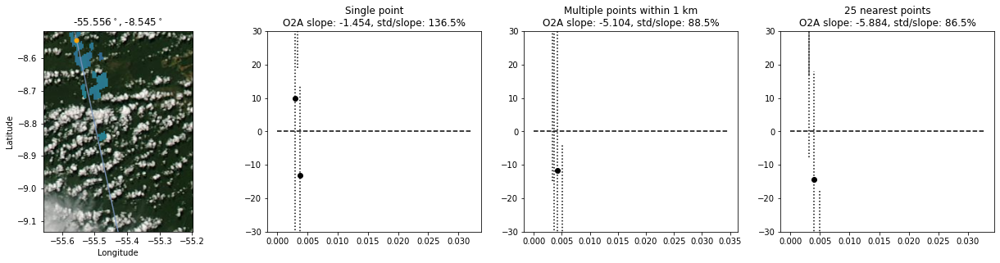

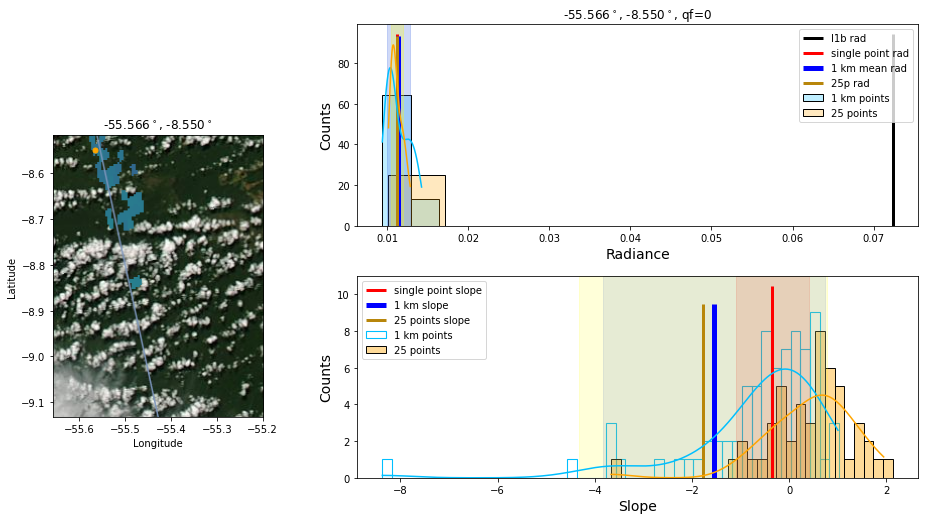

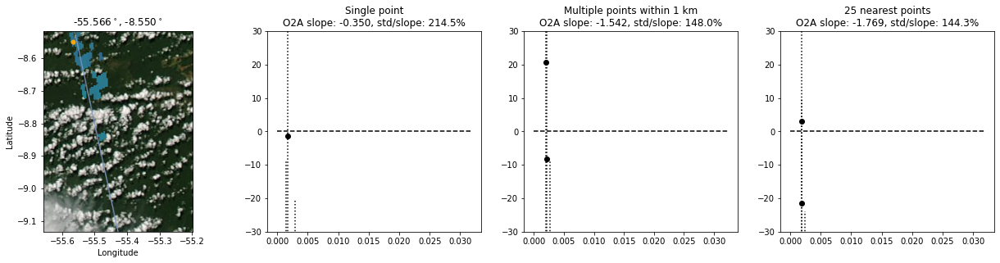

In [81]:
OCO_class = o1
qf0_rad_l1b, qf0_rad_sin = [], []
qf0_rad_1km, qf0_rad_1km_std = [], []
qf0_rad_25p, qf0_rad_25p_std = [], []
qf1_rad_l1b, qf1_rad_sin = [], []
qf1_rad_1km, qf1_rad_1km_std = [], []
qf1_rad_25p, qf1_rad_25p_std = [], []

qf0_sin_slope, qf0_sin_slope_std = [], []
qf1_sin_slope, qf1_sin_slope_std = [], []
qf0_1km_slope, qf0_1km_slope_std = [], []
qf1_1km_slope, qf1_1km_slope_std = [], []
qf0_25p_slope, qf0_25p_slope_std = [], []
qf1_25p_slope, qf1_25p_slope_std = [], []
    
for i in range(OCO_class.lat.shape[0]):
    for j in range(OCO_class.lat.shape[1]):
        if ~ np.isnan(OCO_class.co2[i, j]):
            lon0 = OCO_class.lon[i, j]
            lat0 = OCO_class.lat[i, j]    
            snd = OCO_class.snd[i, j]
            if snd in lite_snd_list:
                index = np.where(lite_snd_list == snd)[0][0]
                xco2_qf = np.float(lite.xco2_quality_flag[select][index])
            index_lon = np.argmin(np.abs(OCO_class.lon2d[:, 0]-lon0))
            index_lat = np.argmin(np.abs(OCO_class.lat2d[0, :]-lat0))

            center = (lon0, lat0)
            tmp_clr, tmp_c1d, tmp_c3d = [], [], []
            tmp_clrs, tmp_c1ds, tmp_c3ds = [], [], []
            tmp_slope = []
            test_range = (np.arange(-10, 10+1))
            count = 0
            for x in test_range:
                for y in test_range:
                    try:
                        interest_loc = (OCO_class.lon2d[index_lon+x, 0], OCO_class.lat2d[0, index_lat+y])
                        if geopy.distance.distance(center, interest_loc).km <= 1.0:

                            tmp_clr.append(OCO_class.rad_clr[index_lon+x, index_lat+y])
                            tmp_c1d.append(OCO_class.rad_c1d[index_lon+x, index_lat+y])
                            tmp_c3d.append(OCO_class.rad_c3d[index_lon+x, index_lat+y])
                            tmp_clrs.append(OCO_class.rad_clrs[index_lon+x, index_lat+y])
                            tmp_c1ds.append(OCO_class.rad_c1ds[index_lon+x, index_lat+y])
                            tmp_c3ds.append(OCO_class.rad_c3ds[index_lon+x, index_lat+y])
                            tmp_slope.append(OCO_class.slope_all[index_lon+x, index_lat+y, 0])
                            count += 1
                    except:
                        None
            if count>0:
                
                
                fig = plt.figure(figsize=(13, 7))
                ax0 = fig.add_axes([0.05, 0.05, 0.225, 0.8])
                ax1 = fig.add_axes([0.375, 0.55, 0.6, 0.4])
                ax2 = fig.add_axes([0.375, 0.05, 0.6, 0.4])
                #ax3 = fig.add_axes([0.05, 0.025, 0.9, 0.1])
                
                
                ax0.imshow(img,extent=wesn)
                lon_dom = OCO_class.dom[:2]
                lat_dom = OCO_class.dom[2:]
                ax0.set_xlim(np.min(lon_dom), np.max(lon_dom))
                ax0.set_ylim(np.min(lat_dom), np.max(lat_dom))
                ax0.scatter(OCO_class.lon[i, j], OCO_class.lat[i, j], s=25, color='orange')
                ax0.set_xlabel('Longitude')
                ax0.set_ylabel('Latitude')
                ax0.set_title('{:.3f}$^\circ$, {:.3f}$^\circ$'.format(OCO_class.lon[i, j], OCO_class.lat[i, j]))
                
                label_size = 14
                rad_l1b = OCO_class.l1b[i,j, 10]
                rad_sin = OCO_class.c3d[i,j, 10]
                #sin_slope, sin_slope_std = OCO_class.slope[i,j,:]
                #slope_1km, slope_1km_std    = OCO_class.slope_1km[i, j, :]
                bd=0.0035
                sns.histplot(np.array(tmp_c3d)[:, 10].flatten(), kde=True, fill=True, ax=ax1, alpha=0.25,
                             binwidth=bd, color='deepskyblue', label='1 km points')
                sns.histplot(np.array(OCO_class.rad_c3d[index_lon-2:index_lon+3,
                                                          index_lat-2:index_lat+3, 10]).flatten(),
                             binwidth=bd*2, kde=True, fill=True, ax=ax1, alpha=0.25, color='orange', label='25 points')



                ax1.set_xlabel('Radiance', fontsize=label_size)
                ax1.set_ylabel('Counts', fontsize=label_size)
                ymin, ymax = ax1.get_ylim()
                
                ax1.vlines(rad_l1b, ymin, ymax+1, 'k', linewidth=3, label='l1b rad')
                ax1.vlines(rad_sin, ymin, ymax+1, 'r', linewidth=3, label='single point rad')
                rad_1k_mean = np.nanmean(np.array(tmp_c3d), axis=0)[10]
                rad_1k_std = np.nanstd(np.array(tmp_c3d), axis=0)[10]
                rad_25p_array = OCO_class.rad_c3d[index_lon-2:index_lon+3, index_lat-2:index_lat+3, 10].flatten()
                rad_25p_mean = np.nanmean(rad_25p_array)
                rad_25p_std = np.nanstd(rad_25p_array)
                ax1.vlines(rad_1k_mean, ymin, ymax, 'blue', linewidth=5, label='1 km mean rad')
                ax1.axvspan(rad_1k_mean-rad_1k_std, rad_1k_mean+rad_1k_std, alpha=0.25, color='royalblue')
                ax1.vlines(rad_25p_mean, ymin, ymax, 'darkgoldenrod', linewidth=3, label='25p rad')
                ax1.axvspan(rad_25p_mean-rad_25p_std, rad_25p_mean+rad_25p_std, alpha=0.25, color='yellow')
                ax1.legend()
                ax1.set_title(f'{OCO_class.lon[i, j]:.3f}$^\circ$, {OCO_class.lat[i, j]:.3f}$^\circ$, qf={int(xco2_qf)}')
                sin_slope, sin_slope_std = OCO_class.slope[i,j,:]
                slope_1km, slope_1km_std = OCO_class.slope_1km[i, j, :]
                slope_25p, slope_25p_std = OCO_class.slope_25p[i, j, :]
                
                bd2=0.2
                sns.histplot(np.array(tmp_slope), kde=True, fill=False, ax=ax2,
                             binwidth=bd2, color='deepskyblue', label='1 km points')
                sns.histplot(np.array(OCO_class.slope_all[index_lon-2:index_lon+3,
                                                          index_lat-2:index_lat+3]).flatten(),
                             binwidth=bd2, kde=True, fill=True, alpha=0.4,
                             ax=ax2, color='orange', label='25 points')

                ymin, ymax = ax2.get_ylim()

                ax2.set_xlabel('Slope', fontsize=label_size)
                ax2.set_ylabel('Counts', fontsize=label_size)
                
                ax2.vlines(sin_slope, ymin, ymax+1, 'r', linewidth=3, label='single point slope')
                ax2.axvspan(sin_slope-sin_slope_std, sin_slope+sin_slope_std, alpha=0.15, color='r')
                ax2.vlines(slope_1km, ymin, ymax, 'blue', linewidth=5, label='1 km slope')
                ax2.axvspan(slope_1km-slope_1km_std, slope_1km+slope_1km_std, alpha=0.15, color='royalblue')
                ax2.vlines(slope_25p, ymin, ymax, 'darkgoldenrod', linewidth=3, label='25 points slope')
                ax2.axvspan(slope_25p-slope_25p_std, slope_25p+slope_25p_std, alpha=0.15, color='yellow')
                #ax2.set_xlim(-2, 2)
                ax2.legend()
                plt.show()
                
            fig, axs = plt.subplots(1, 4, figsize=(21.5, 4.5))
            (frame00, frame01, frame02, frame03) = axs
            #gs = axs[0, 2].get_gridspec()
            # remove the underlying axes
            #frame00.remove()
            #frame20.remove()
            axbig = frame00#fig.add_subplot(gs[:, 0])
            
            img = png[0]
            wesn= png[1]
            img = mpimg.imread(img)
            axbig.imshow(img,extent=wesn)
            lon_dom = o1.dom[:2]
            lat_dom = o1.dom[2:]
            axbig.set_xlim(np.min(lon_dom), np.max(lon_dom))
            axbig.set_ylim(np.min(lat_dom), np.max(lat_dom))
            axbig.scatter(o1.lon[i, j], o1.lat[i, j], s=25, color='orange')

            axbig.set_xlabel('Longitude')
            axbig.set_ylabel('Latitude')
            axbig.set_title('{:.3f}$^\circ$, {:.3f}$^\circ$'.format(o1.lon[i, j], o1.lat[i, j]))
            #frame10.remove()
            
            plot_slope_comparison(o1, i, j, frame01, frame02, frame03, 'O2A', show_cat=True)
            #plot_slope_comparison(o2, i, j, frame11, frame12, frame13, 'WCO2')
            #plot_slope_comparison(o3, i, j, frame21, frame22, frame23, 'SCO2')
            
            plt.show()
            
            if xco2_qf == 0:
                qf0_rad_l1b.append(rad_l1b)
                qf0_rad_sin.append(rad_sin)
                qf0_rad_1km.append(rad_1k_mean)
                qf0_rad_1km_std.append(rad_1k_std)
                qf0_rad_25p.append(rad_25p_mean)
                qf0_rad_25p_std.append(rad_25p_std)
                qf0_sin_slope.append(sin_slope)
                qf0_sin_slope_std.append(sin_slope_std)
                qf0_1km_slope.append(slope_1km)
                qf0_1km_slope_std.append(slope_1km_std)
                qf0_25p_slope.append(slope_25p)
                qf0_25p_slope_std.append(slope_25p_std)
            elif xco2_qf == 1:
                qf1_rad_l1b.append(rad_l1b)
                qf1_rad_sin.append(rad_sin)
                qf1_rad_1km.append(rad_1k_mean)
                qf1_rad_1km_std.append(rad_1k_std)
                qf1_rad_25p.append(rad_25p_mean)
                qf1_rad_25p_std.append(rad_25p_std)
                qf1_sin_slope.append(sin_slope)
                qf1_sin_slope_std.append(sin_slope_std)
                qf1_1km_slope.append(slope_1km)
                qf1_1km_slope_std.append(slope_1km_std)
                qf1_25p_slope.append(slope_25p)
                qf1_25p_slope_std.append(slope_25p_std)

In [ ]:
for i in range(o1.lat.shape[0]):
    for j in range(o1.lat.shape[1]):
        if ~ np.isnan(o1.co2[i, j]):

            fig, axs = plt.subplots(3, 4, figsize=(21.5, 13))
            ((frame00, frame01, frame02, frame03),
             (frame10, frame11, frame12, frame13),
             (frame20, frame21, frame22, frame23)) = axs
            gs = axs[0, 2].get_gridspec()
            # remove the underlying axes
            frame00.remove()
            frame20.remove()
            axbig = fig.add_subplot(gs[:, 0])
            
            img = png[0]
            wesn= png[1]
            img = mpimg.imread(img)
            axbig.imshow(img,extent=wesn)
            lon_dom = o1.dom[:2]
            lat_dom = o1.dom[2:]
            axbig.set_xlim(np.min(lon_dom), np.max(lon_dom))
            axbig.set_ylim(np.min(lat_dom), np.max(lat_dom))
            axbig.scatter(o1.lon[i, j], o1.lat[i, j], s=25, color='orange')

            axbig.set_xlabel('Longitude')
            axbig.set_ylabel('Latitude')
            axbig.set_title('{:.3f}$^\circ$, {:.3f}$^\circ$'.format(o1.lon[i, j], o1.lat[i, j]))
            frame10.remove()
            
            plot_slope_comparison(o1, i, j, frame01, frame02, frame03, 'O2A', show_cat=True)
            plot_slope_comparison(o2, i, j, frame11, frame12, frame13, 'WCO2')
            plot_slope_comparison(o3, i, j, frame21, frame22, frame23, 'SCO2')
            
            plt.show()